### In this notebook, we visualize the denoising outputs of EDM denoisers and Gaussian denoisers for various noise varainces. We demonstrate that the Gaussian denoisers produce similar denoising outputs as those from the EDM denoisers for a wide range of noise levels.

In [3]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import zipfile
import PIL.Image
import json
import matplotlib.pyplot as plt
import dnnlib
import pickle
from training.optim import OptimEDM
import tqdm
try:
    import pyspng
except ImportError:
    pyspng = None
import torch.nn.init as init

### Some basic helper functions

In [9]:
def load_img_zip(zip_path):
    zip_file = zipfile.ZipFile(zip_path)
    all_names = set(zip_file.namelist())

    PIL.Image.init()
    image_names = sorted(fname for fname in all_names if file_ext(fname) in PIL.Image.EXTENSION)

    images = []    
    # load images
    for name in image_names:
        with zip_file.open(name, 'r') as f:
            if pyspng is not None and file_ext(name) == '.png':
                image = pyspng.load(f.read())
            else:
                image = np.array(PIL.Image.open(f))
        if image.ndim == 2:
            image = image[:, :, np.newaxis]  # HW => HWC
        image = image.transpose(2, 0, 1)     # HWC => CHW

        # append images
        images.append(image[np.newaxis, :, :, :])

    images = np.concatenate(images, axis=0)
    N, C, H, W = images.shape
    y = torch.from_numpy(images).to(torch.float32) / 127.5 - 1
    y = y.reshape(N, C*H*W)
    return y

def normalize_img(img):
    img = img-torch.min(img)
    img = img/torch.max(img)
    return img

def torch_to_np(img):
    img = img.detach().cpu()[0].permute(1,2,0).numpy()
    return img

def normalize_img_np(img):
    img = img-np.min(img)
    img = img/np.max(img)
    return img

def get_denoised_img(noisy_img, net, var, device=torch.device('cuda')):
    # variance should be in the range(0.002,80)
    return net(noisy_img, torch.tensor(var,device=device))

def get_dataloader(data_path, batch_size):
    c = dnnlib.EasyDict()
    c.dataset_kwargs = dnnlib.EasyDict(class_name='training.dataset.ImageFolderDataset', path=data_path, use_labels=False, xflip=False, cache=True)
    c.data_loader_kwargs = dnnlib.EasyDict(pin_memory=True, num_workers=1, prefetch_factor=2)
    dataset_obj = dnnlib.util.construct_class_by_name(**c.dataset_kwargs) # subclass of training.dataset.Dataset
    dataloader = torch.utils.data.DataLoader(dataset=dataset_obj, batch_size=batch_size, shuffle=False)
    return dataset_obj

def custom_sort(string):
    return float(string)

def file_ext(fname):
    return os.path.splitext(fname)[1].lower()

In [11]:
# Gaussian model
class multi_gaussian(nn.Module):
    def __init__(self, mean, covariance,low_rank):
        super(multi_gaussian, self).__init__()
        self.mean = mean.to(torch.float64)
        self.U, self.S, self.Vh = covariance
        self.U = self.U[:,:low_rank].clone().to(torch.float64)
        self.S = self.S[:low_rank].clone().to(torch.float64)
        self.Vh = self.Vh[:low_rank,:].clone().to(torch.float64)
    def forward(self, x, sigma):
        S = self.S/(self.S + sigma**2)
        I = torch.eye(self.U.shape[0], device=self.U.device, dtype=self.U.dtype)
        x = x.flatten(start_dim = 1)
        out = torch.mm(self.Vh, (x - self.mean).t())
        out = torch.mm(torch.diag(S),out)
        return (self.mean + torch.mm(self.U, torch.mm(torch.diag(S), torch.mm(self.Vh, (x - self.mean).t()))).t())

### Prepare images and models for denoising

In [12]:
torch.manual_seed(0)
# prepare test image and the noise
device = torch.device('cuda')
data_path_1 = 'datasets/ffhq-64x64.zip'
data_path_2 = 'datasets/celeb_hq_64x64.zip'
data_path_3 = 'datasets/cifar10-32x32.zip'
data_path_4 = 'datasets/cifar10-32x32-test.zip'

dataset_ffhq = get_dataloader(data_path_1, 1)
dataset_celeb = get_dataloader(data_path_2, 1)
dataset_cifar_train = get_dataloader(data_path_3, 1)
dataset_cifar_test = get_dataloader(data_path_4, 1)

# Prepare EDM models
net_final_pkl = 'model/edm-ffhq-64x64-uncond-ve.pkl'
with dnnlib.util.open_url(net_final_pkl) as f:
    net_final_ffhq = pickle.load(f)['ema'].to(device)
    
net_final_pkl = 'https://nvlabs-fi-cdn.nvidia.com/edm/pretrained/edm-cifar10-32x32-uncond-ve.pkl'
with dnnlib.util.open_url(net_final_pkl) as f:
    net_final_cifar = pickle.load(f)['ema'].to(device)
    
# Prepare Gaussian models

# Construct the Gaussian model for FFHQ
imgs = load_img_zip(data_path_1)
mean = torch.mean(imgs, dim=0)
temp = imgs-mean
covariance = temp.T@temp/temp.shape[0]
covariance = covariance.to(device)
U,S,Vh = torch.linalg.svd(covariance, full_matrices=False)
U = U.to(device)
S = S.to(device)
Vh = Vh.to(device)
mean = mean.to(device)


# You can save those data for later use
'''
save_dir = 'Covariance_FFHQ/70000/'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
torch.save(mean, os.path.join(save_dir,'mean.pt'))
torch.save((U,S,Vh), os.path.join(save_dir,'covariance.pt'))
'''

Gaussian_model_ffhq = multi_gaussian(mean, (U, S, Vh),3*64*64).to(device)

# Construct the Gaussian model for Cifar dataset
imgs = load_img_zip(data_path_3)
mean = torch.mean(imgs, dim=0)
temp = imgs-mean
covariance = temp.T@temp/temp.shape[0]
covariance = covariance.to(device)
U,S,Vh = torch.linalg.svd(covariance, full_matrices=False)
U = U.to(device)
S = S.to(device)
Vh = Vh.to(device)
mean = mean.to(device)


# You can save those data for later use
'''
save_dir = 'Covariance_Cifar/50000/'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
torch.save(mean, os.path.join(save_dir,'mean.pt'))
torch.save((U,S,Vh), os.path.join(save_dir,'covariance.pt'))
'''

Gaussian_model_cifar = multi_gaussian(mean, (U, S, Vh),3*32*32).to(device)

### We consider 10 discrete noise variances [80, 42, 21, 9, 4, 1.5, 0.46, 0.1, 0.02, 0.002], which is specified by the EDM schedule. For each noise level, we randomly sample pairs of (img, z), where "img" stands for the clean image and "z" is a random Gaussian noise of the corresponding variance. We then visualize both D(img+z) and D(z) for different denoisers D. We test D(z) since in practice, the diffusion models generate samples from pure noise rather than noisy images. D(z) in some degree reflects the final geneation of the diffusion model from a particular noise z.

### 1. We first test face dataset. Since the diffusion model is trained on FFHQ, we choose Celeb-Hq as our test set.

### Sigma = 80

idx: 0


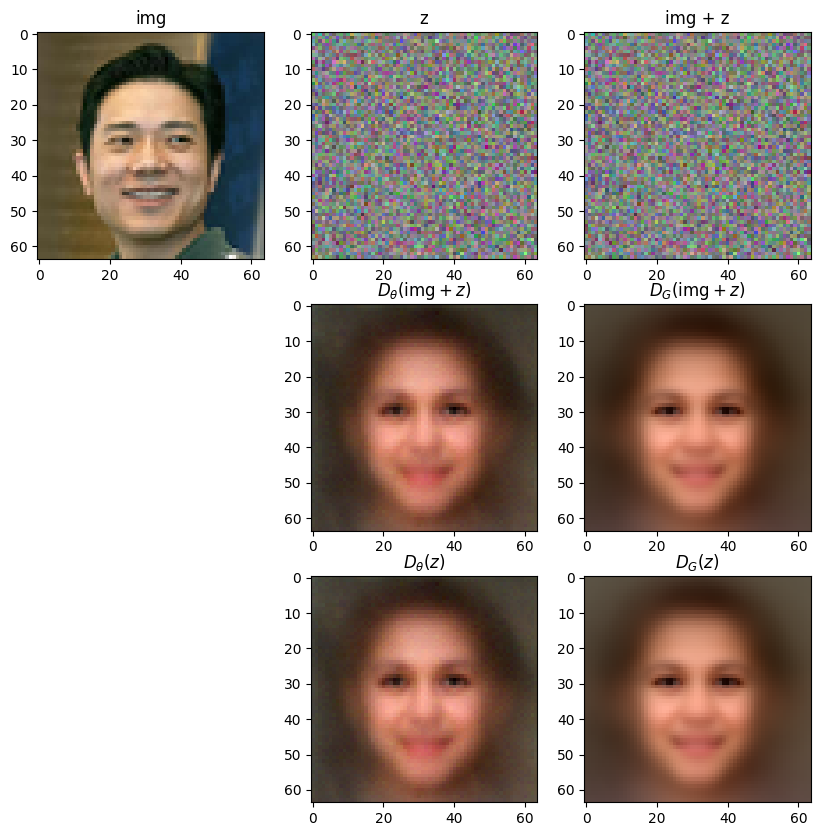

idx: 1


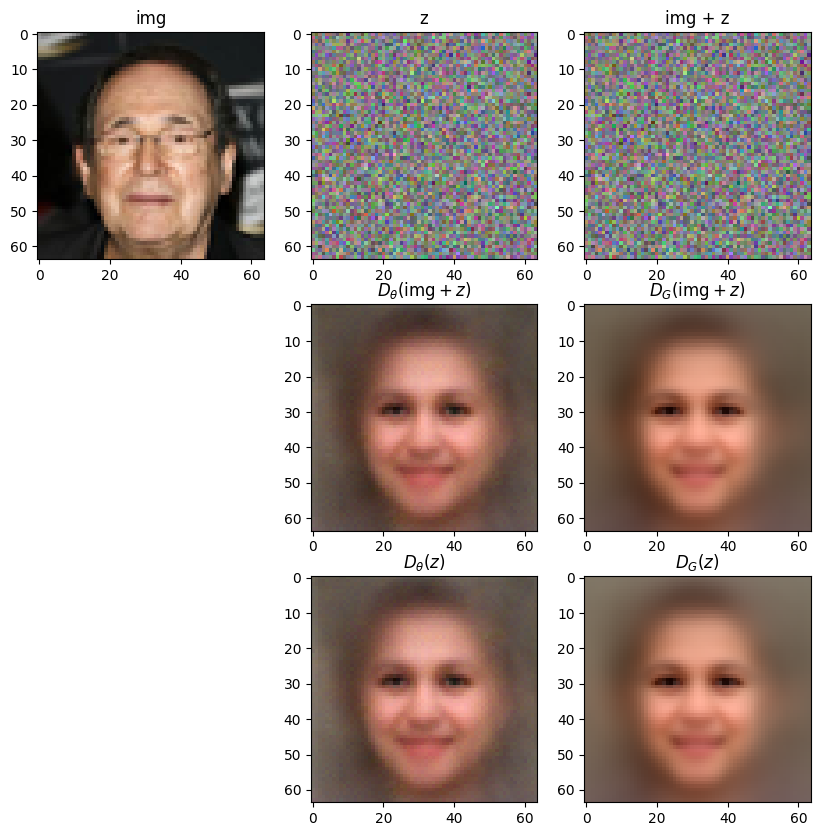

idx: 2


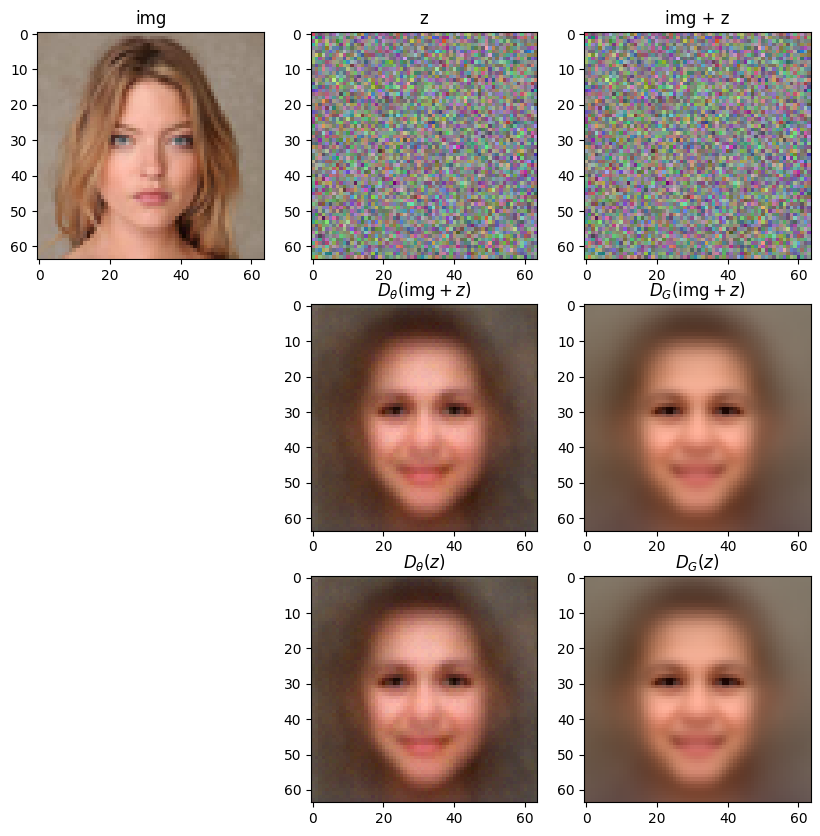

idx: 3


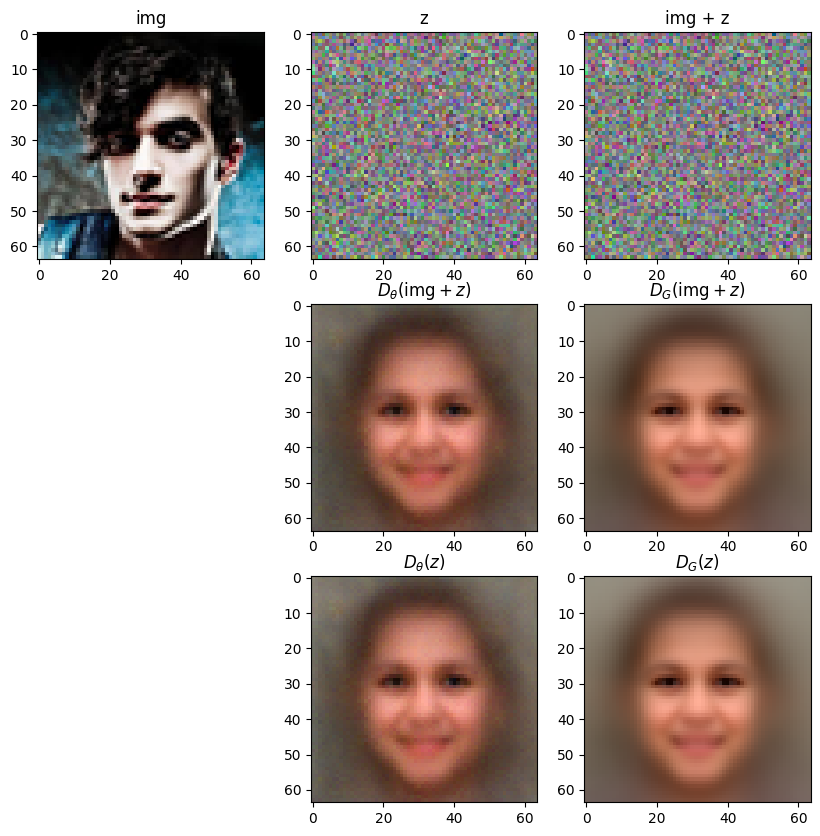

idx: 4


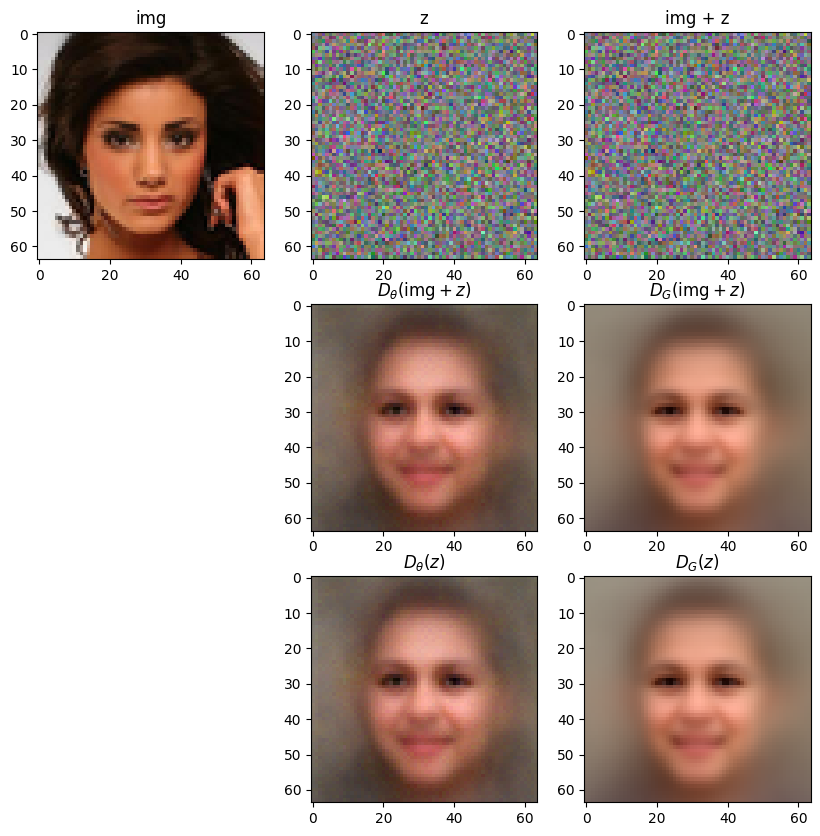

idx: 5


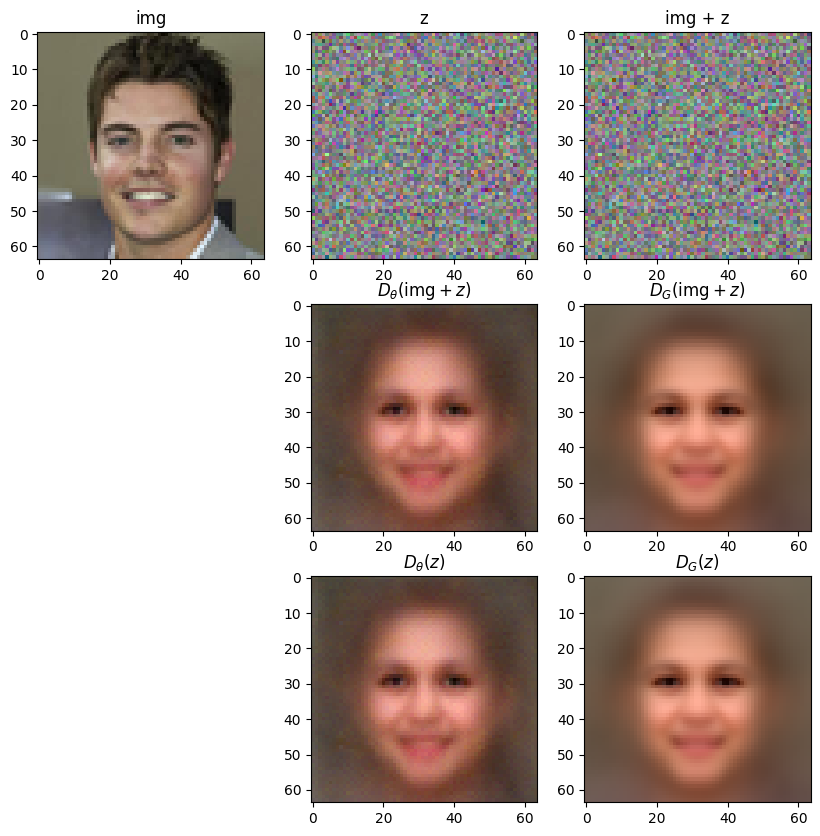

idx: 6


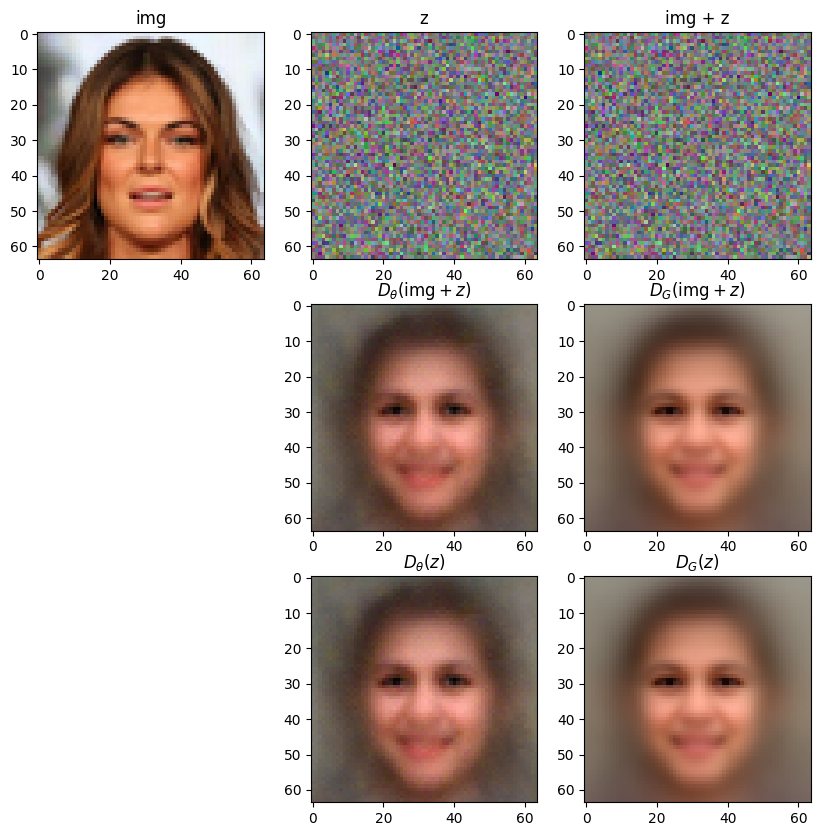

idx: 7


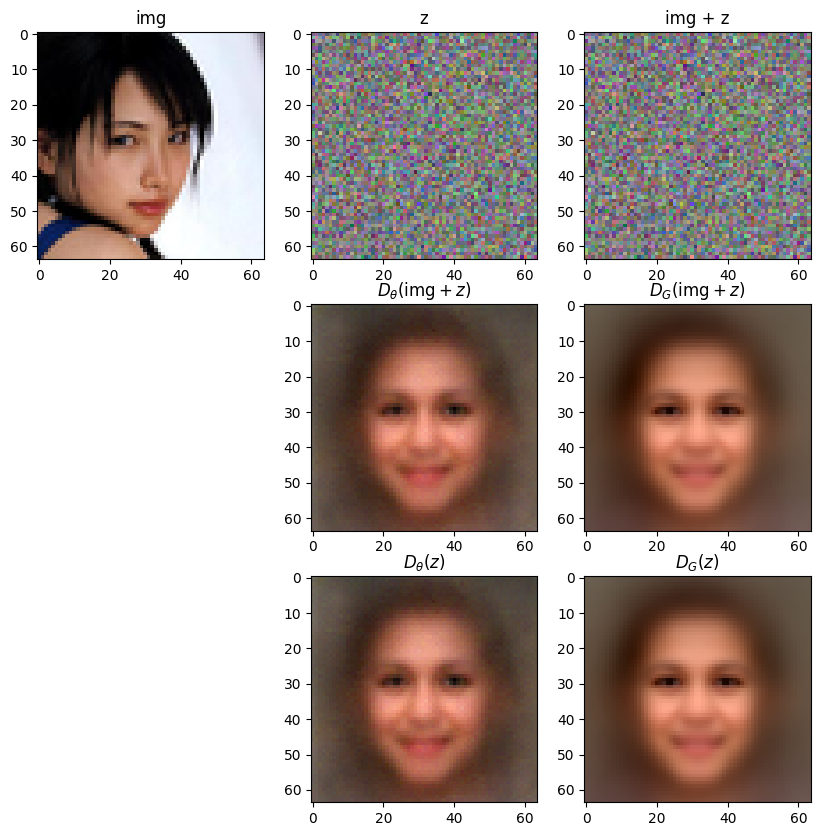

idx: 8


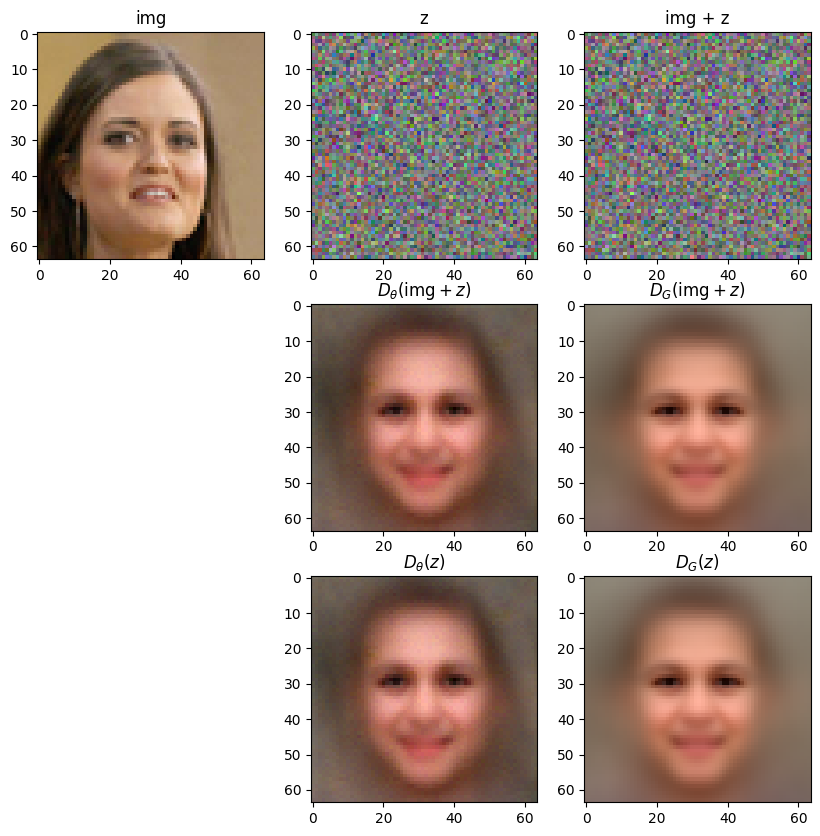

idx: 9


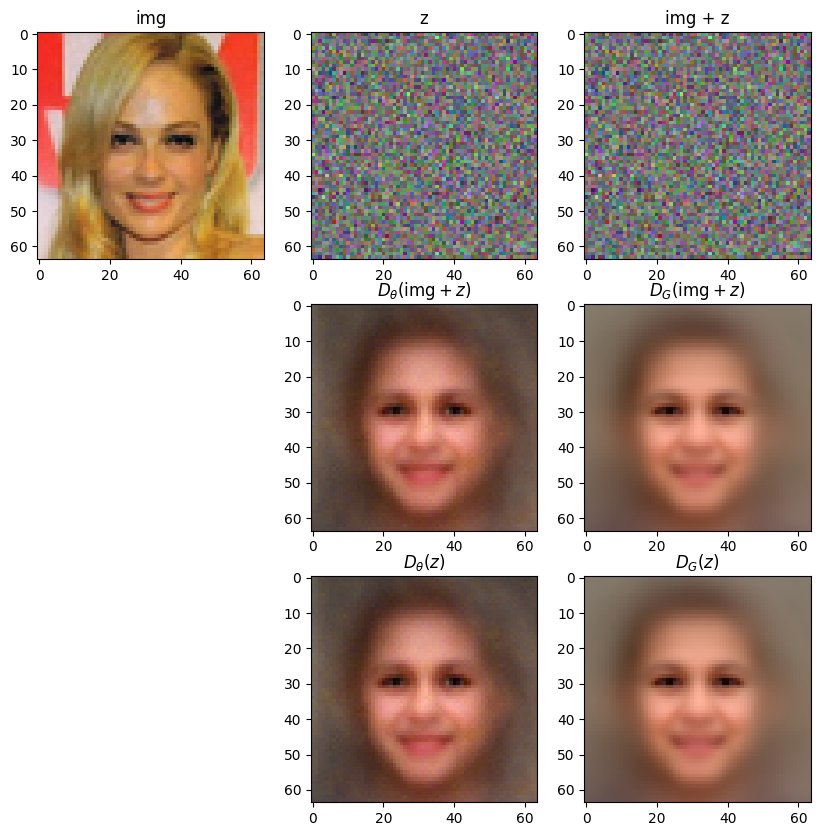

In [39]:
num_img = 10
sigma = 80.0
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 42

idx: 0


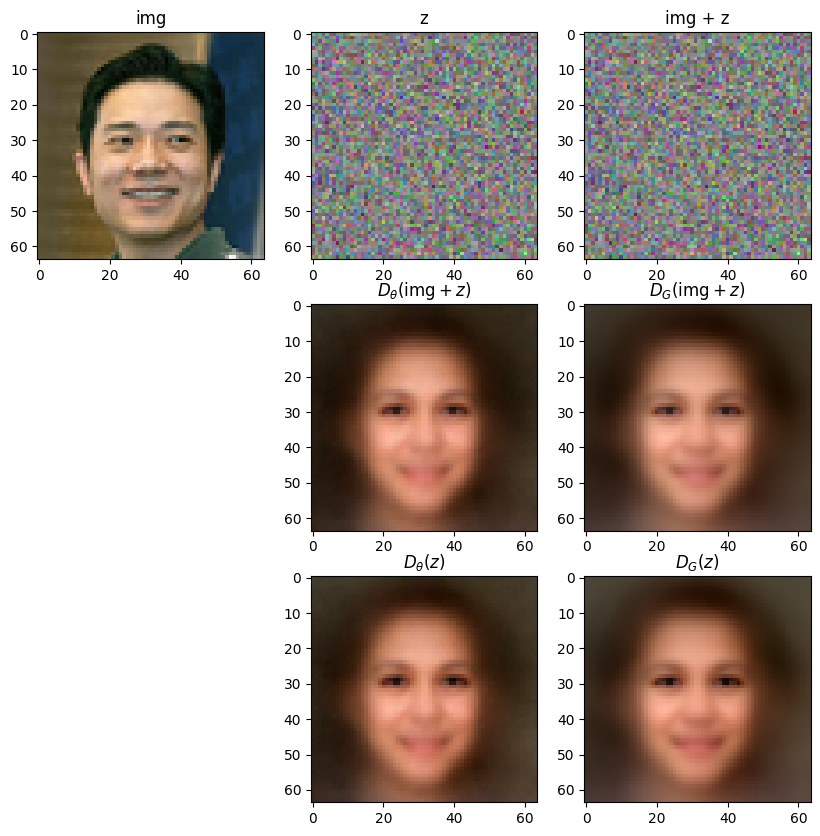

idx: 1


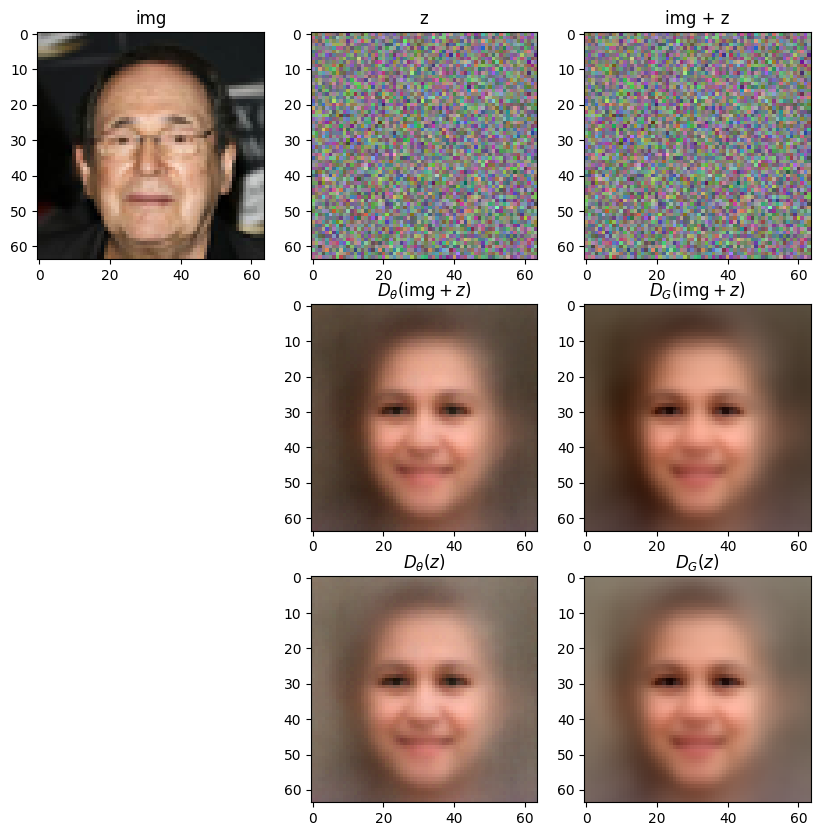

idx: 2


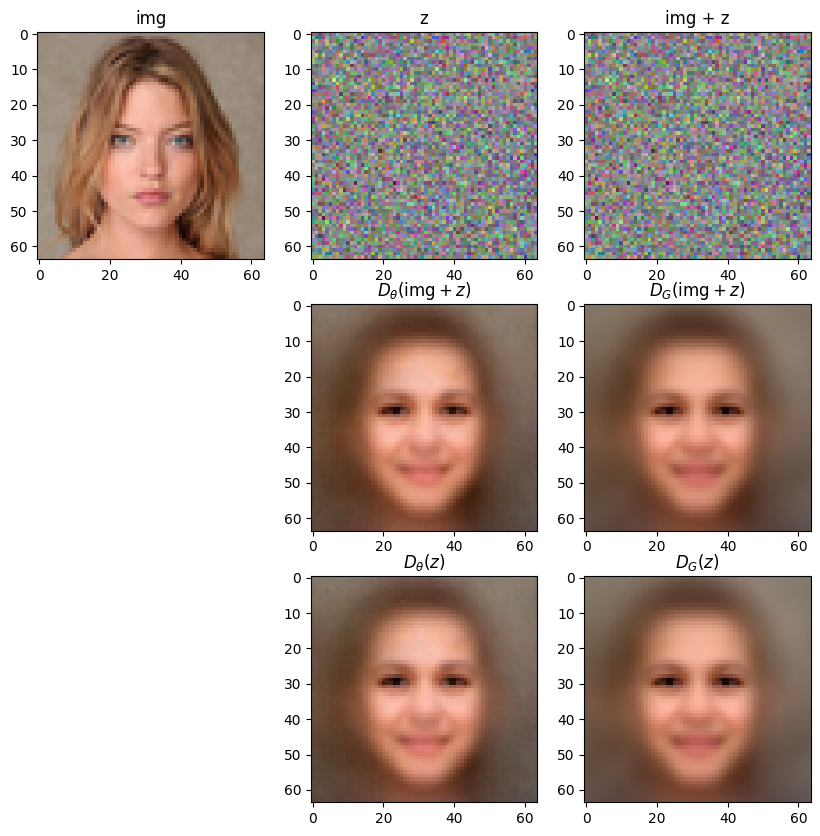

idx: 3


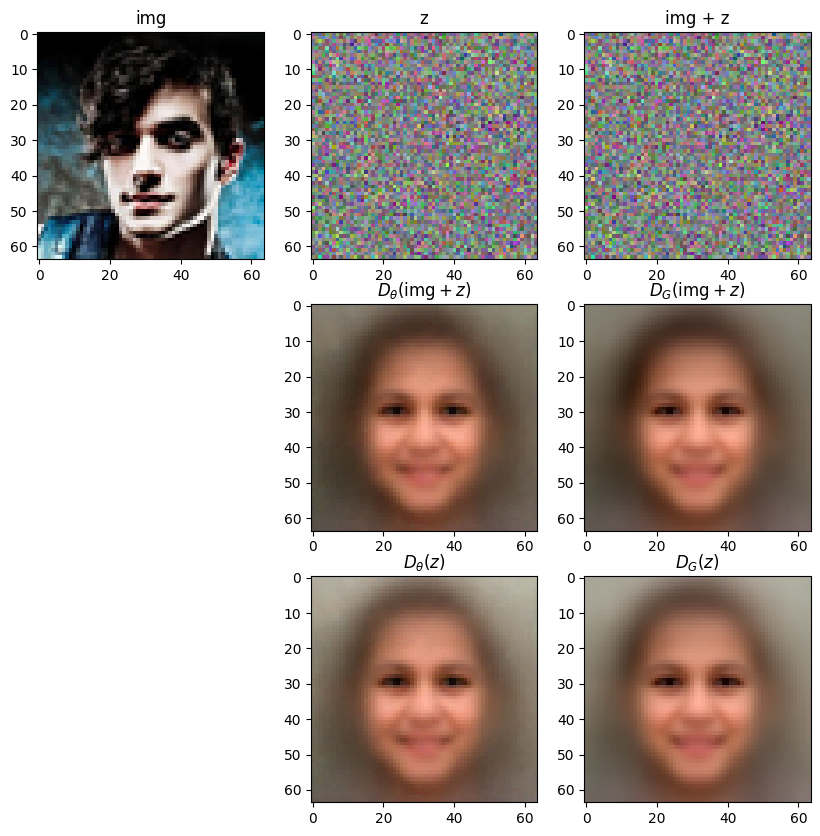

idx: 4


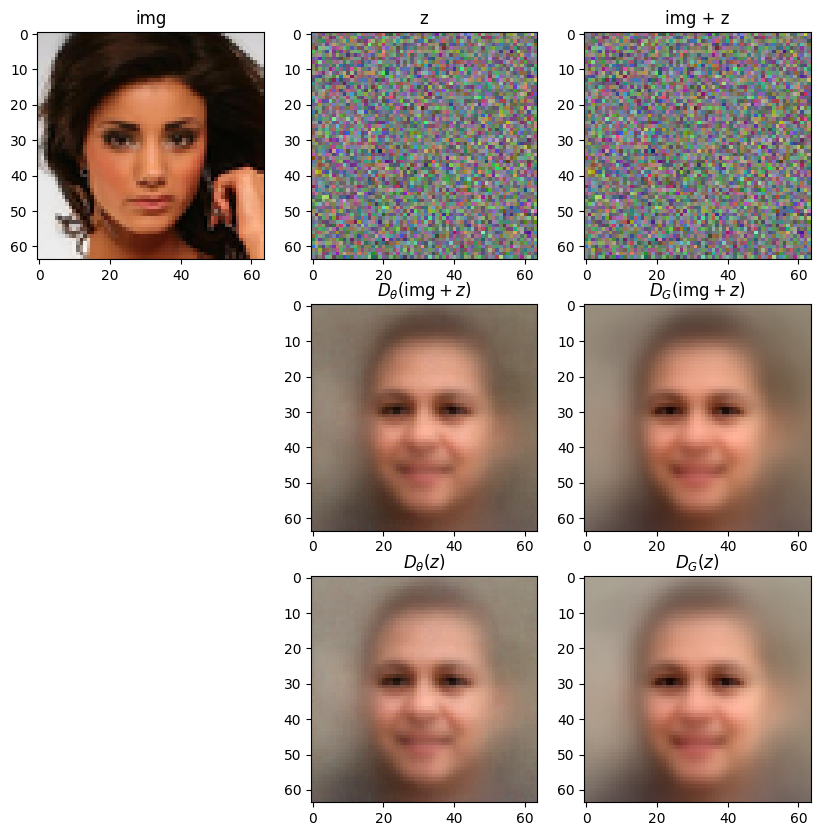

idx: 5


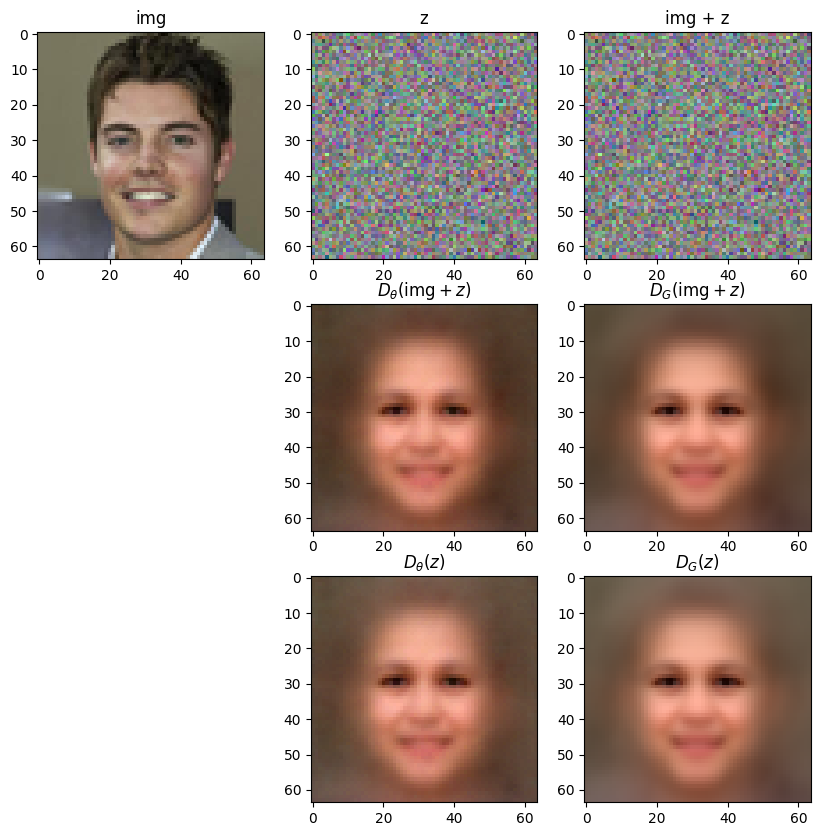

idx: 6


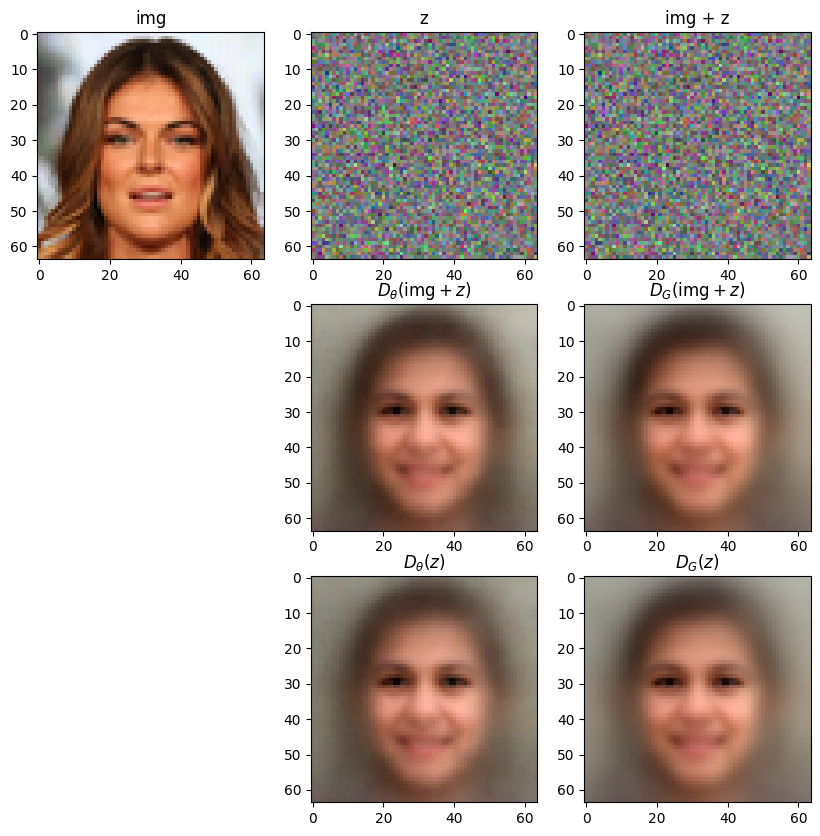

idx: 7


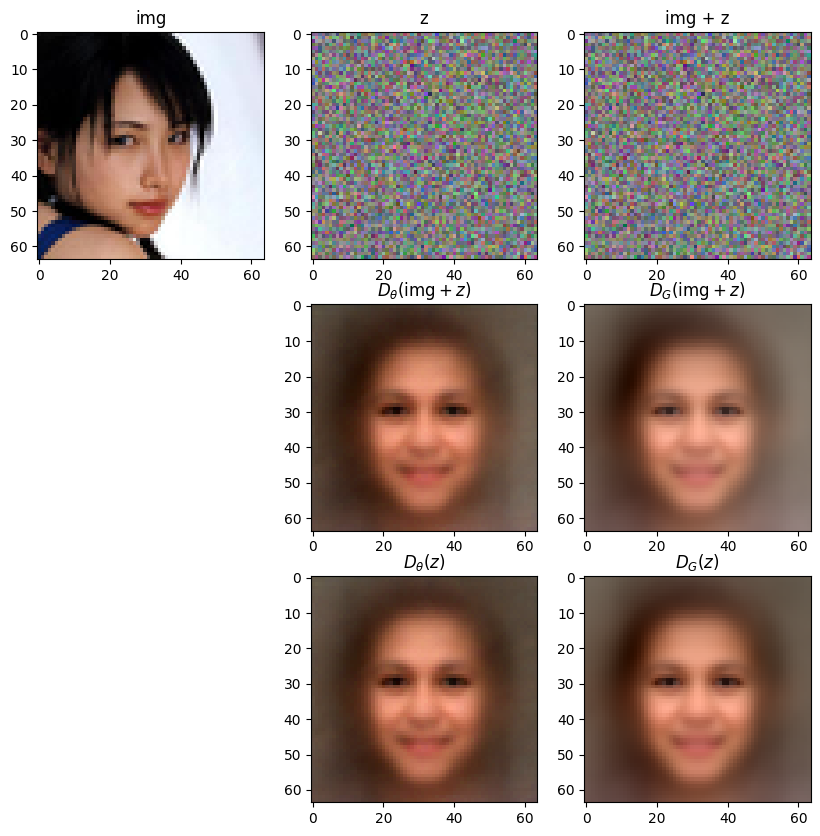

idx: 8


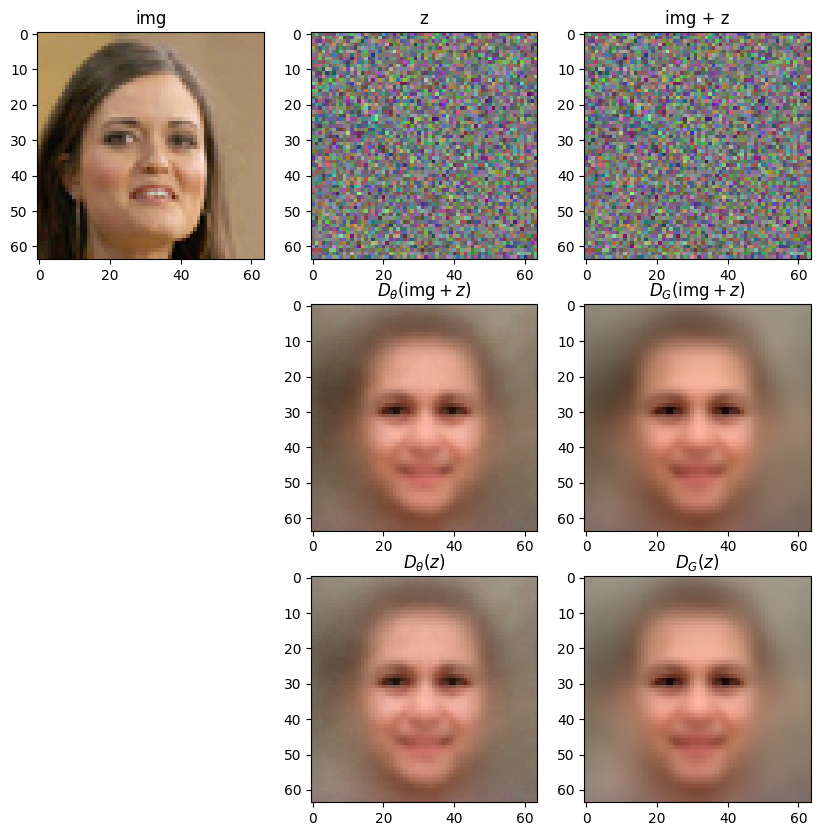

idx: 9


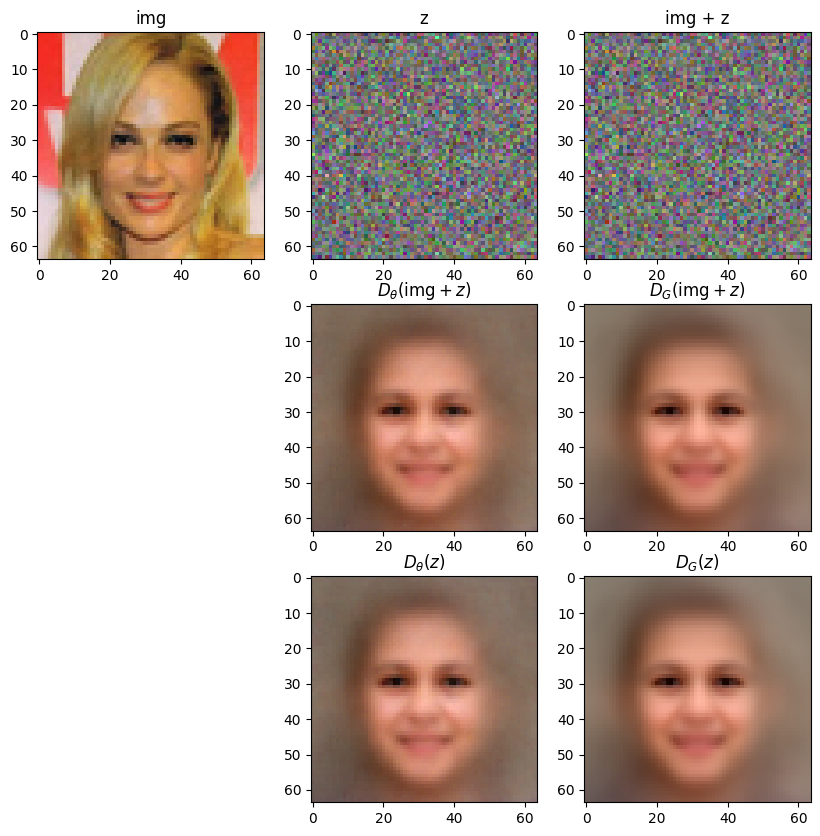

In [40]:
num_img = 10
sigma = 42.415189318512674
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 21

idx: 0


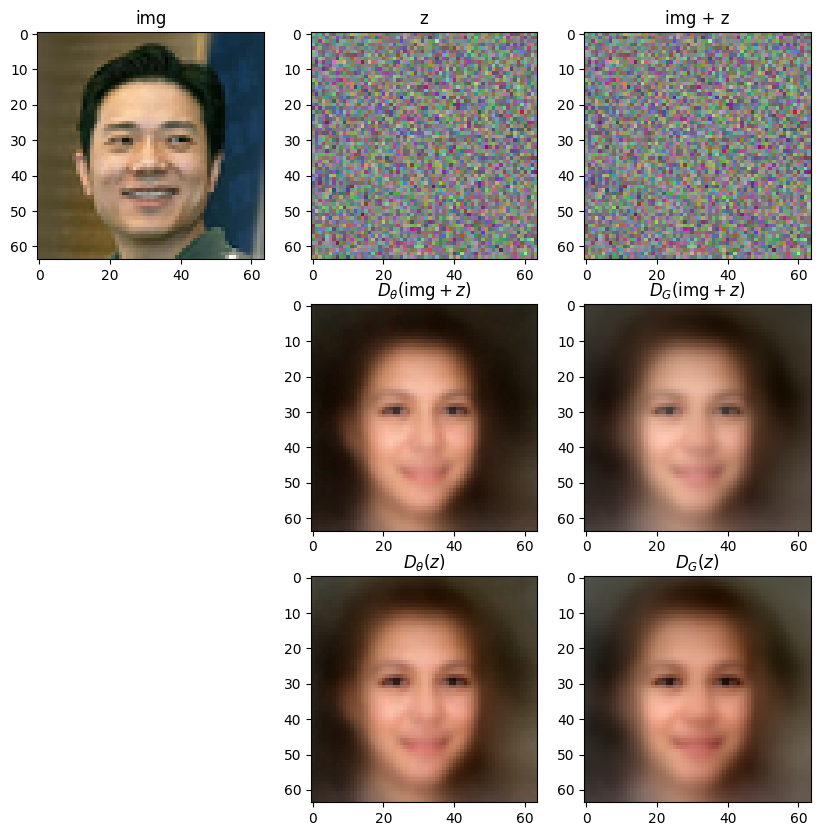

idx: 1


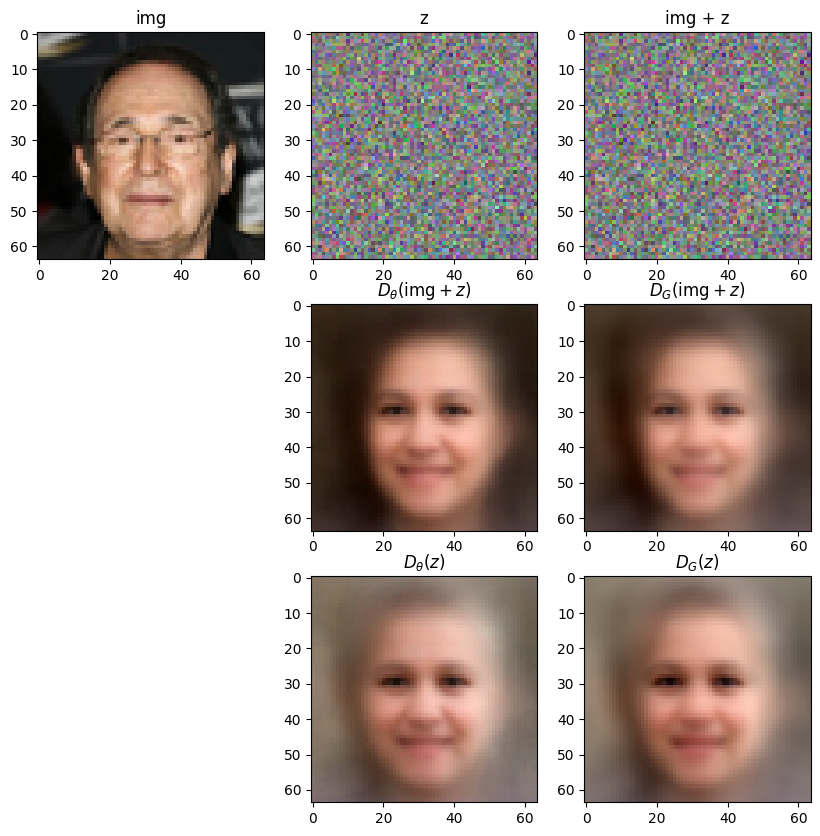

idx: 2


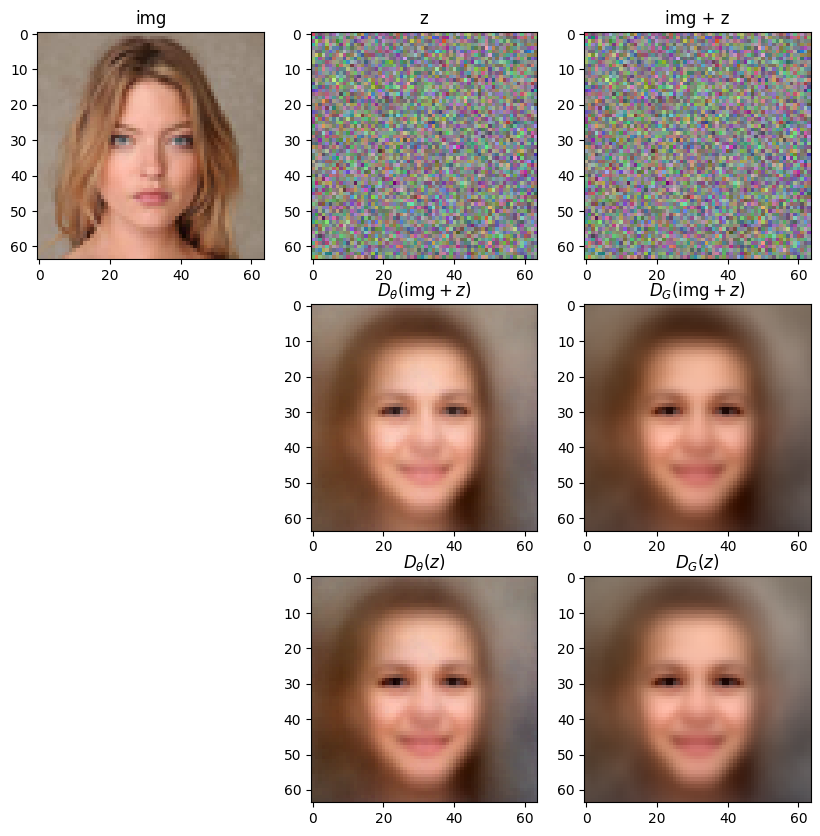

idx: 3


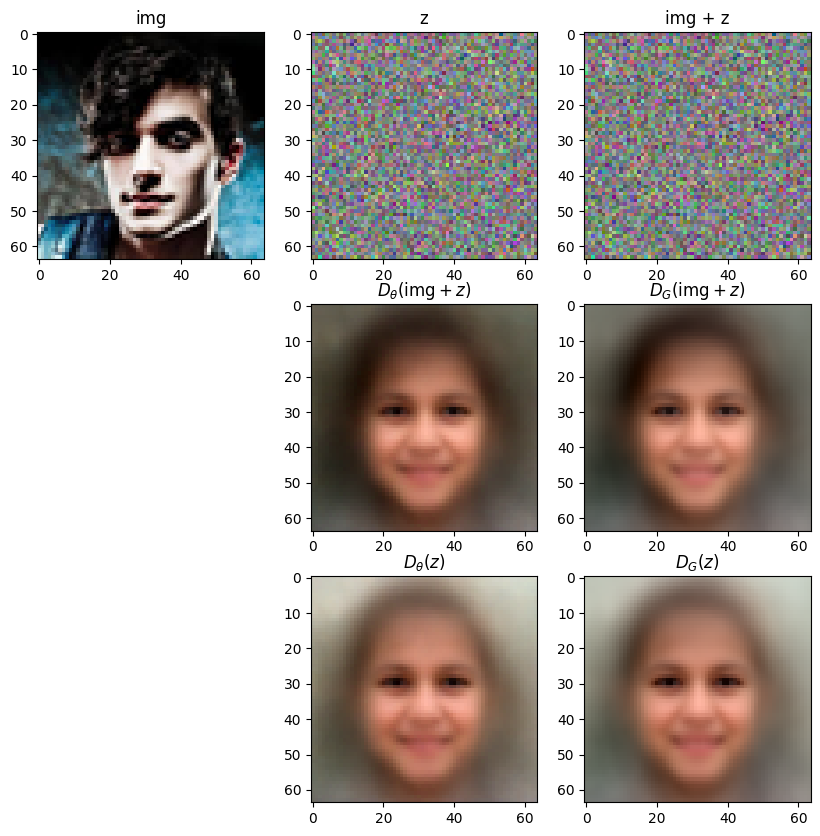

idx: 4


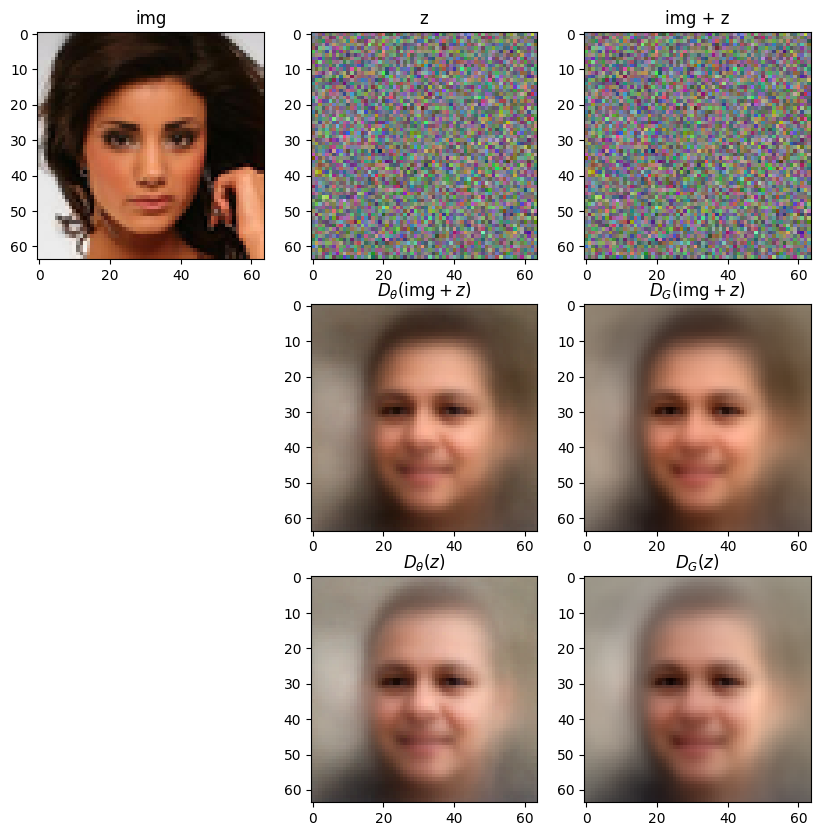

idx: 5


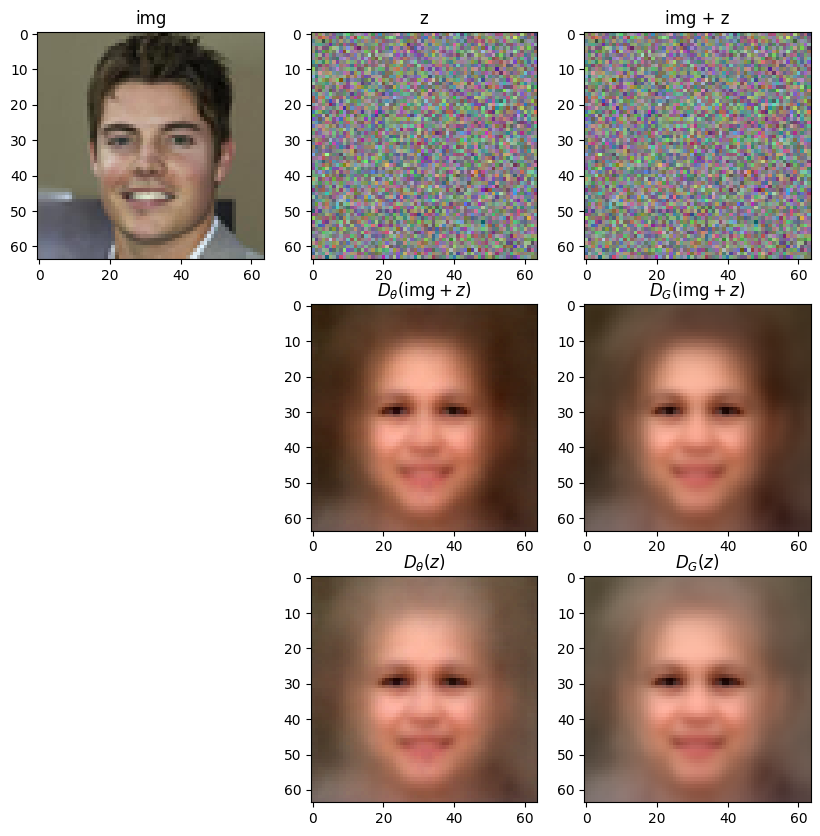

idx: 6


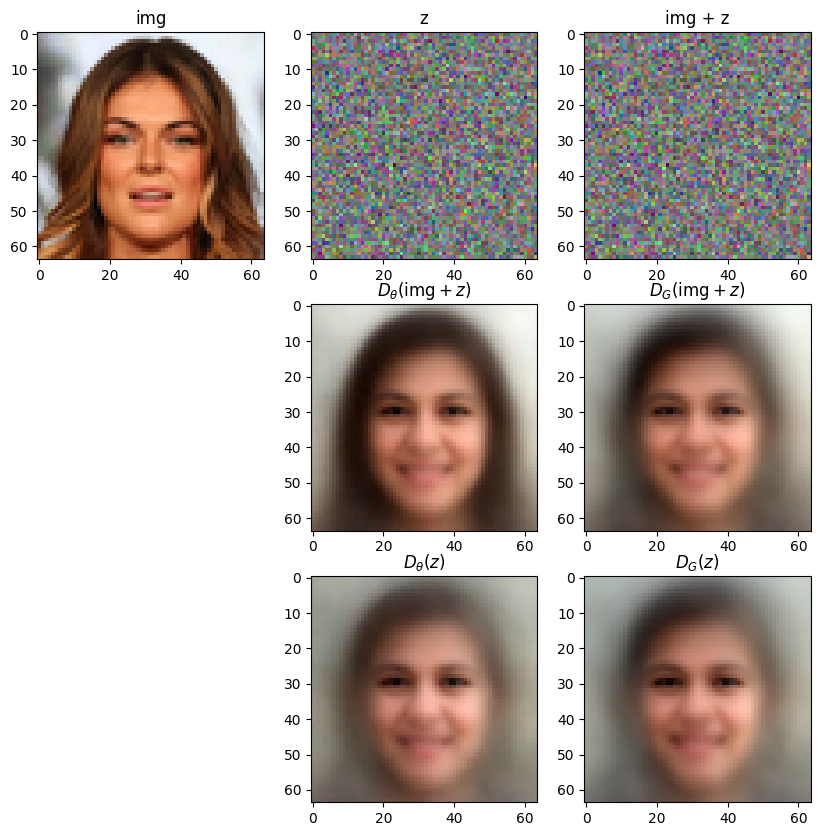

idx: 7


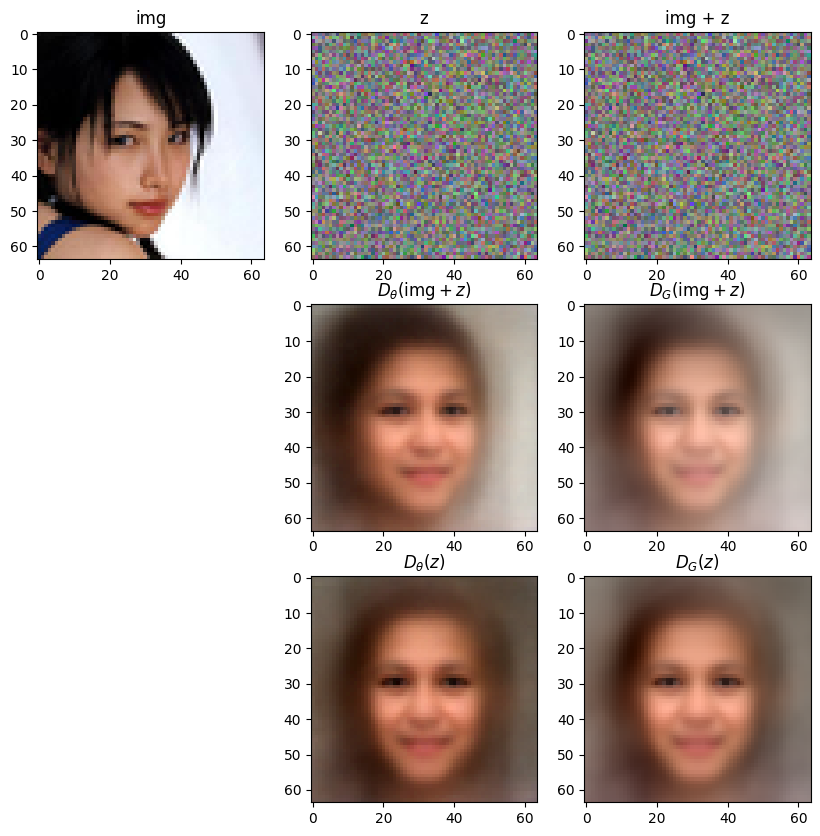

idx: 8


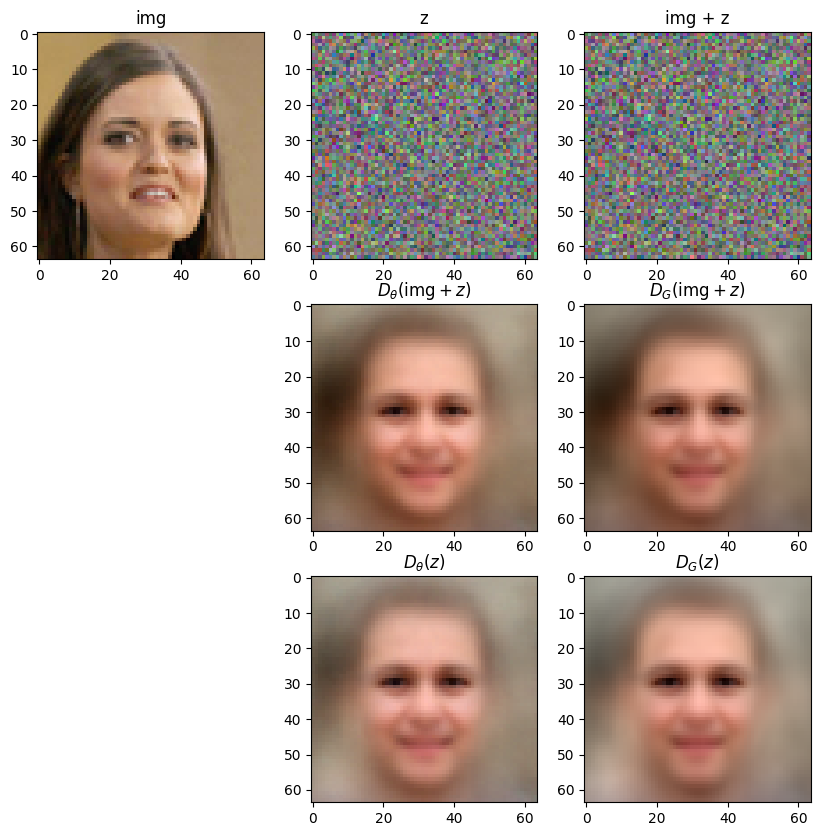

idx: 9


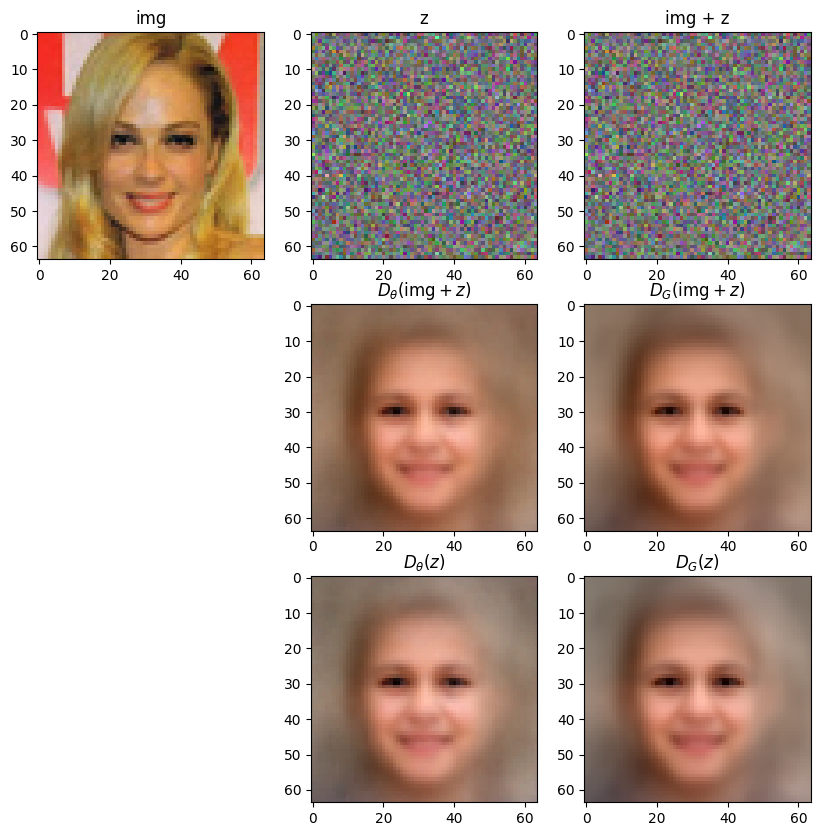

In [41]:
num_img = 10
sigma = 21.10867673619376
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### sigma = 9.7

idx: 0


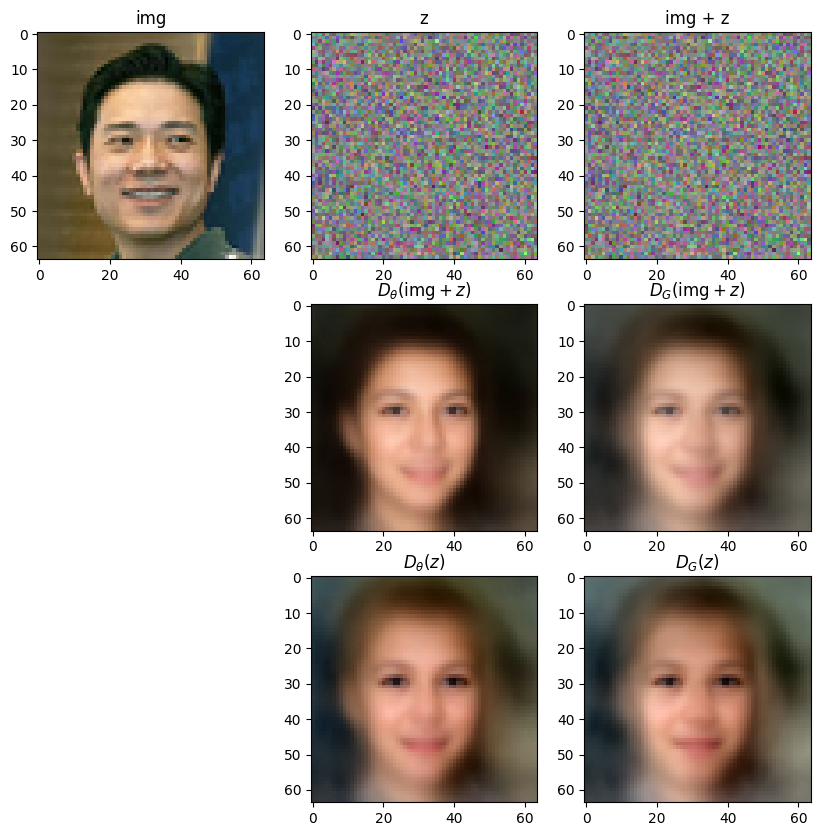

idx: 1


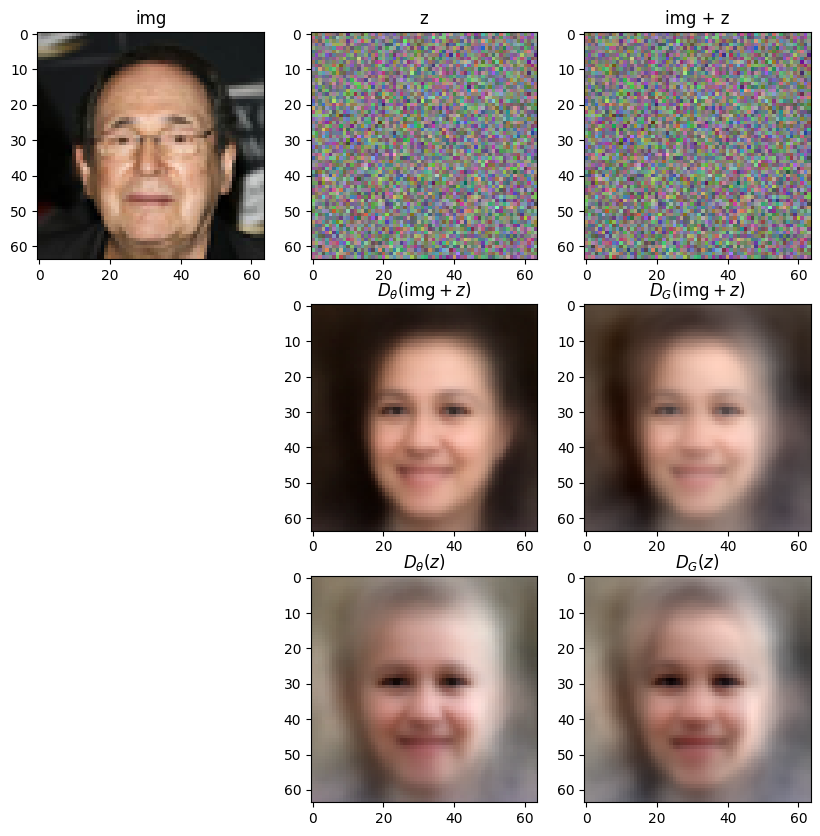

idx: 2


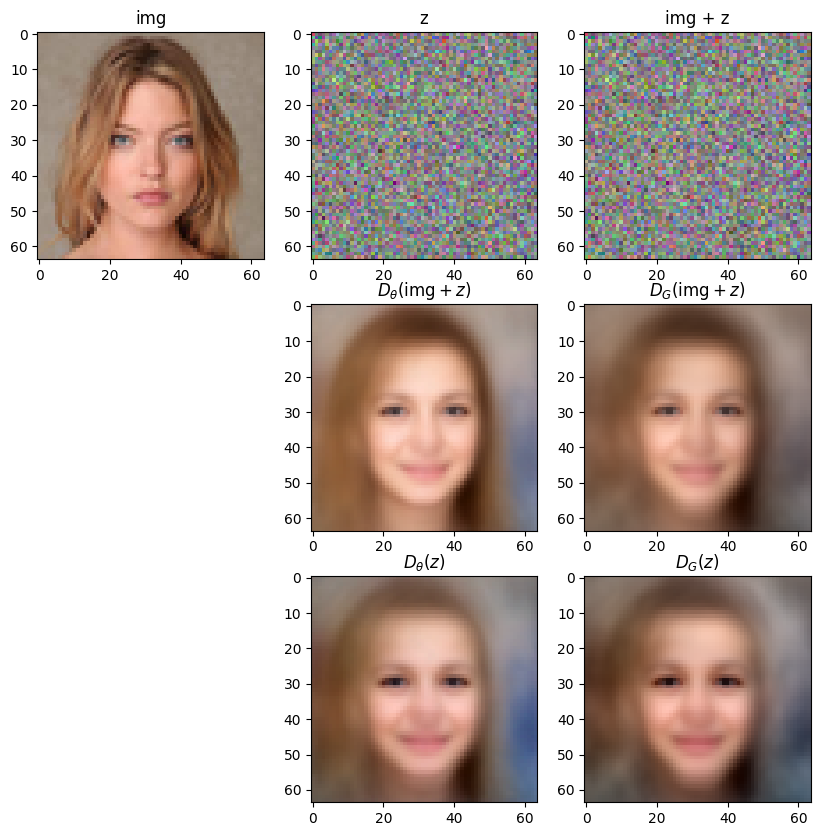

idx: 3


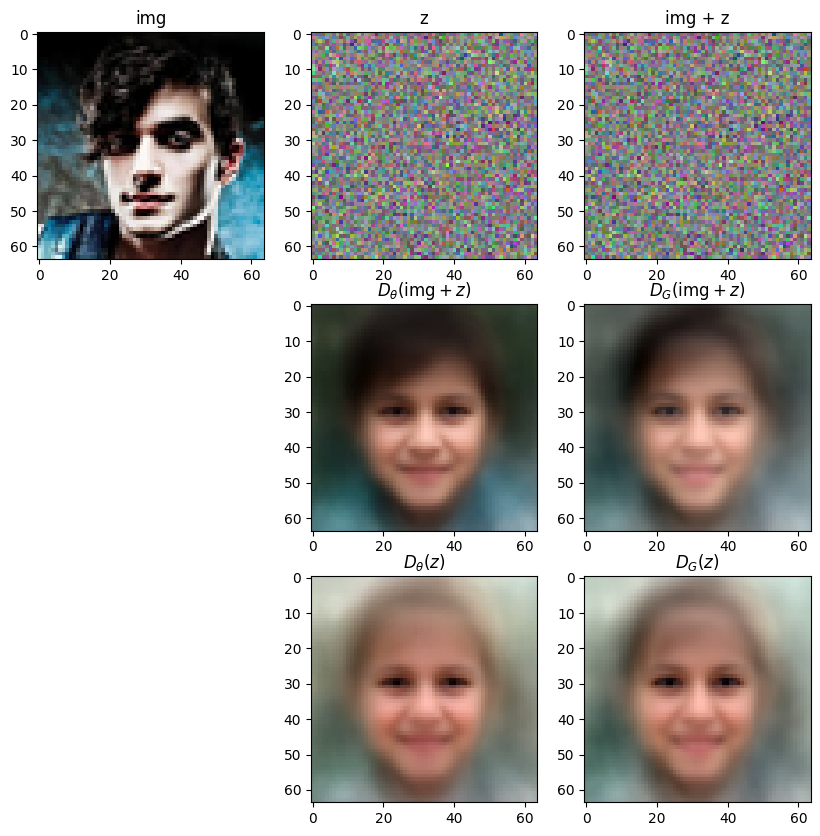

idx: 4


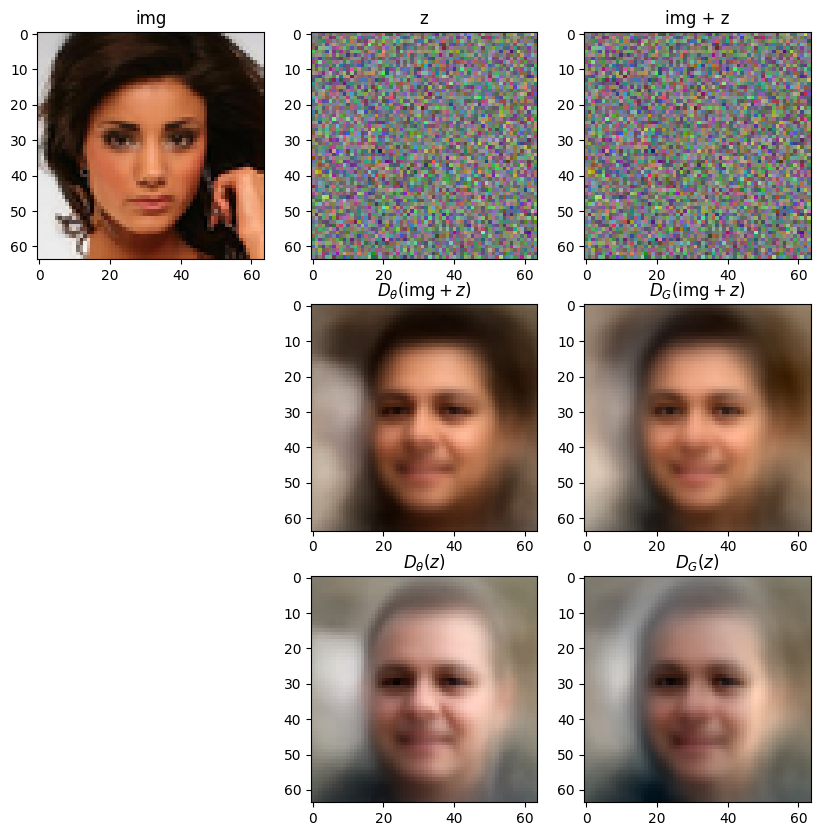

idx: 5


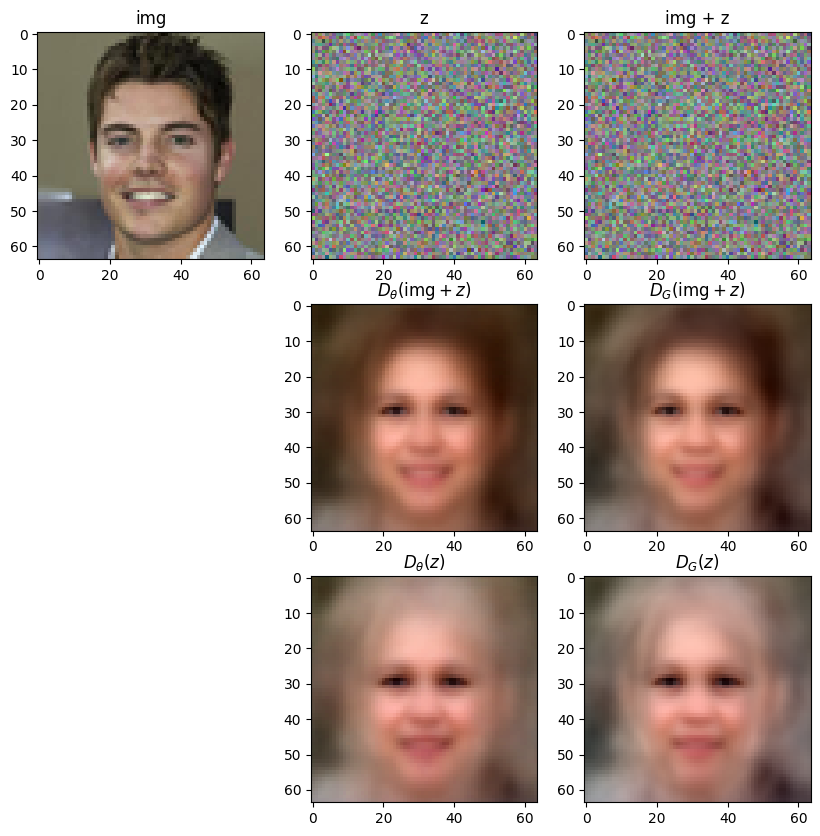

idx: 6


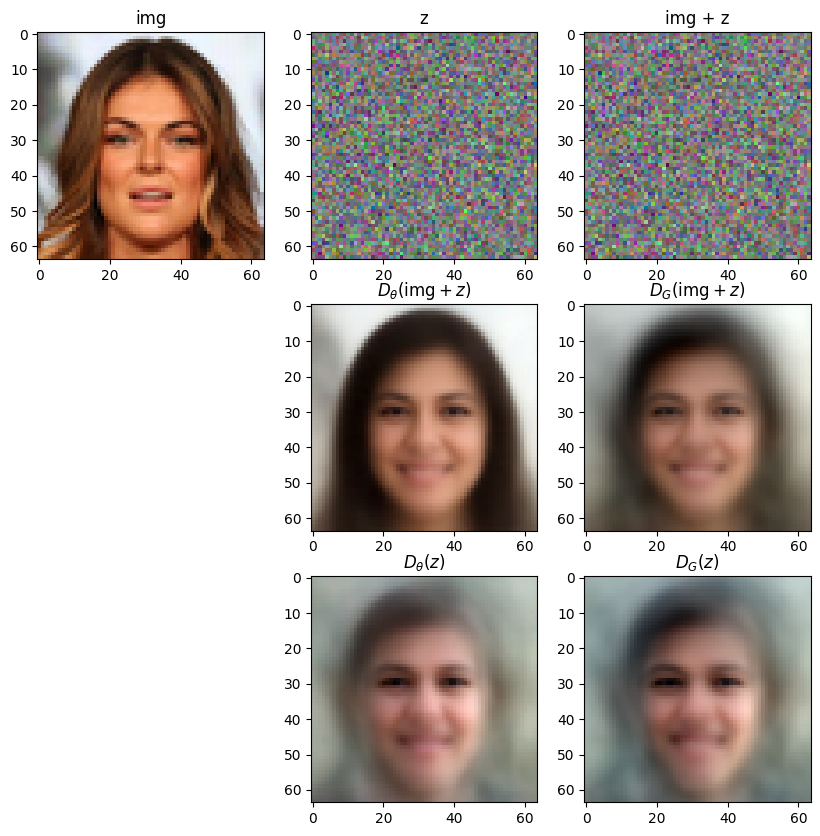

idx: 7


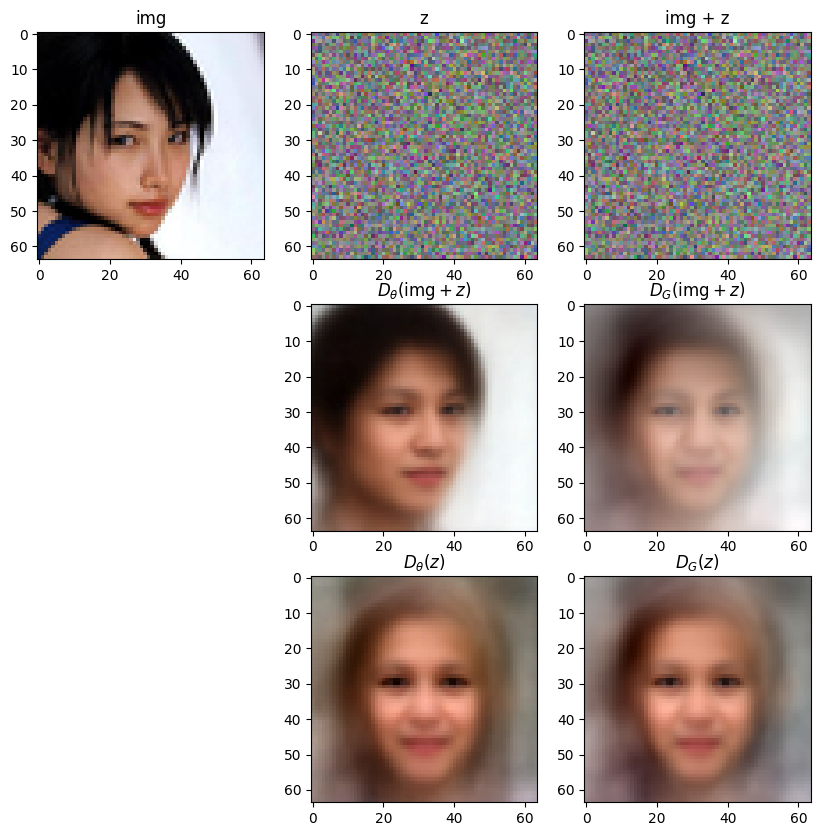

idx: 8


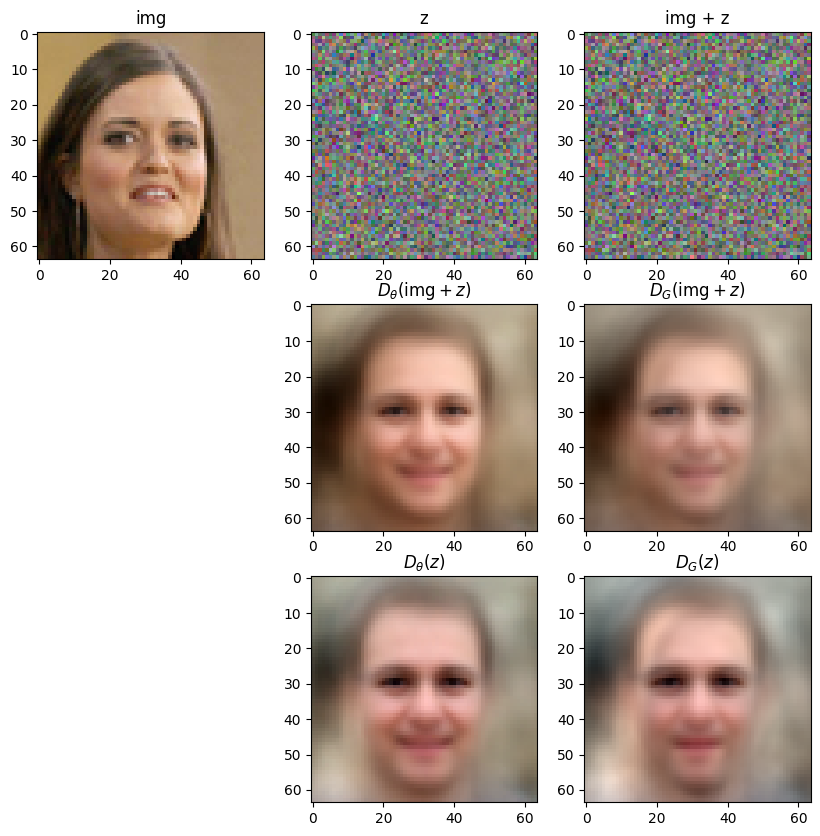

idx: 9


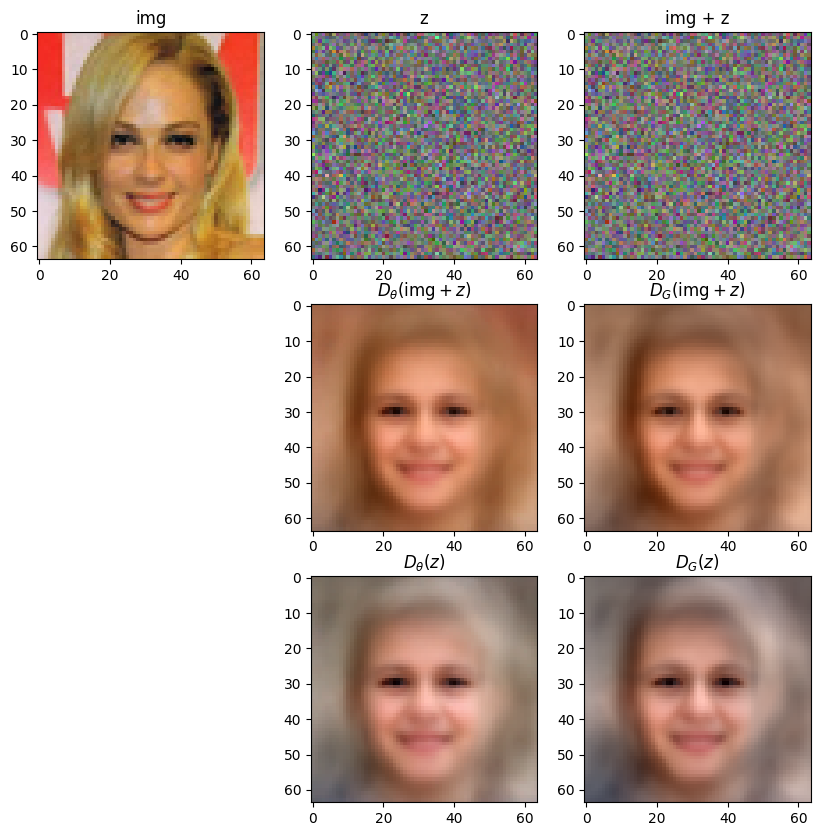

In [42]:
num_img = 10
sigma = 9.72320135526013
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### From the above results, we see that for a wide range of noise variance levels ([80, 10]), the Gaussian denoisers and the EDM denoisers produce highly similar denoising outputs whether from noisy image or pure noise. This implies that the deep network based EDM denoisers are highly linear in this regime and are approximately equivalent to the Gaussian denoisers.

### Sigma = 4

idx: 0


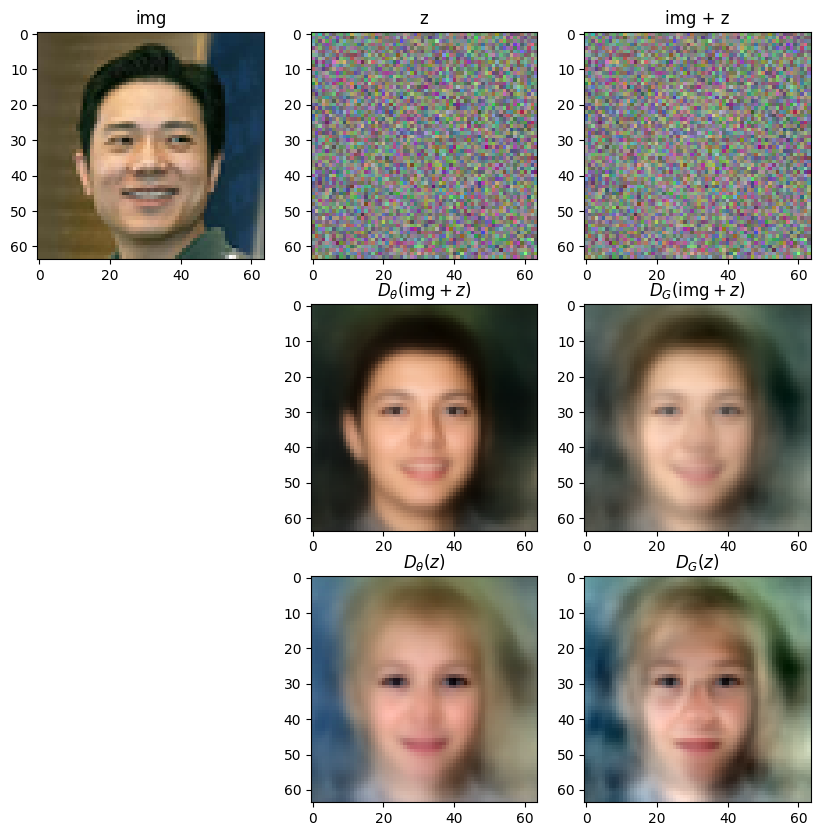

idx: 1


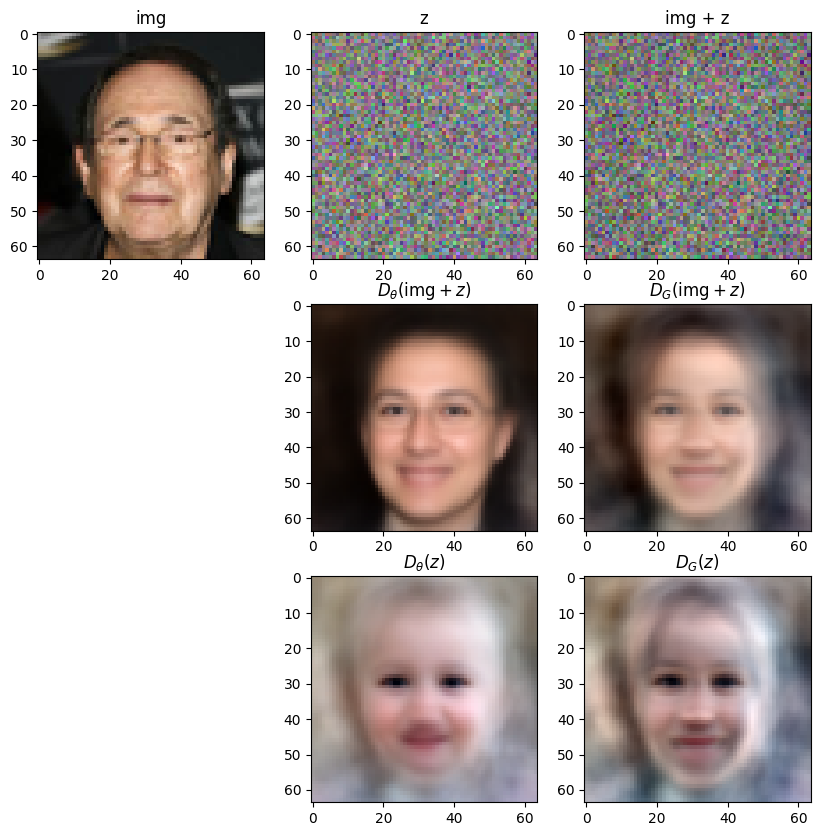

idx: 2


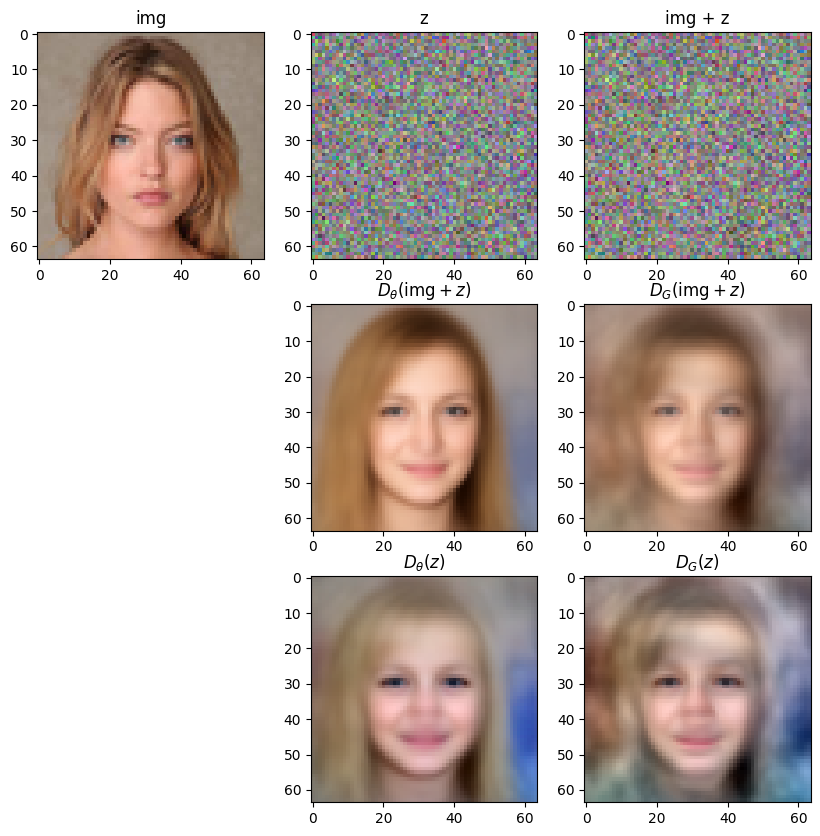

idx: 3


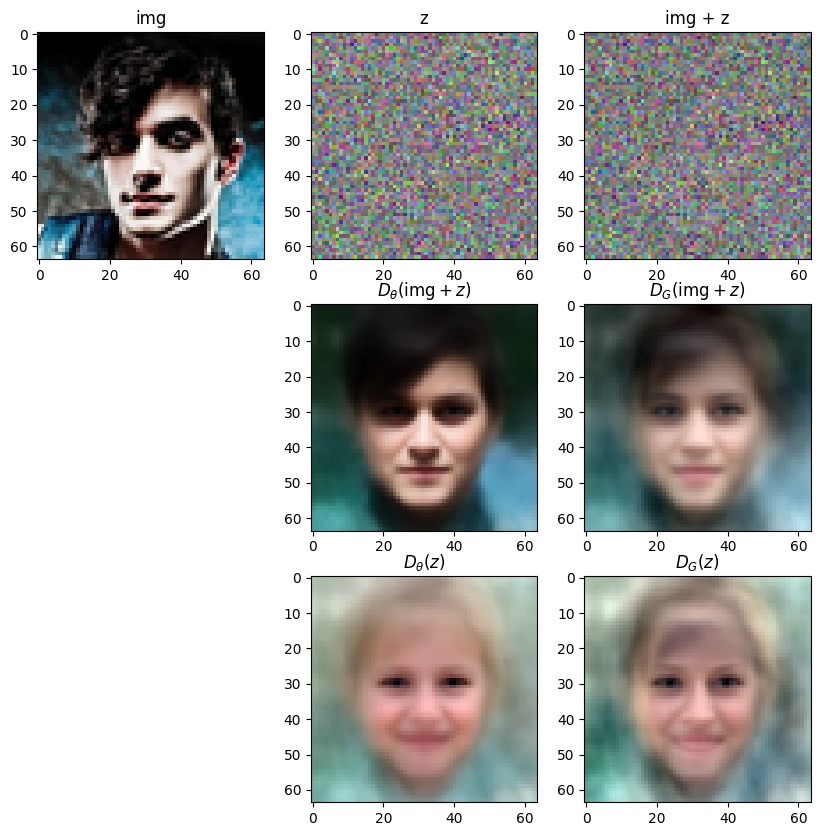

idx: 4


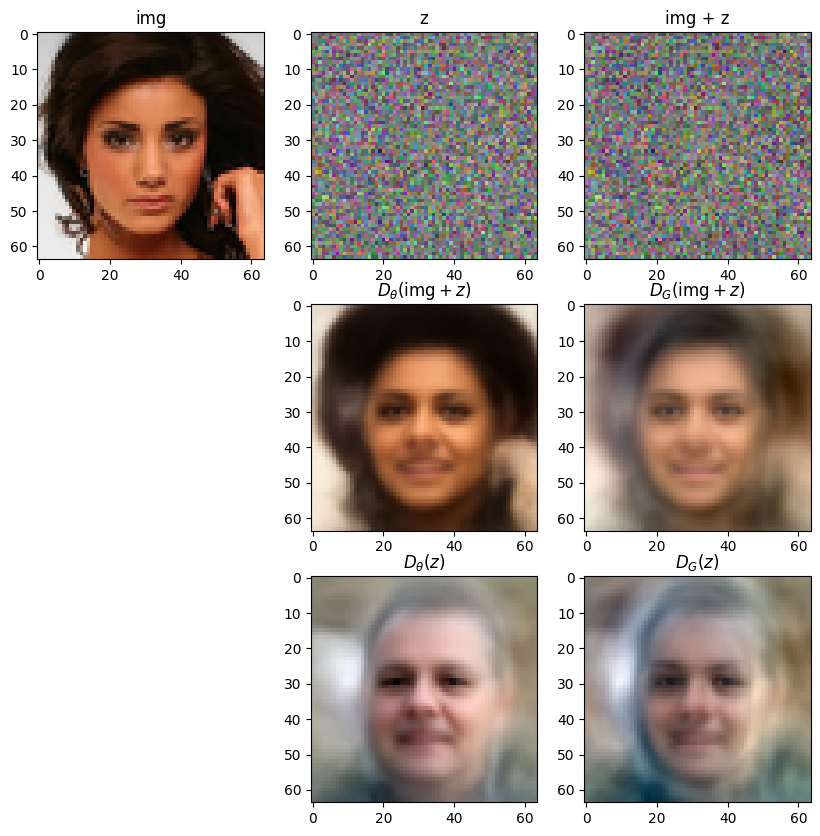

idx: 5


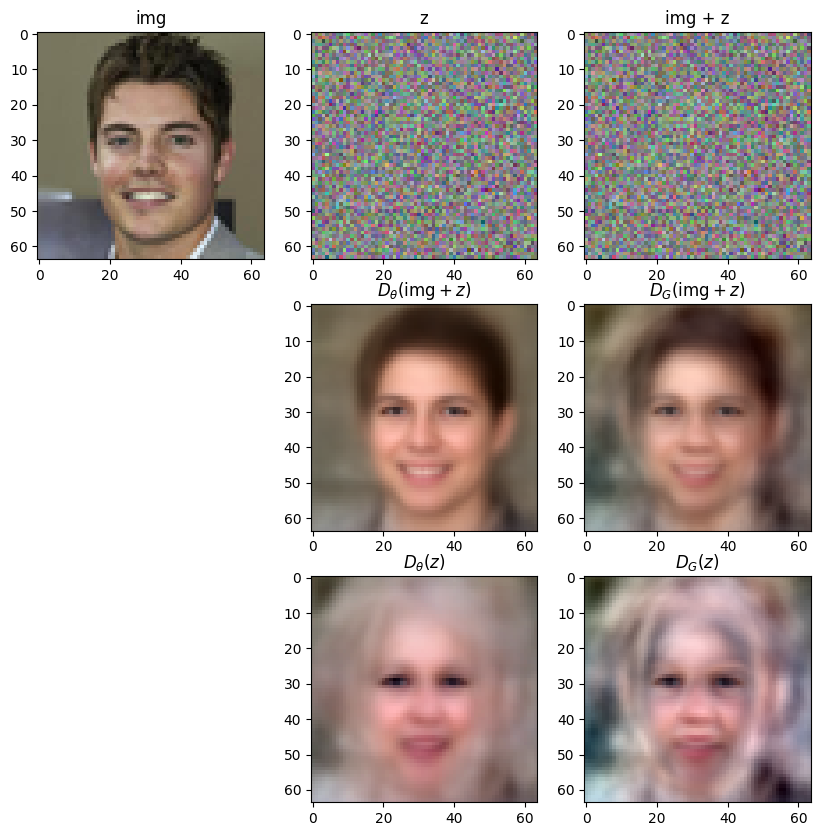

idx: 6


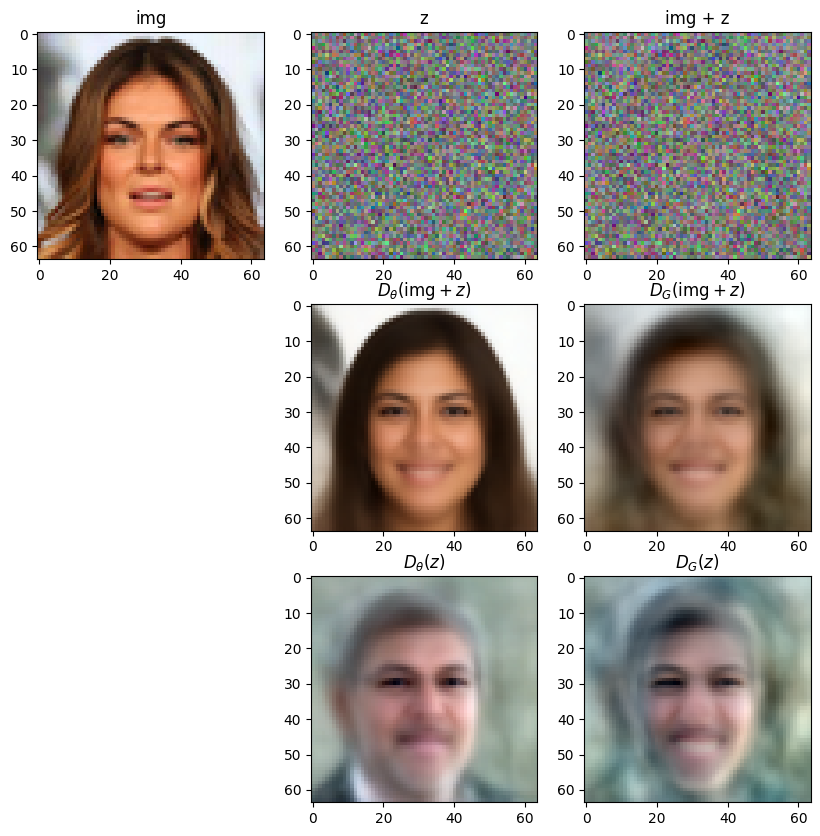

idx: 7


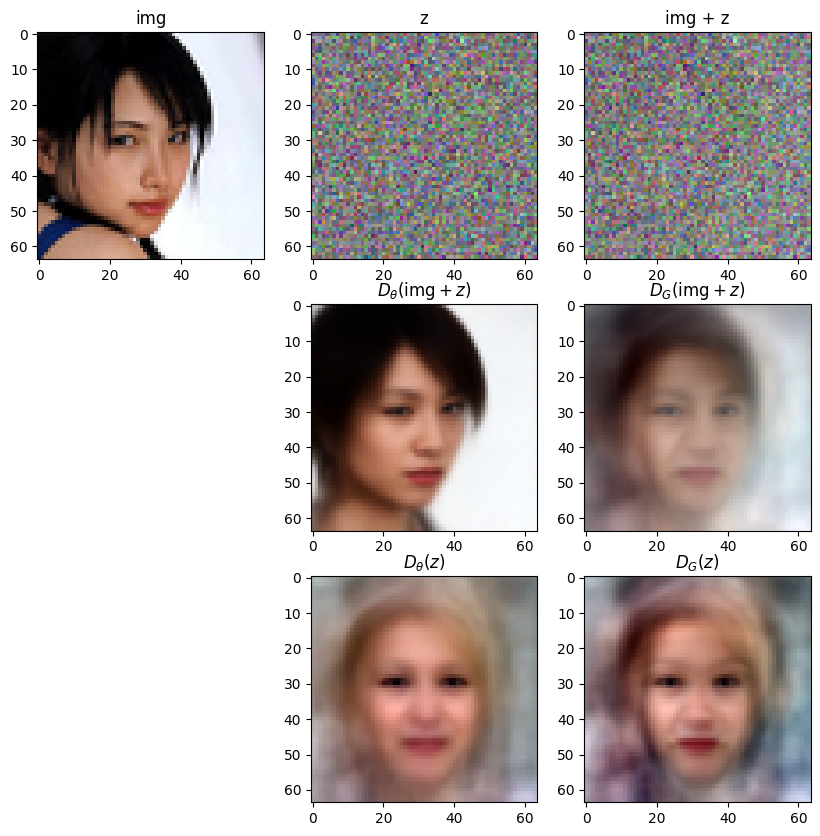

idx: 8


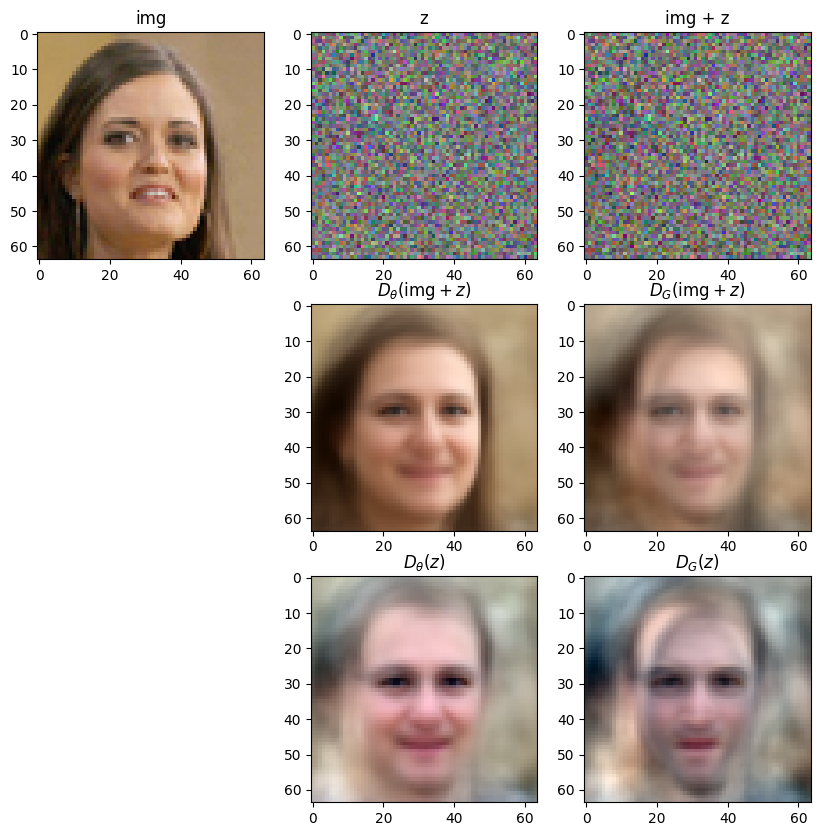

idx: 9


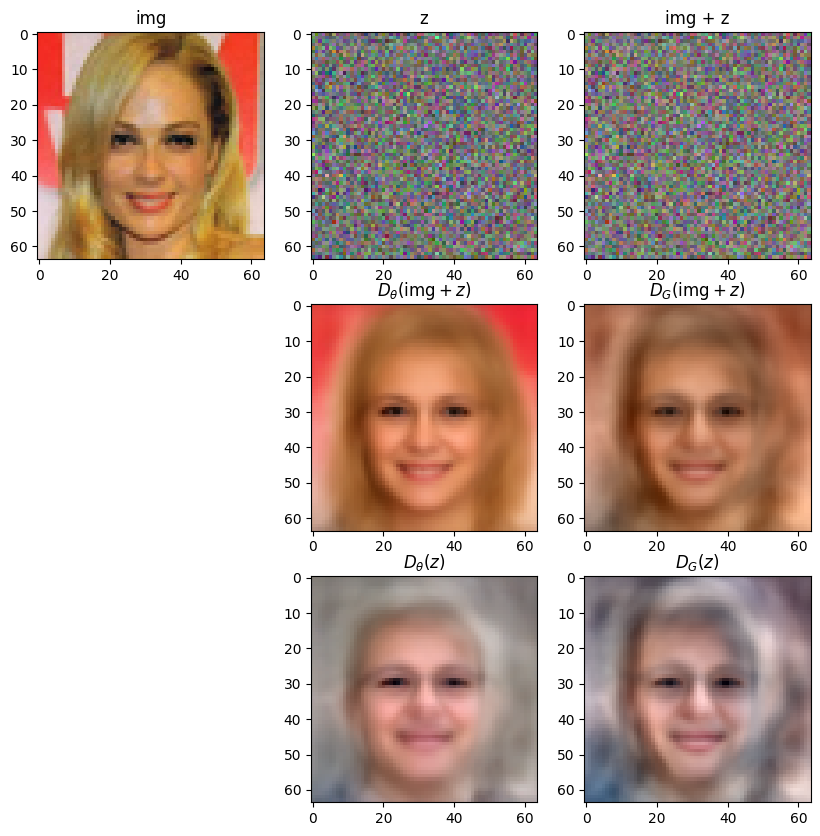

In [43]:
num_img = 10
sigma = 4.066123602953759
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 1.5

idx: 0


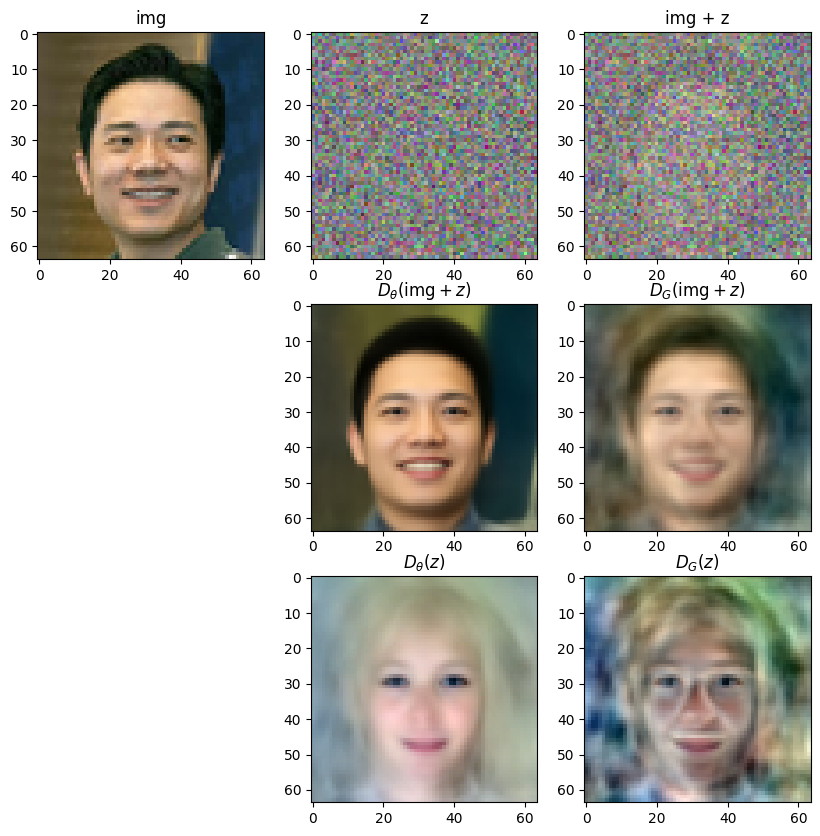

idx: 1


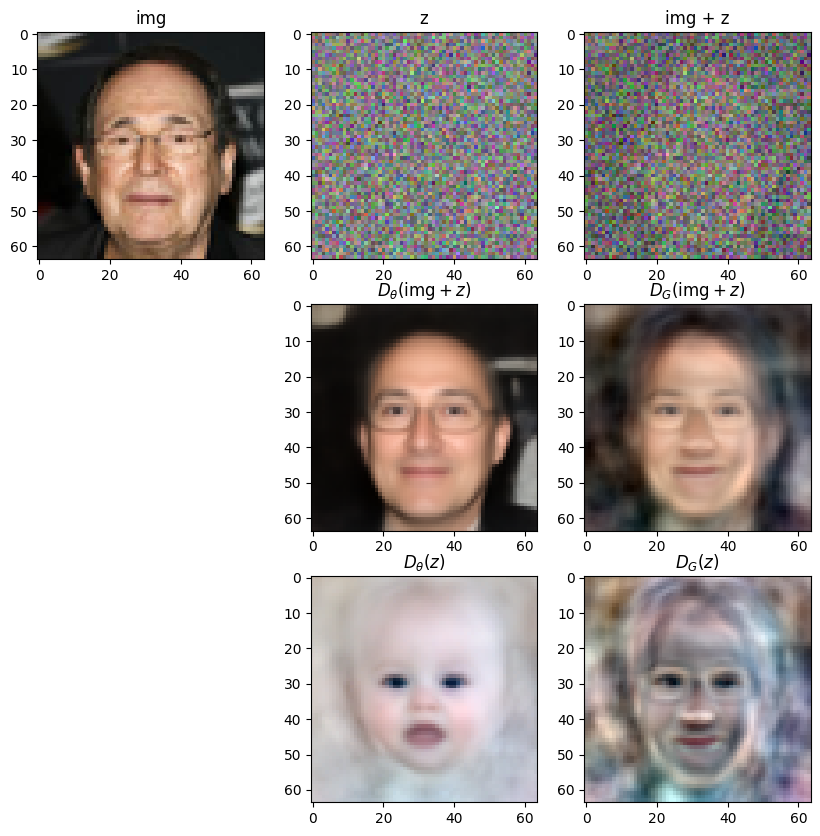

idx: 2


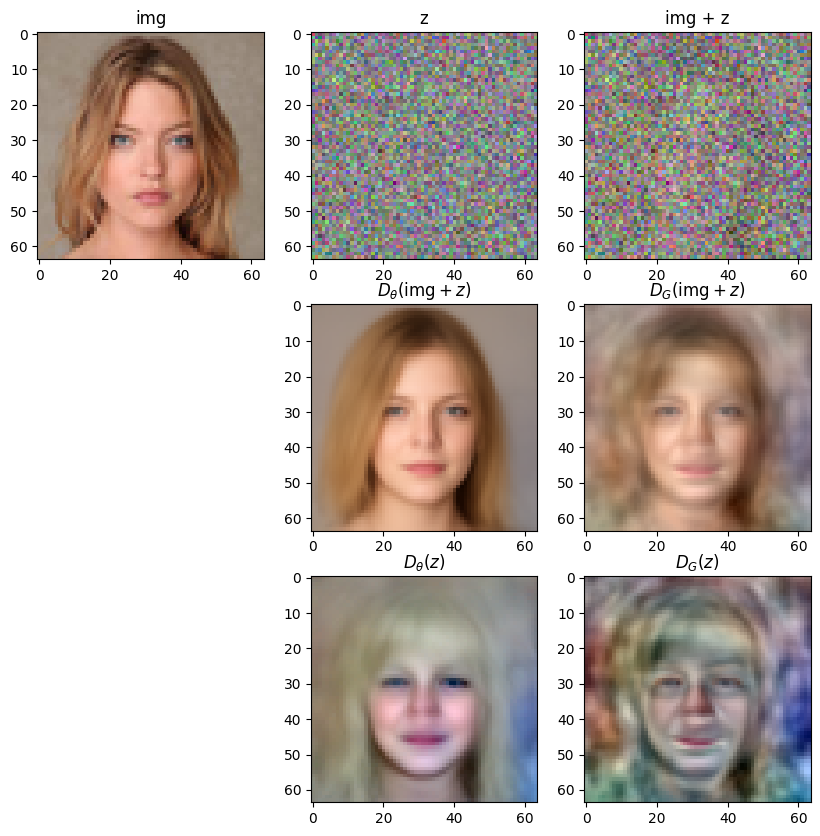

idx: 3


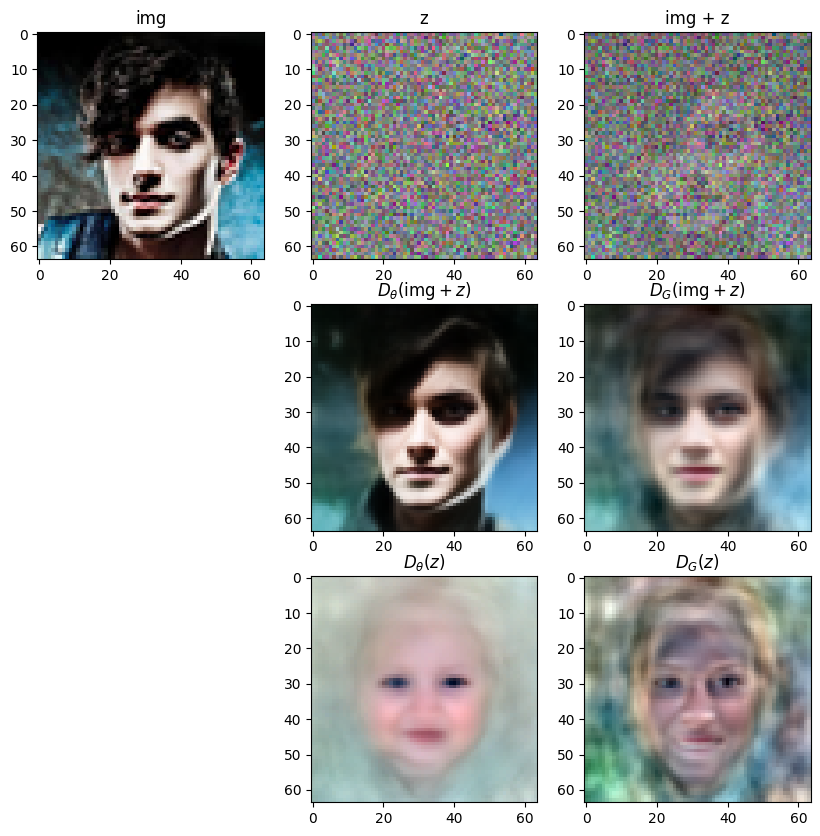

idx: 4


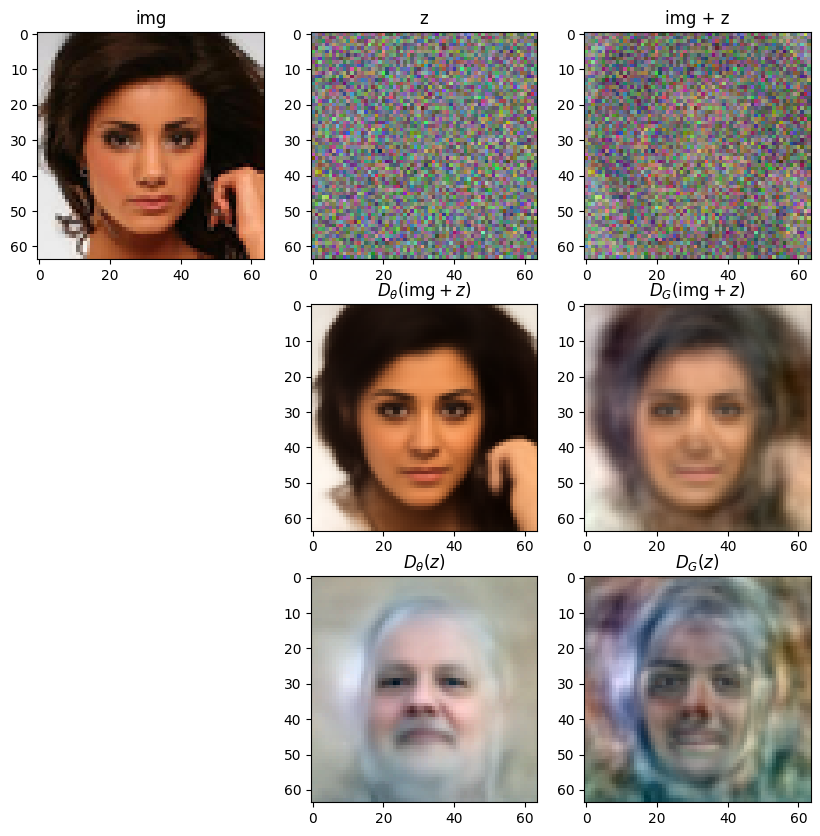

idx: 5


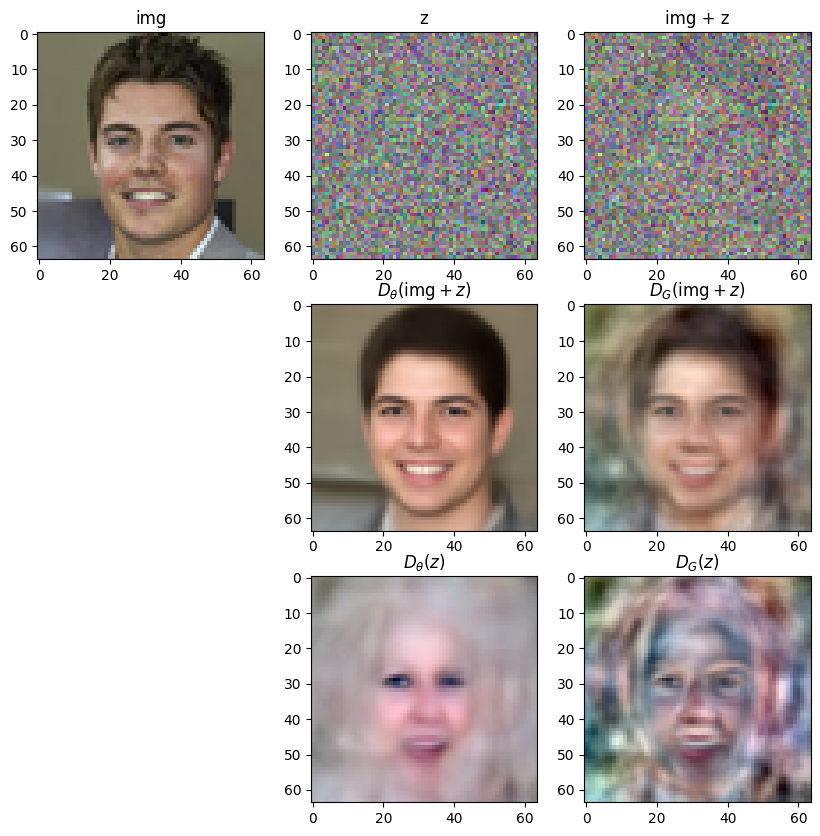

idx: 6


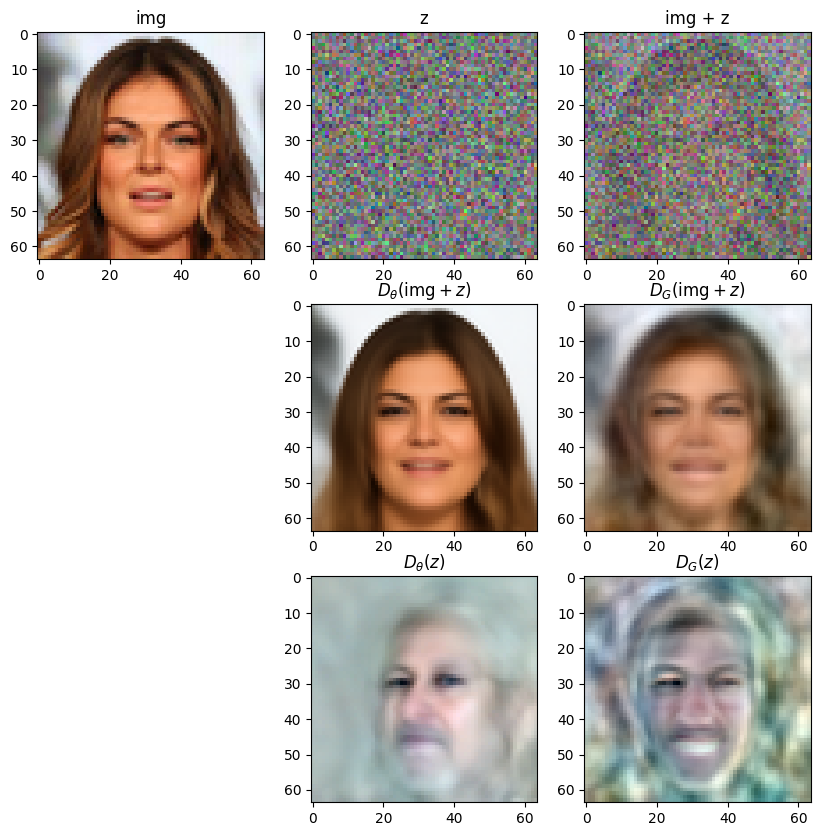

idx: 7


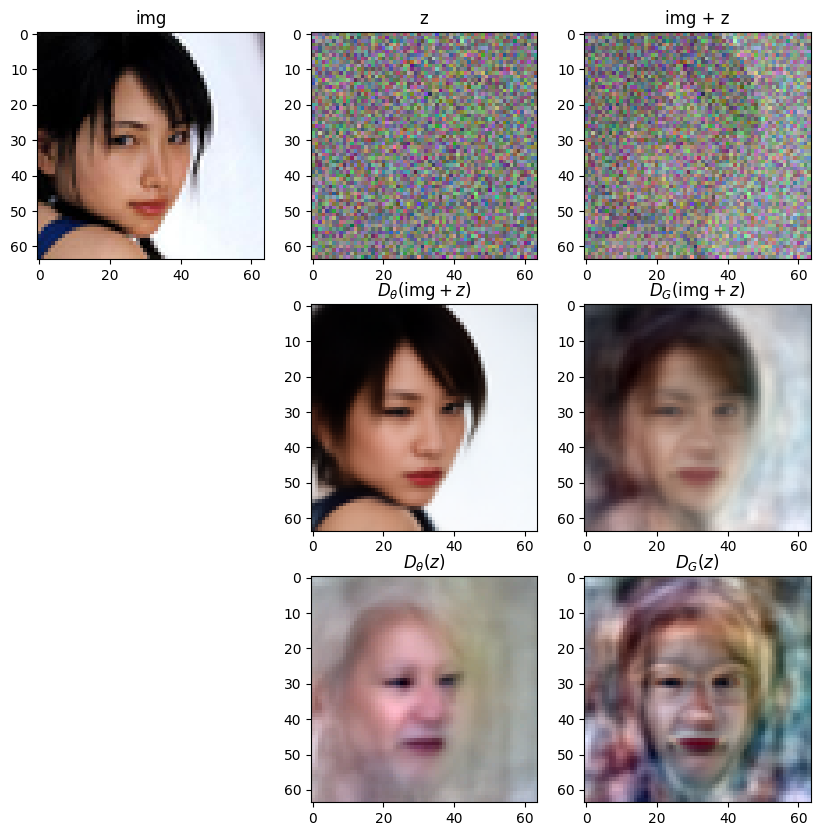

idx: 8


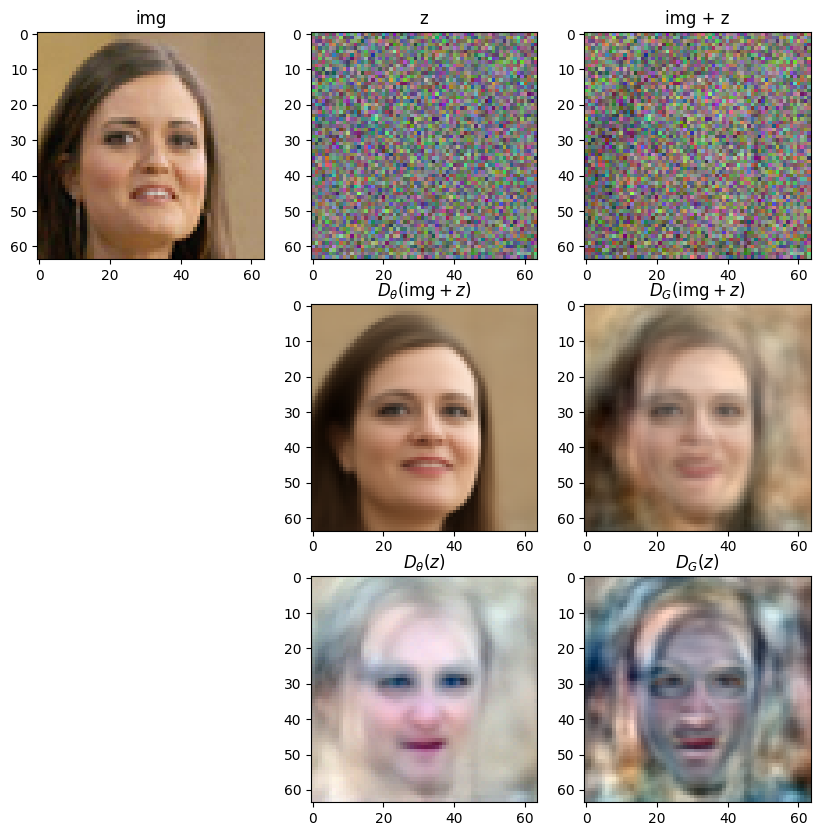

idx: 9


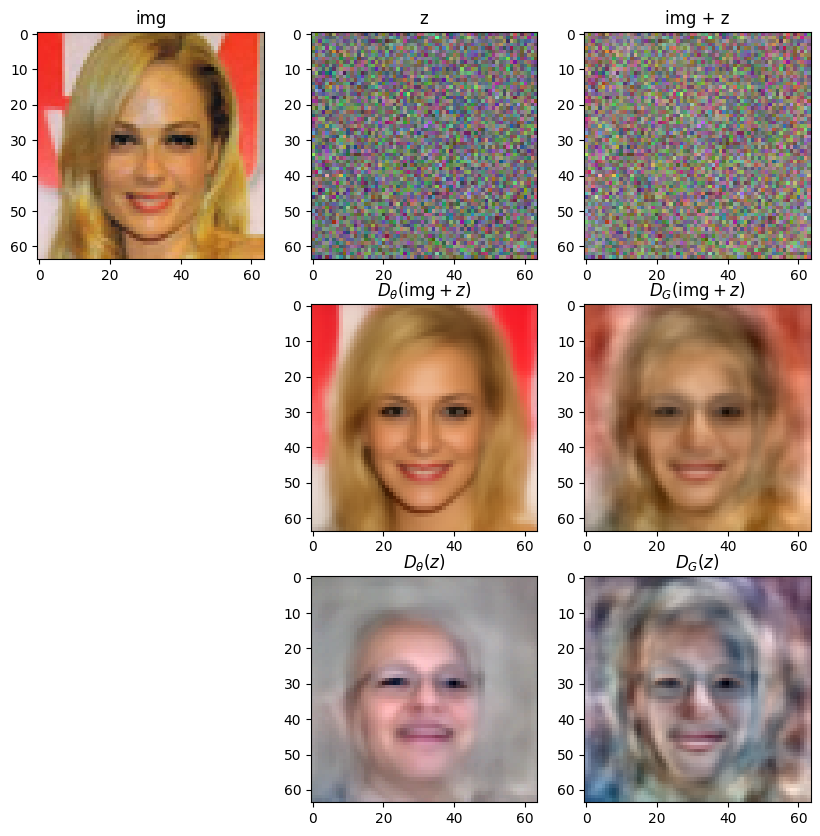

In [44]:
num_img = 10
sigma = 1.501741979068008
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### For sigma in the range [10, 1], the EDM denoisers are quite nonlinear and differ from the corresponding Gaussian denoisers. Nevertheless, despite the difference, the Gaussian denoisers still generate denoising outputs that share high similarity with those from the EDM denoisers. This noise range contributes the most to the perceptual quality of the final generated images.

### Sigma = 0.46997905799774714

idx: 0


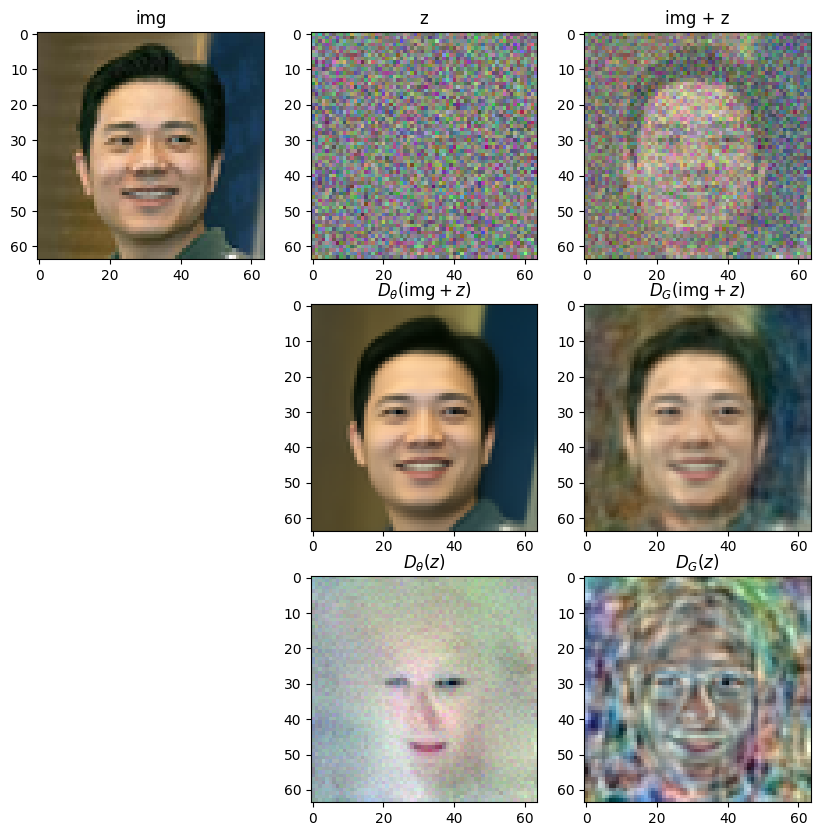

idx: 1


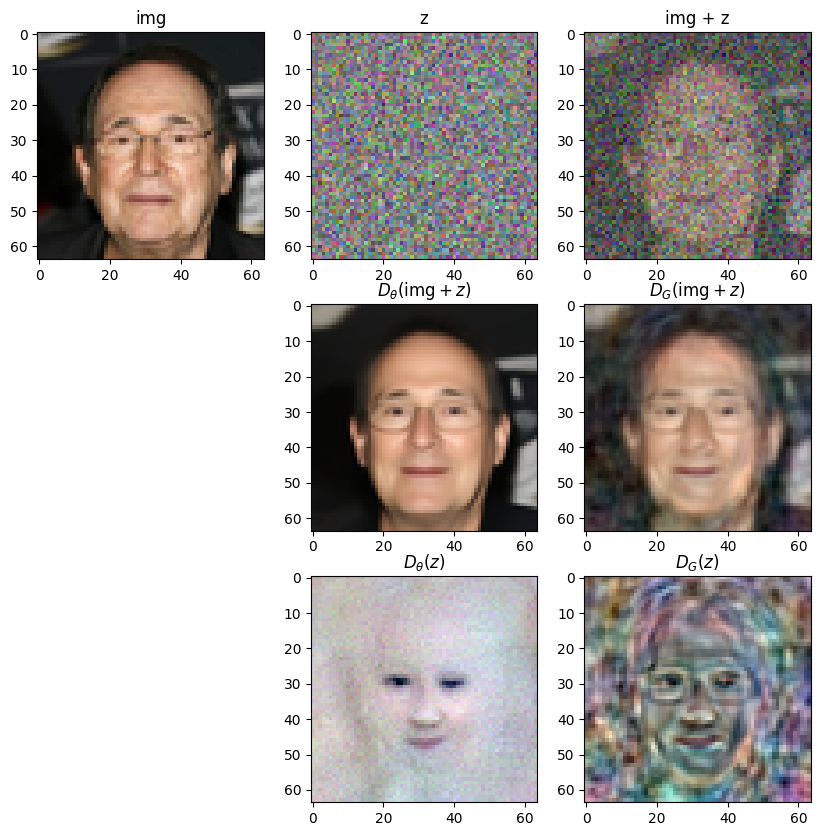

idx: 2


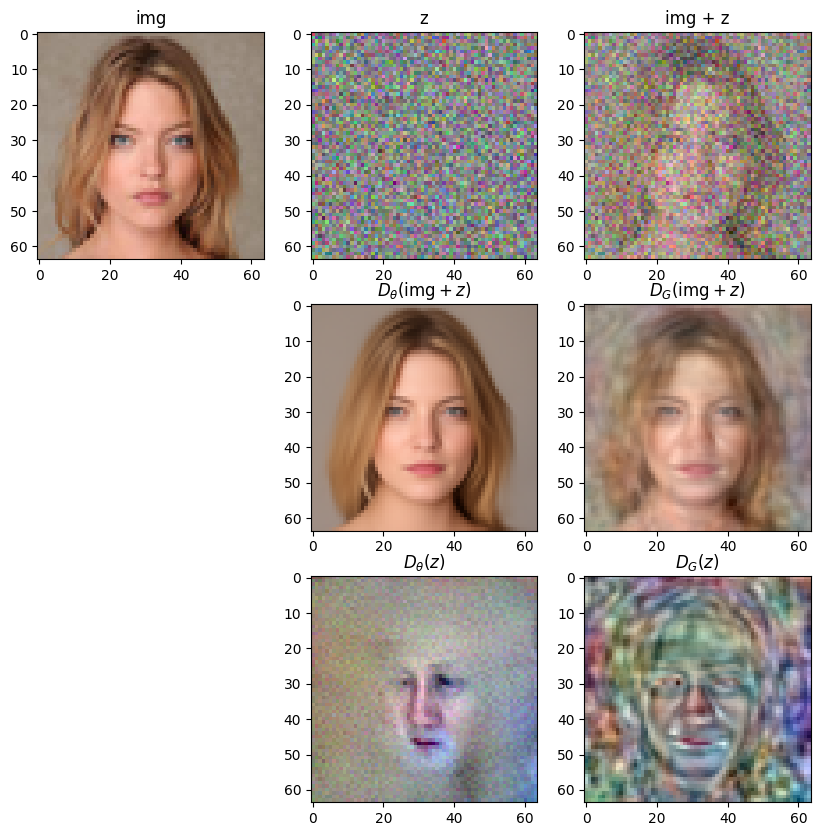

idx: 3


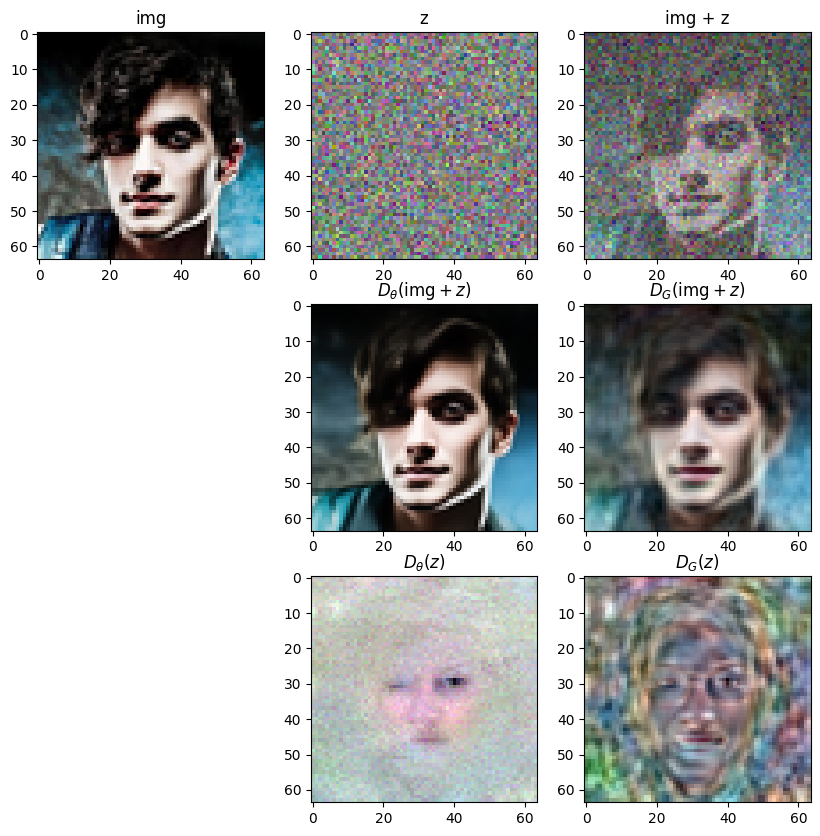

idx: 4


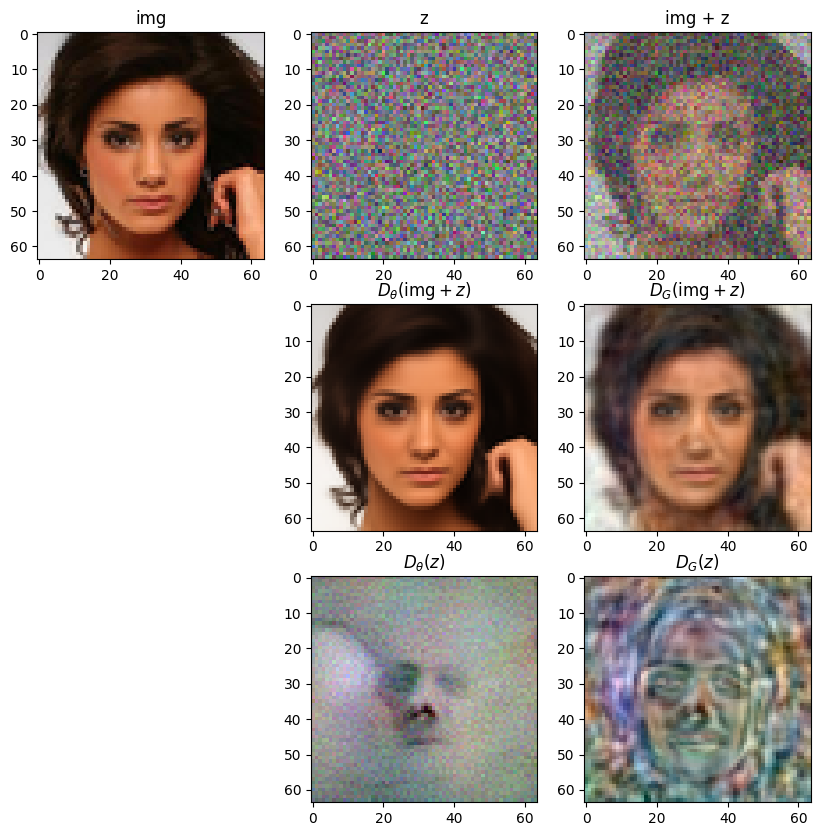

idx: 5


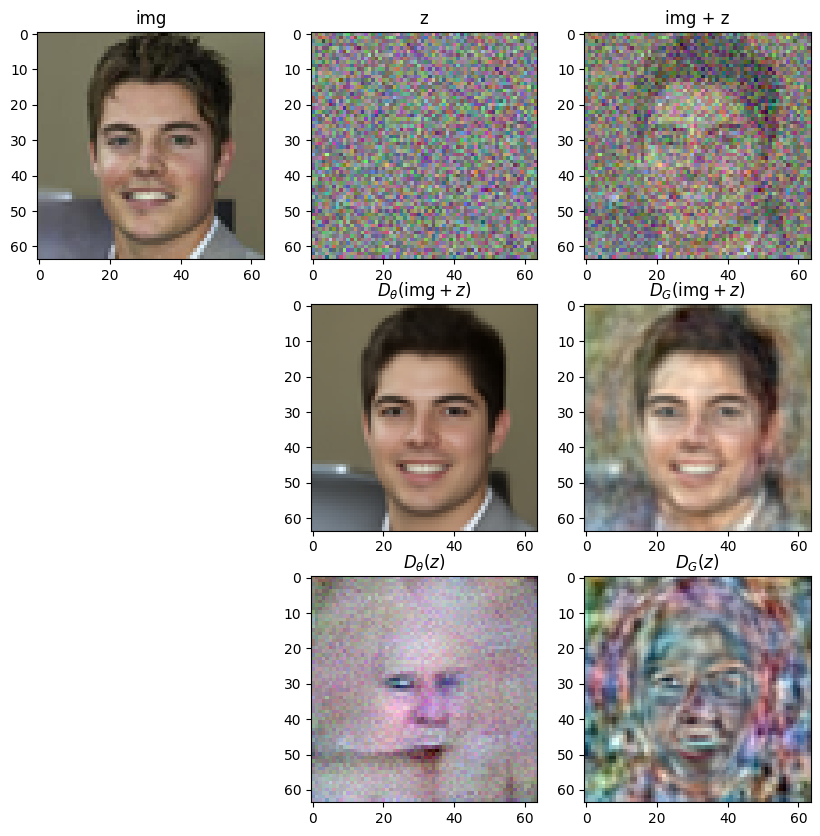

idx: 6


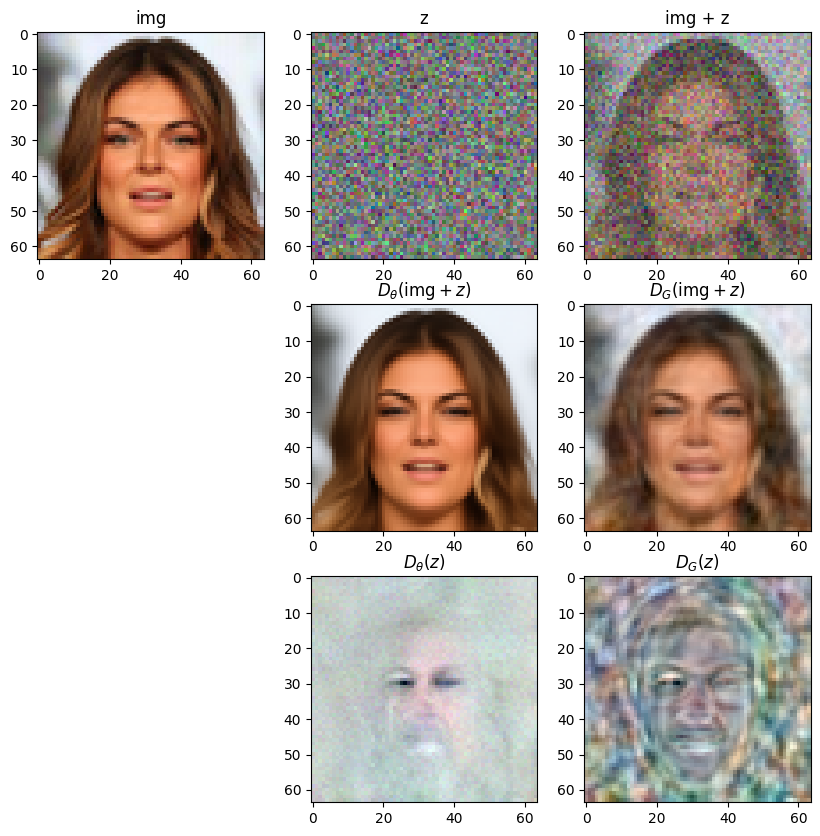

idx: 7


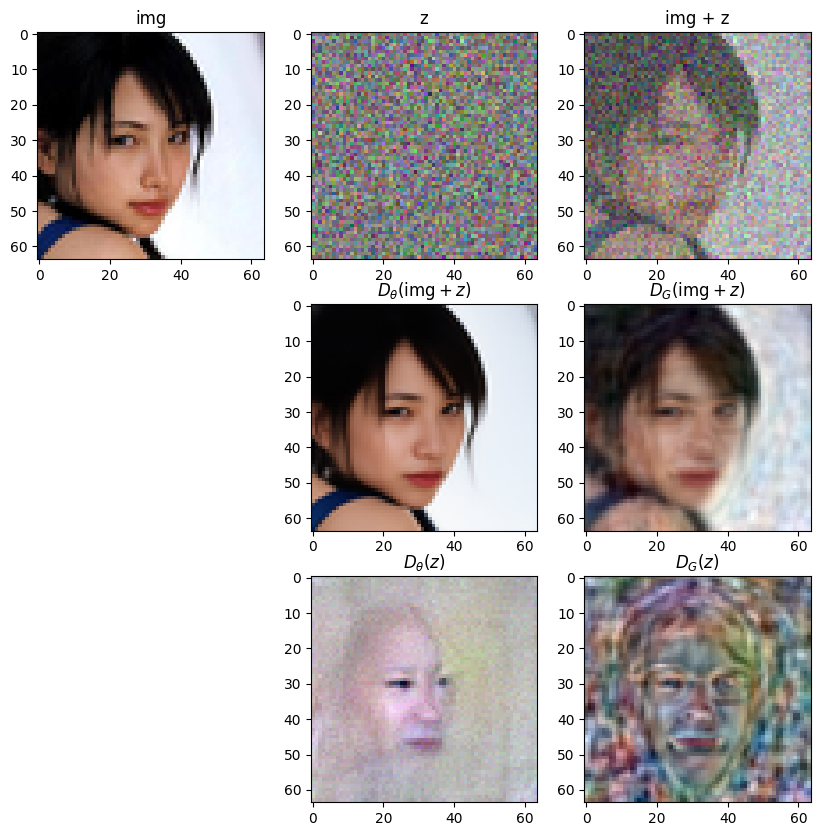

idx: 8


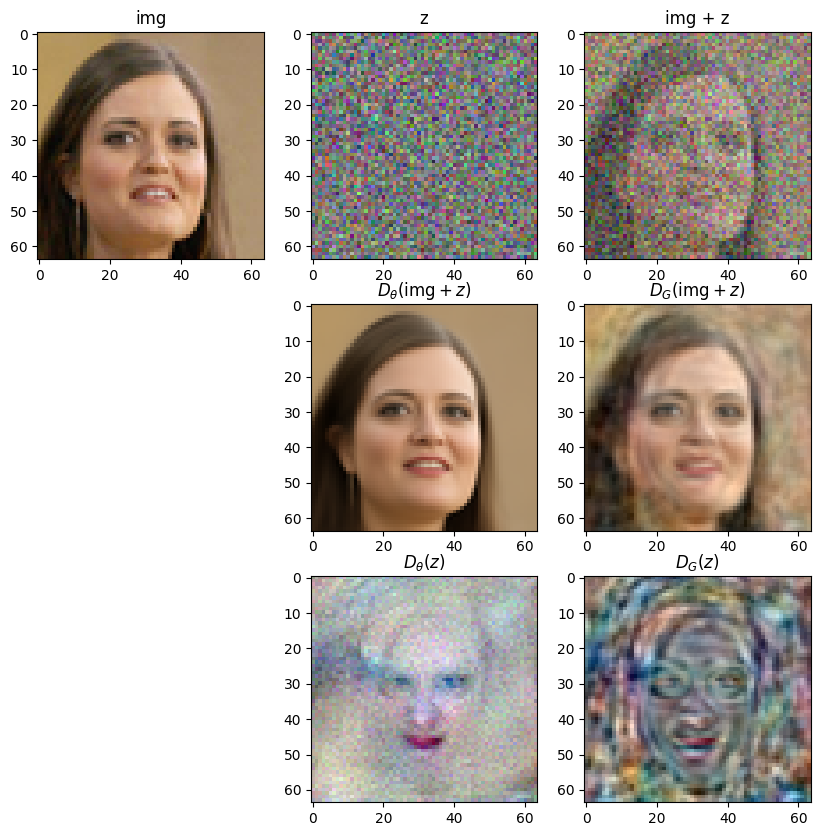

idx: 9


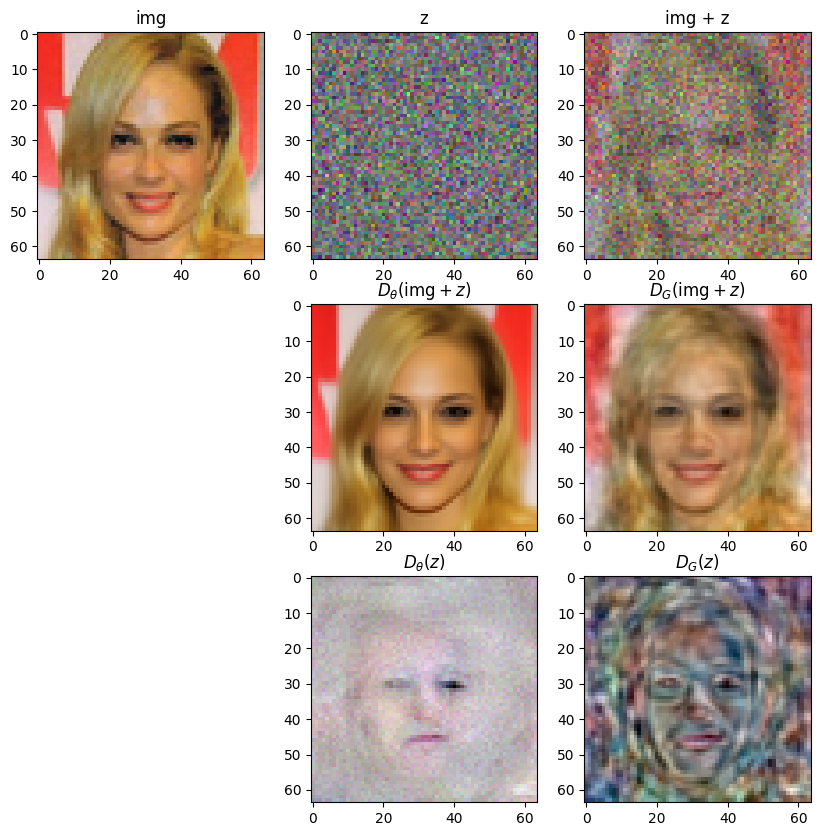

In [45]:
num_img = 10
sigma = 0.46997905799774714
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### For sigma = 0.46, Gaussian denoisers seem to be a lot worse compared to EDM denoisers regarding the denoising ability. Nevertheless, this noise level does not contribute much to the image generation process of diffusion models.

### Sigma = 0.1

idx: 0


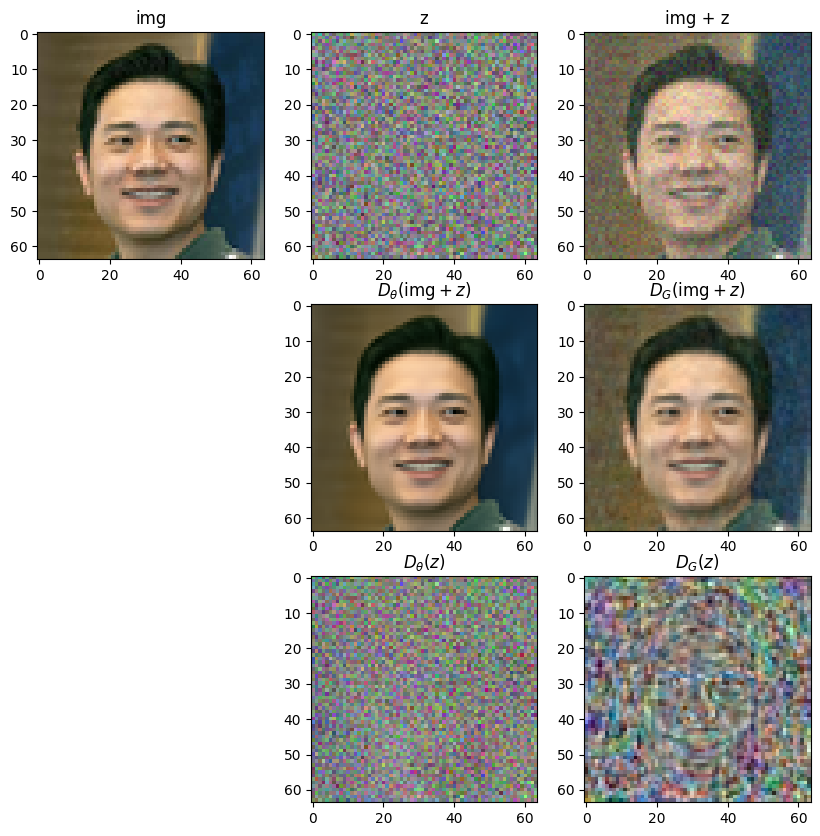

idx: 1


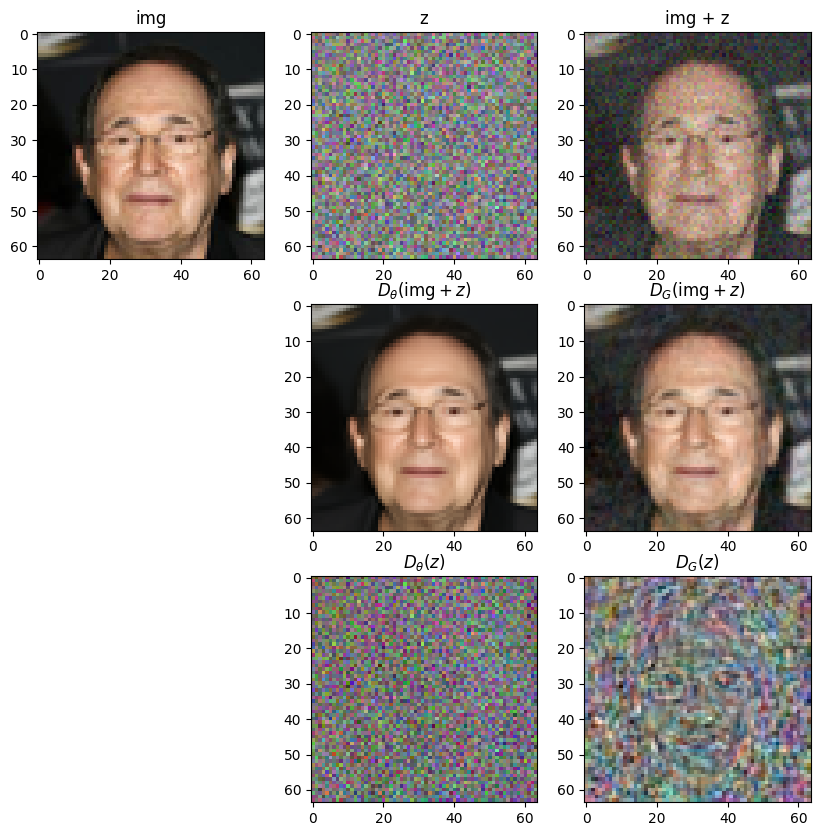

idx: 2


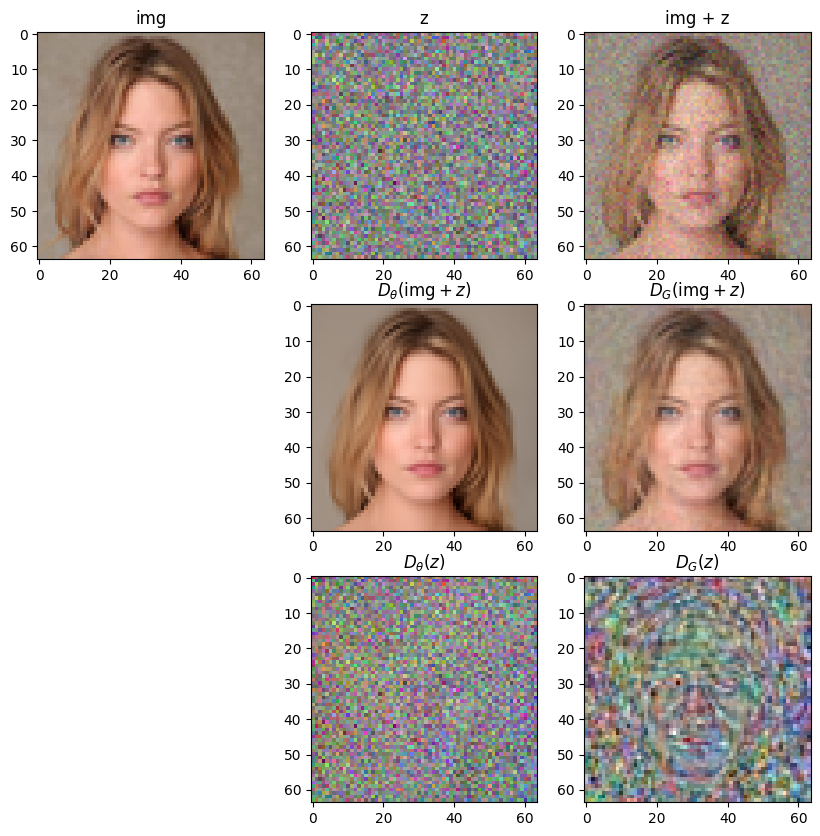

idx: 3


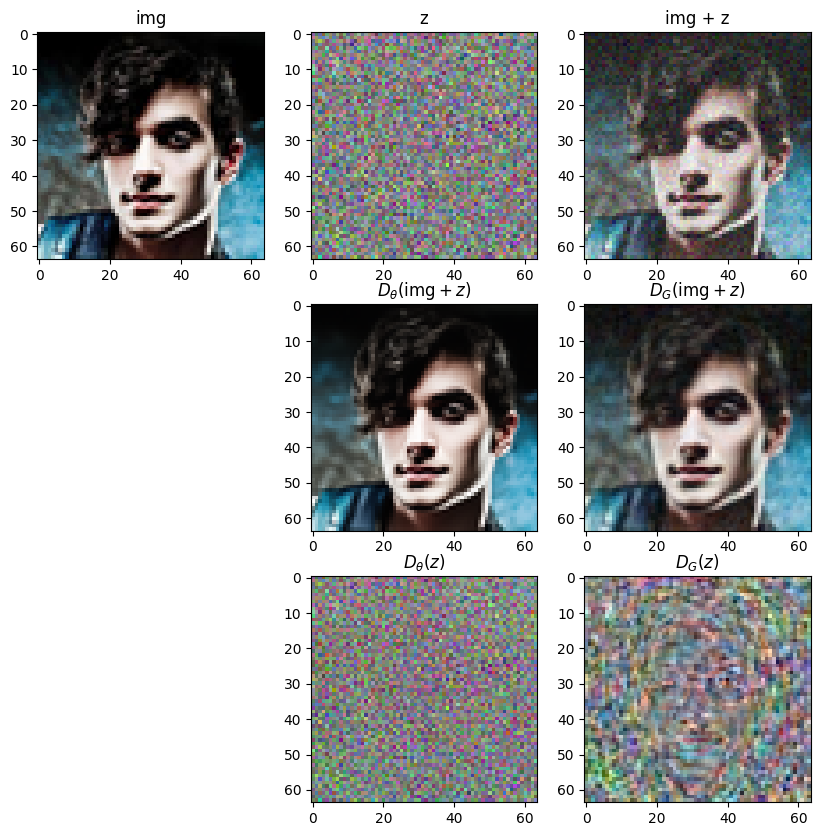

idx: 4


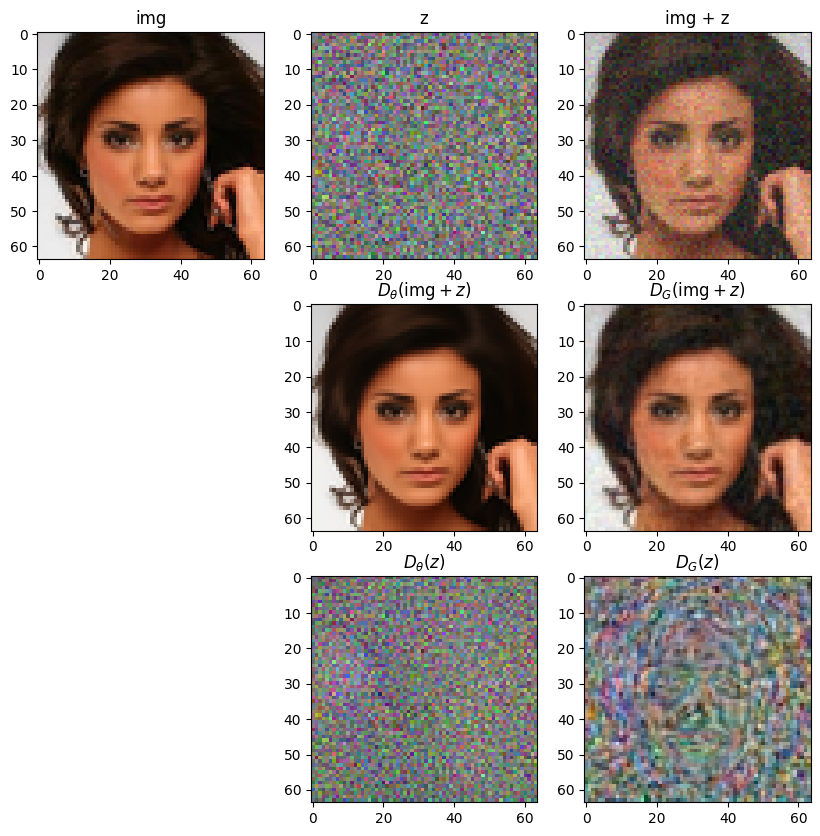

idx: 5


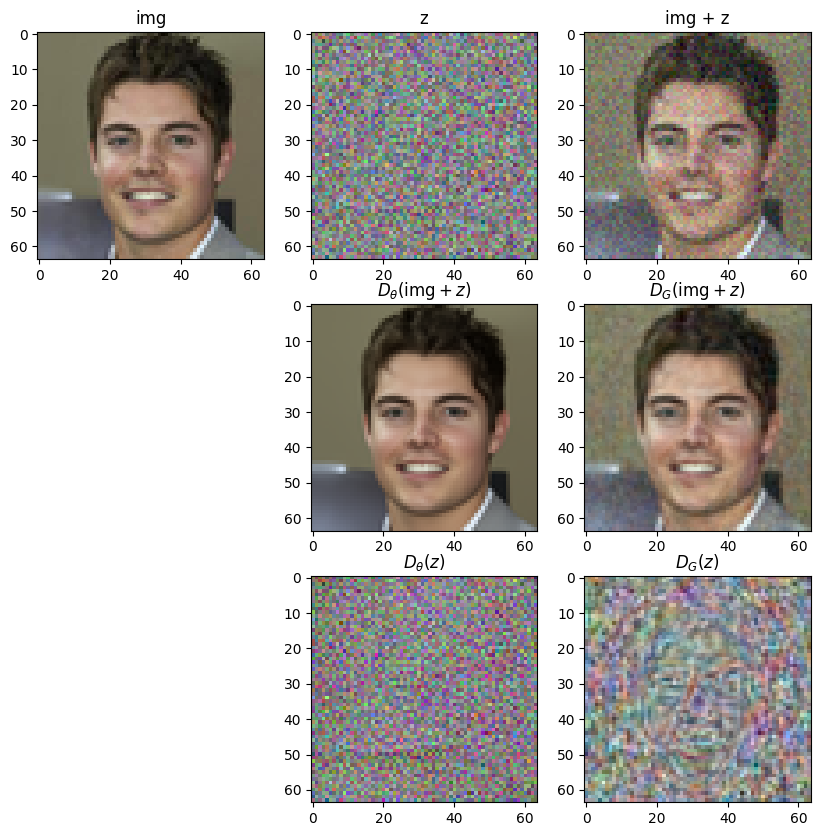

idx: 6


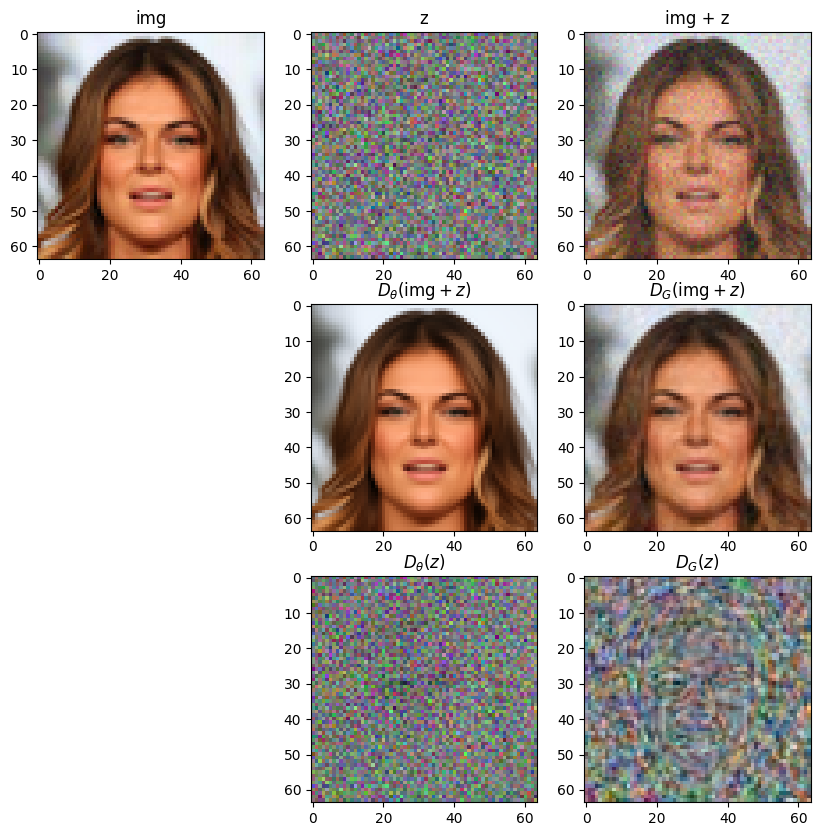

idx: 7


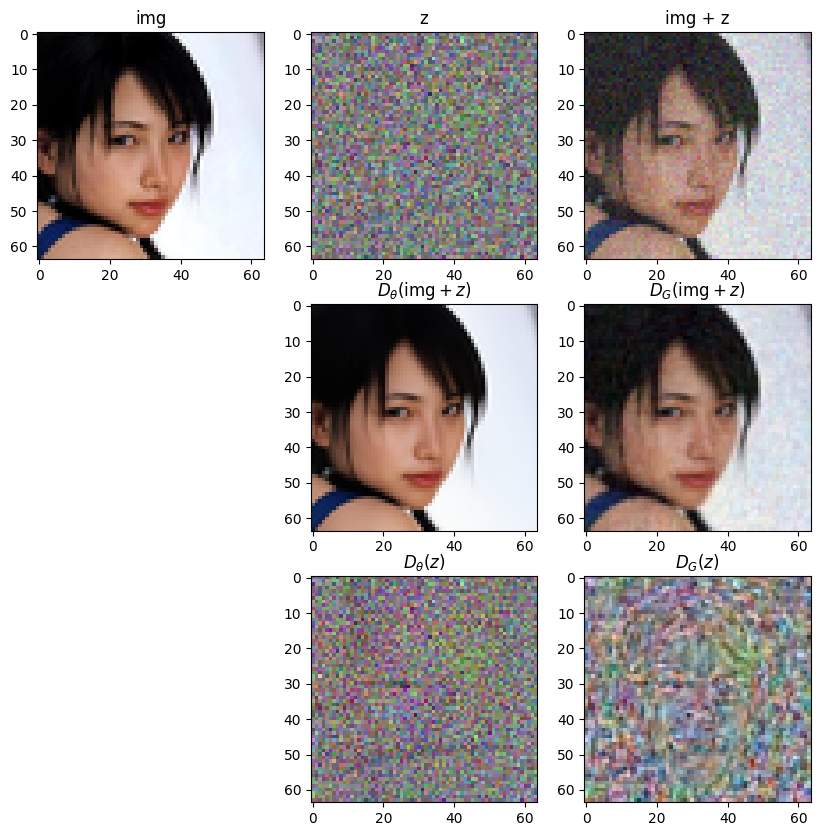

idx: 8


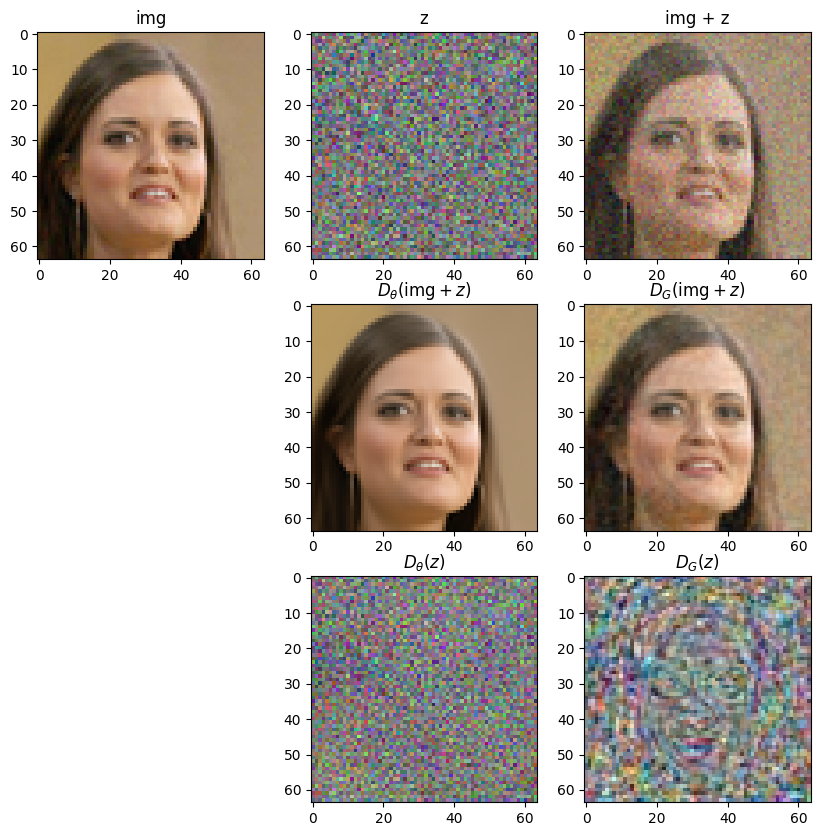

idx: 9


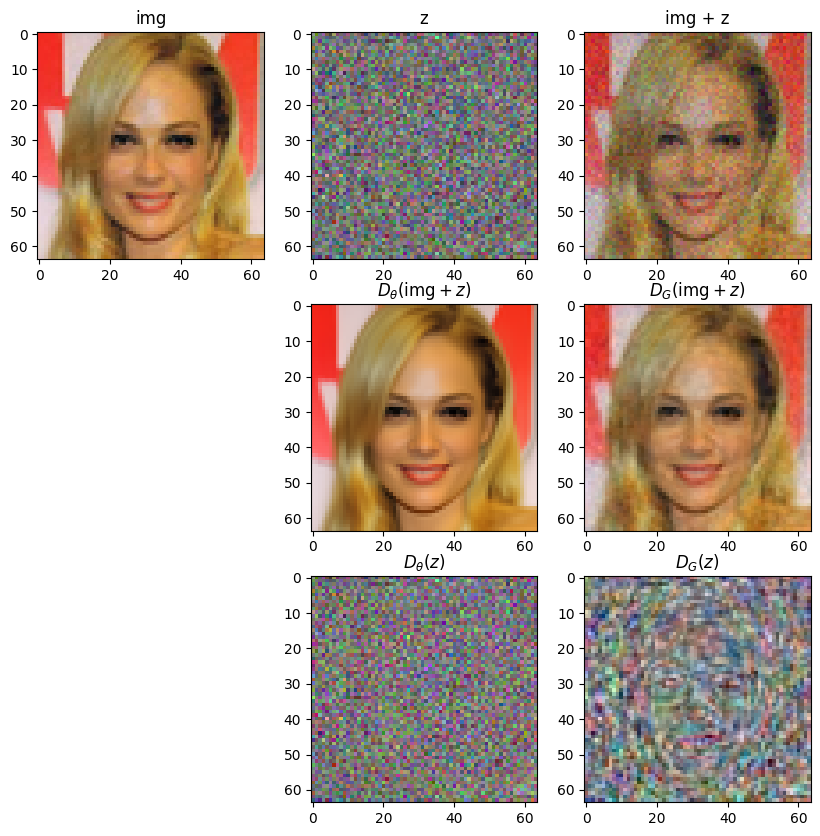

In [46]:
num_img = 10
sigma = 0.11663856352517865
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 0.02

idx: 0


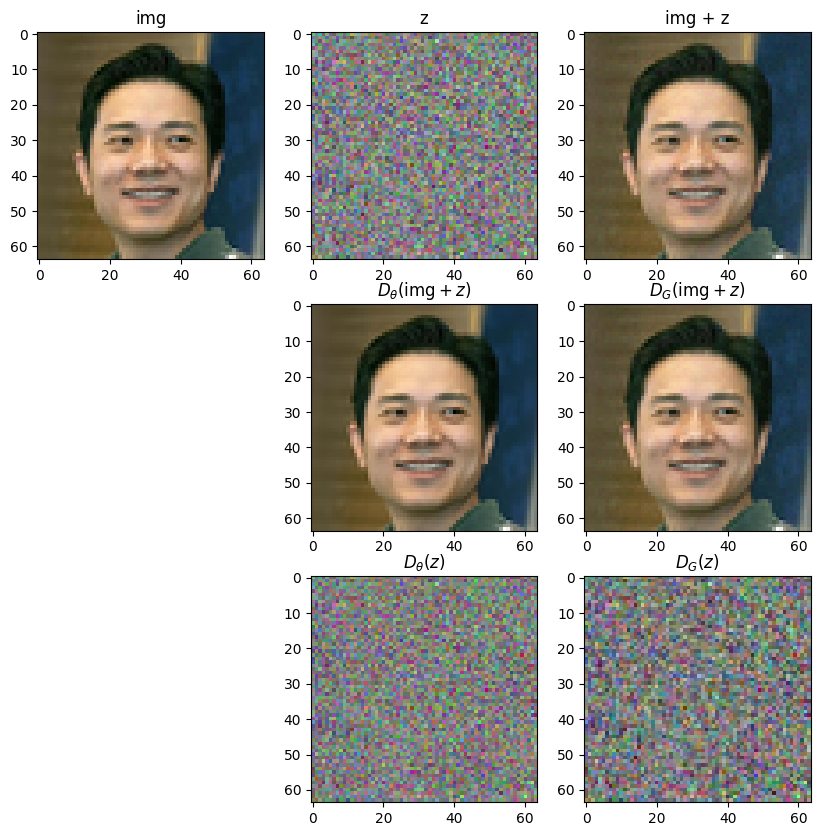

idx: 1


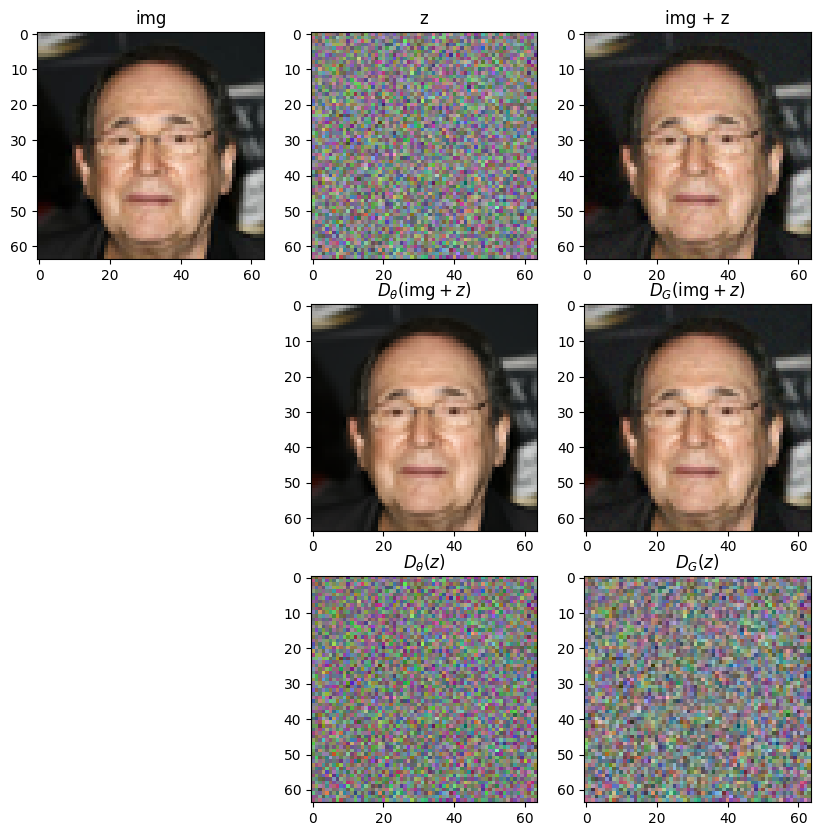

idx: 2


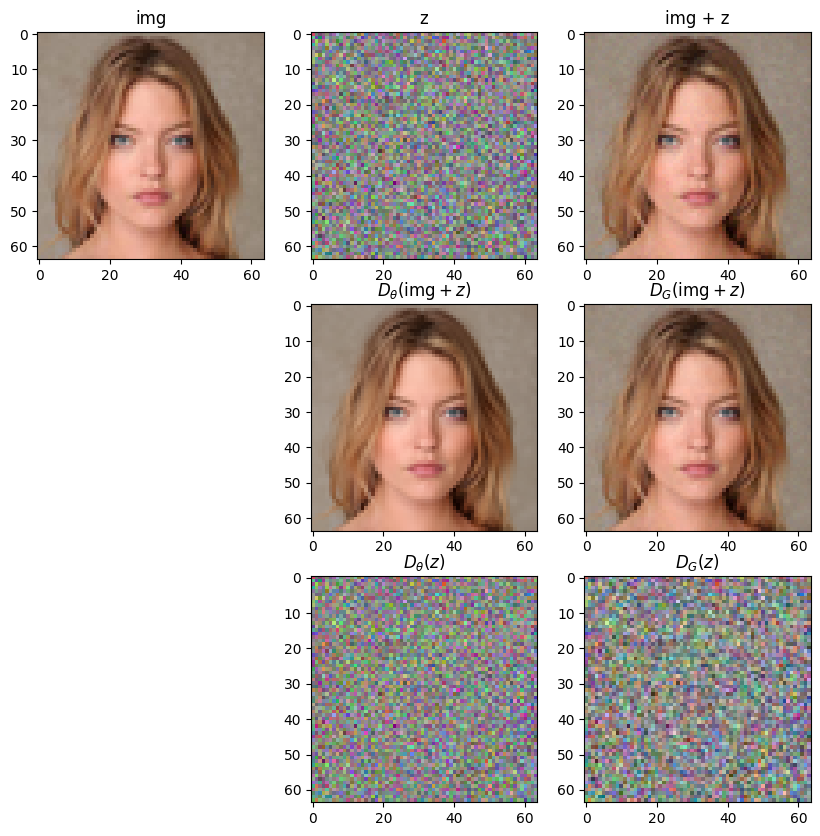

idx: 3


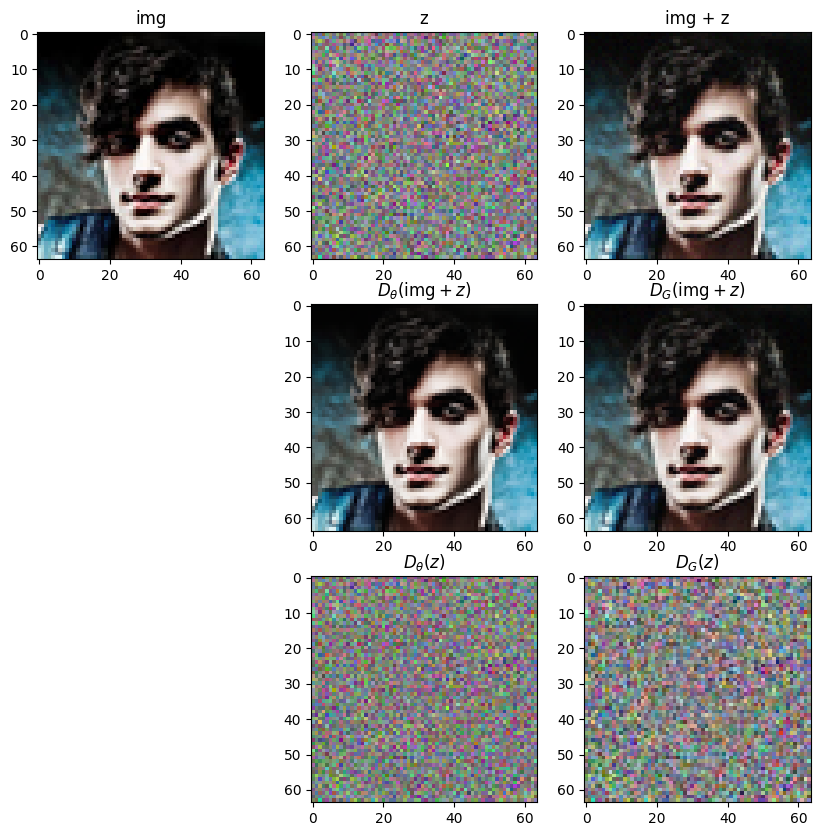

idx: 4


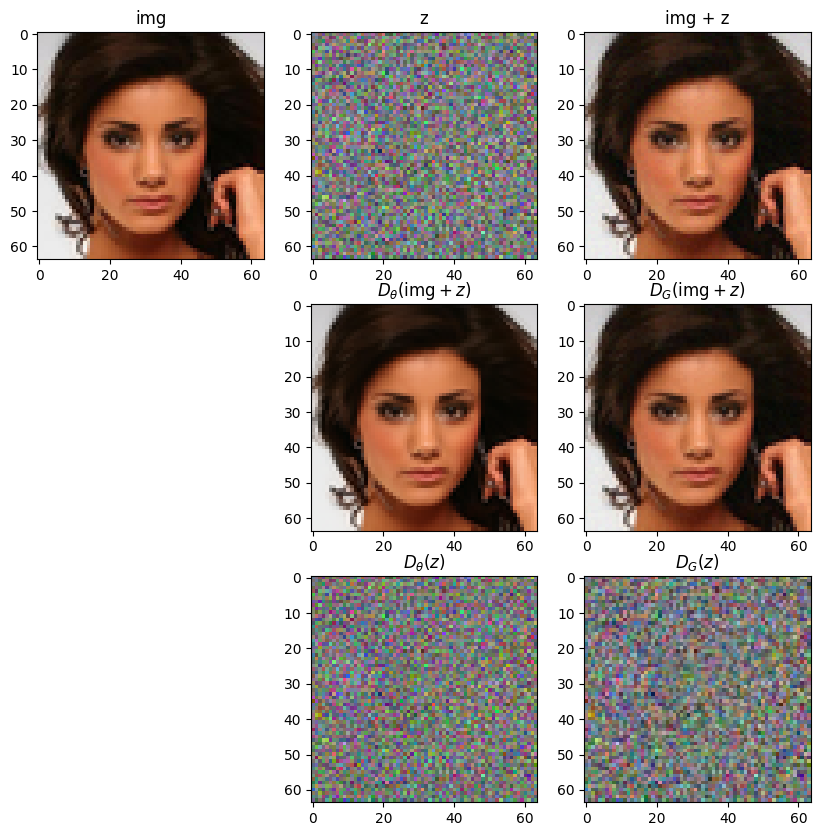

idx: 5


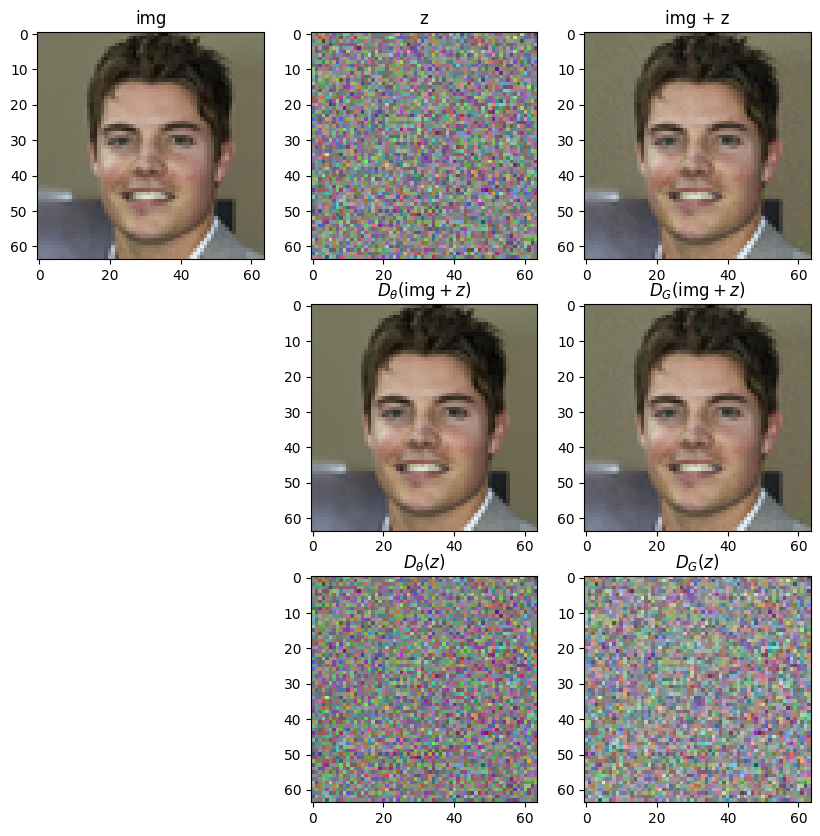

idx: 6


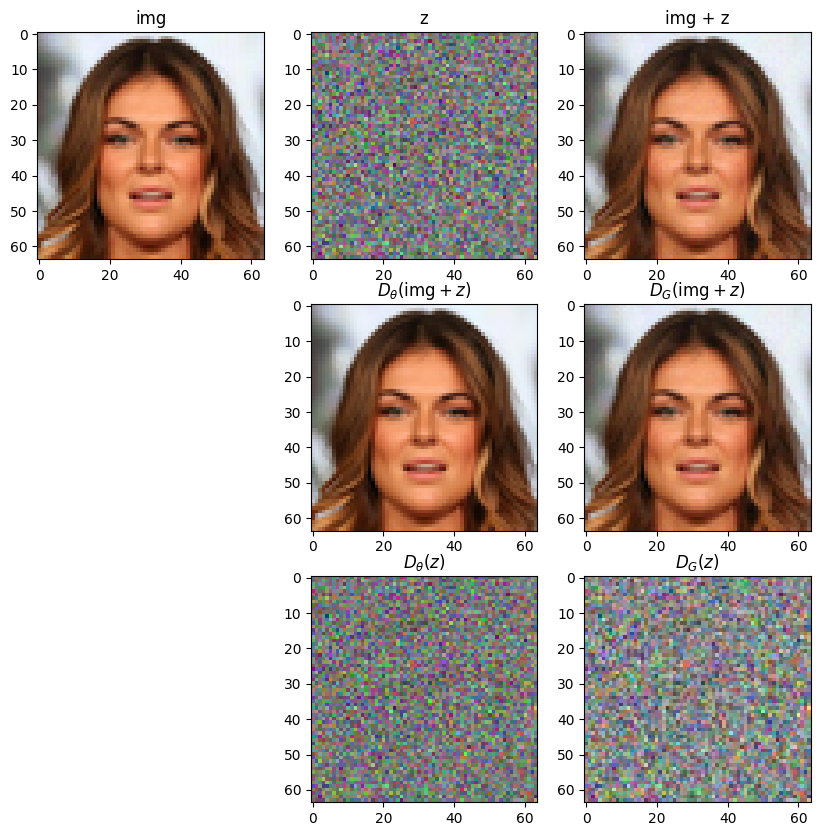

idx: 7


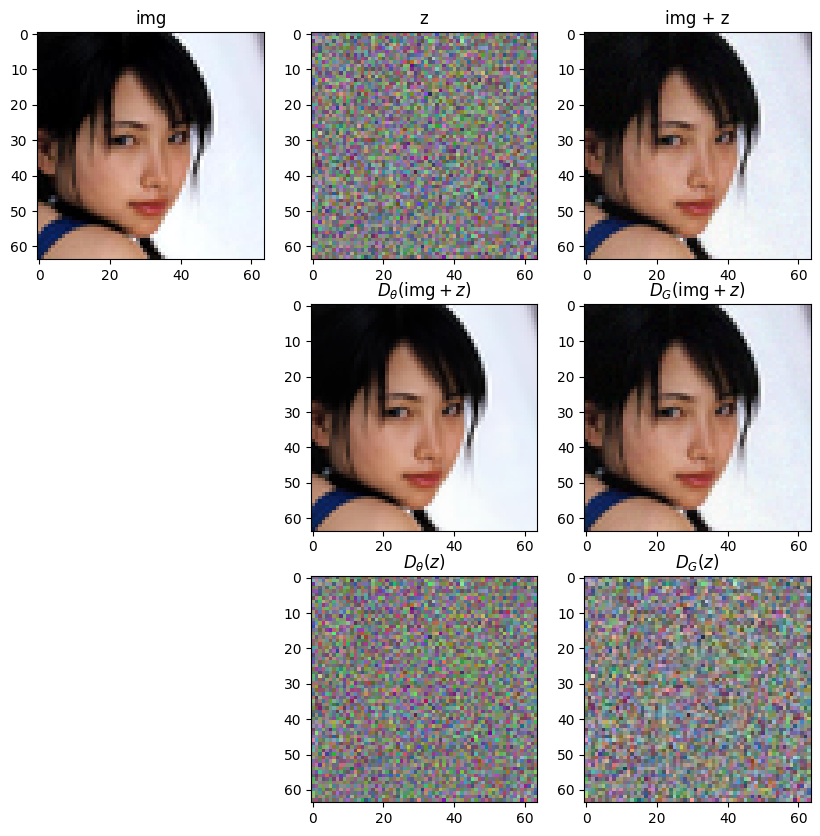

idx: 8


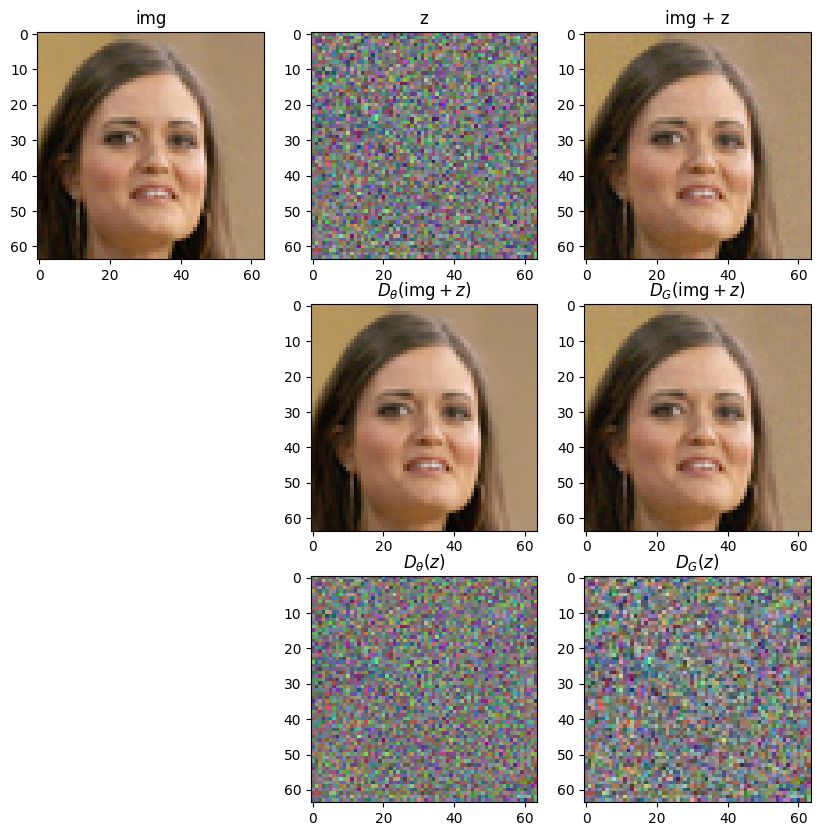

idx: 9


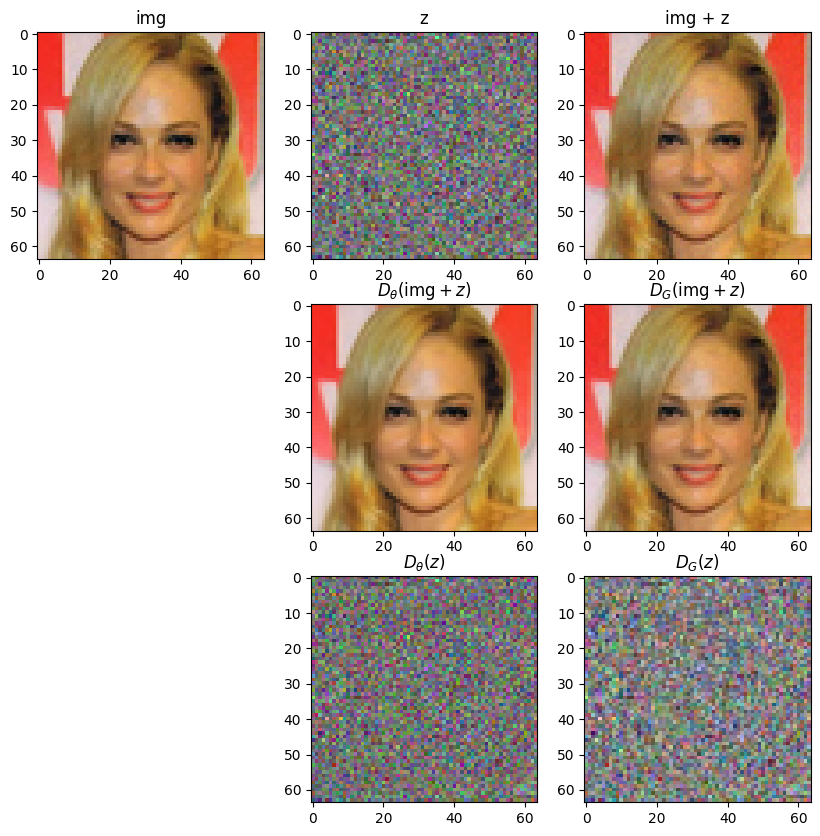

In [47]:
num_img = 10
sigma = 0.020435334553438746
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 0.002 

idx: 0


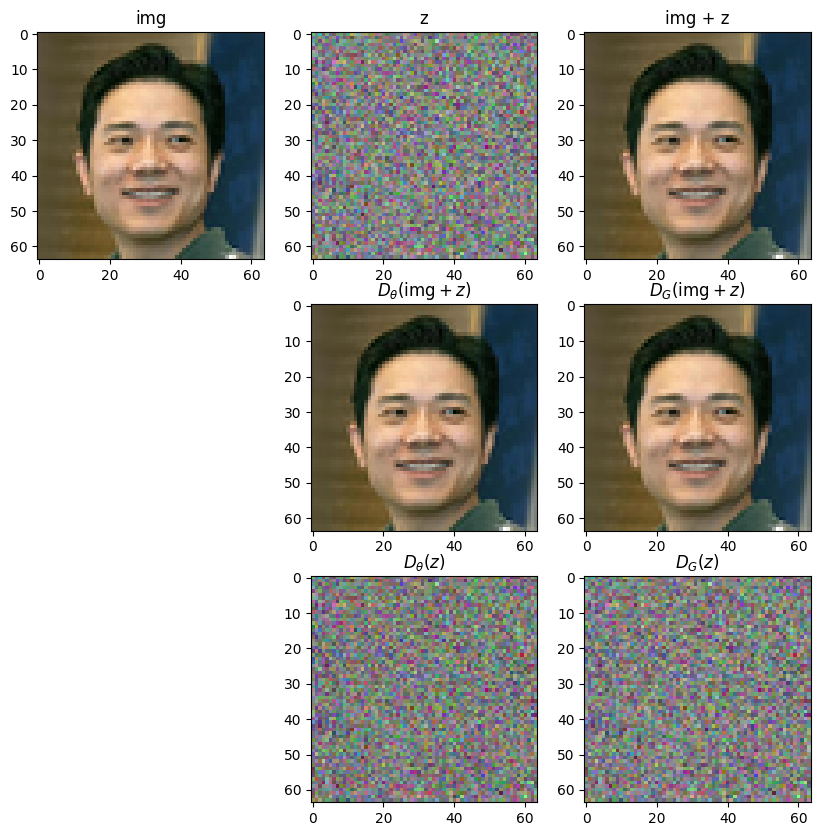

idx: 1


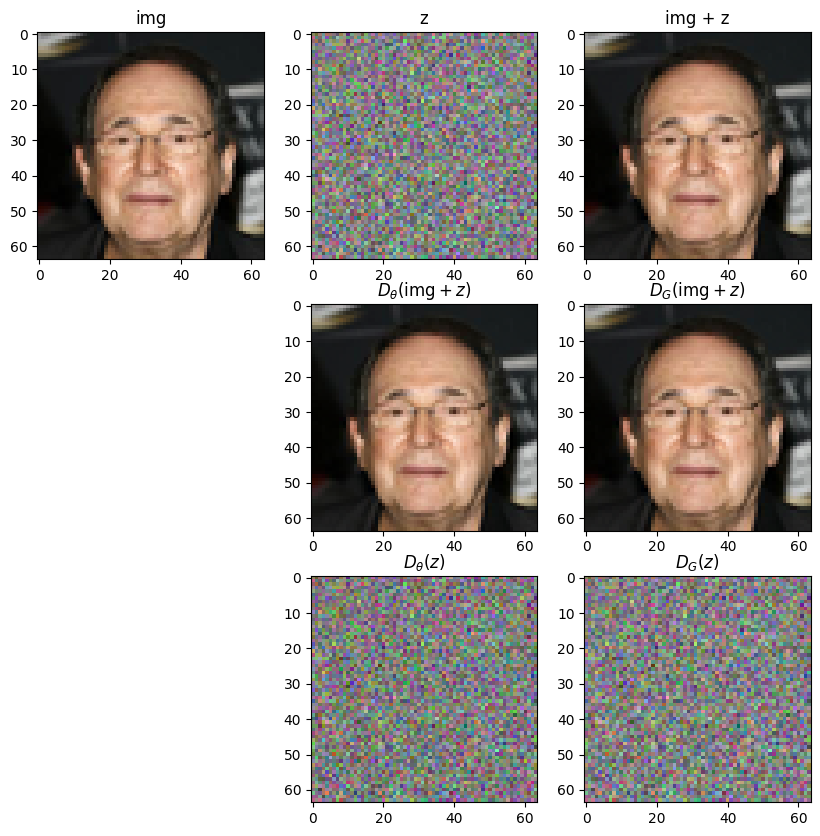

idx: 2


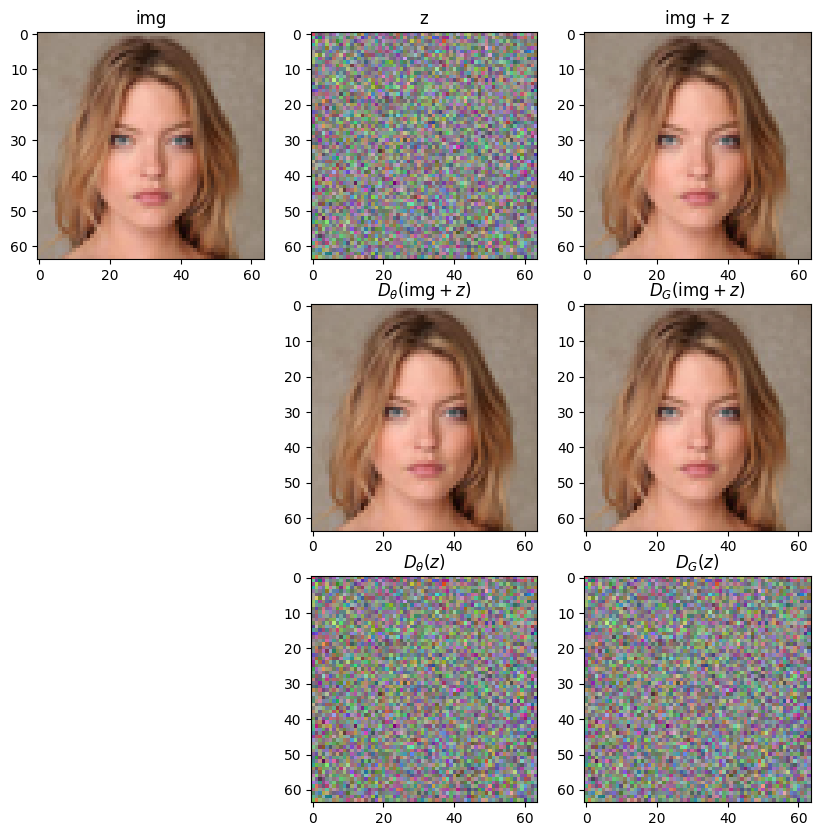

idx: 3


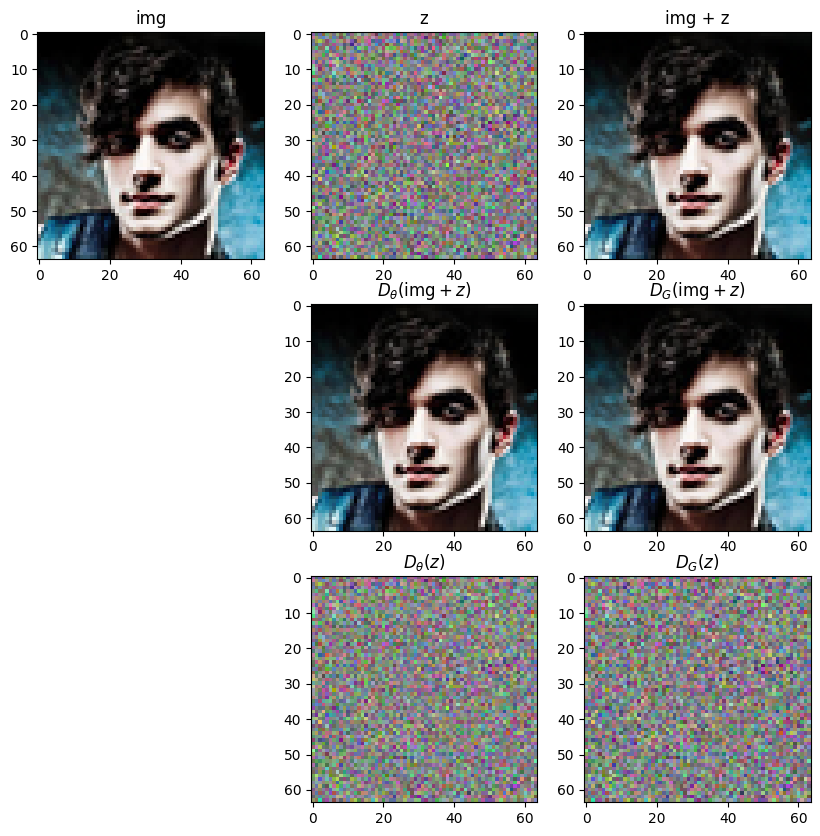

idx: 4


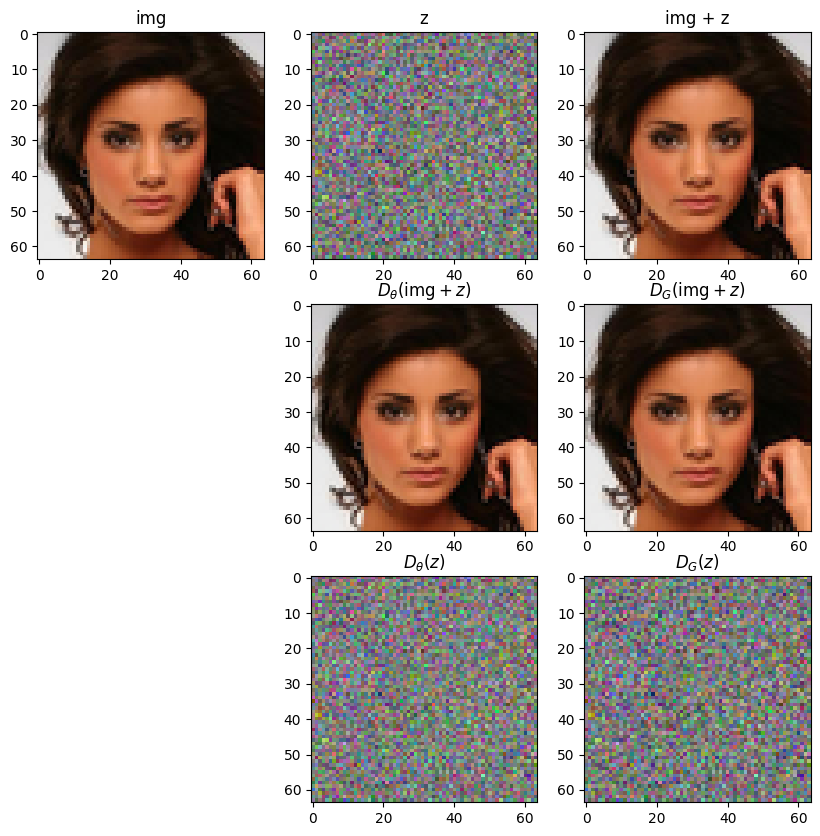

idx: 5


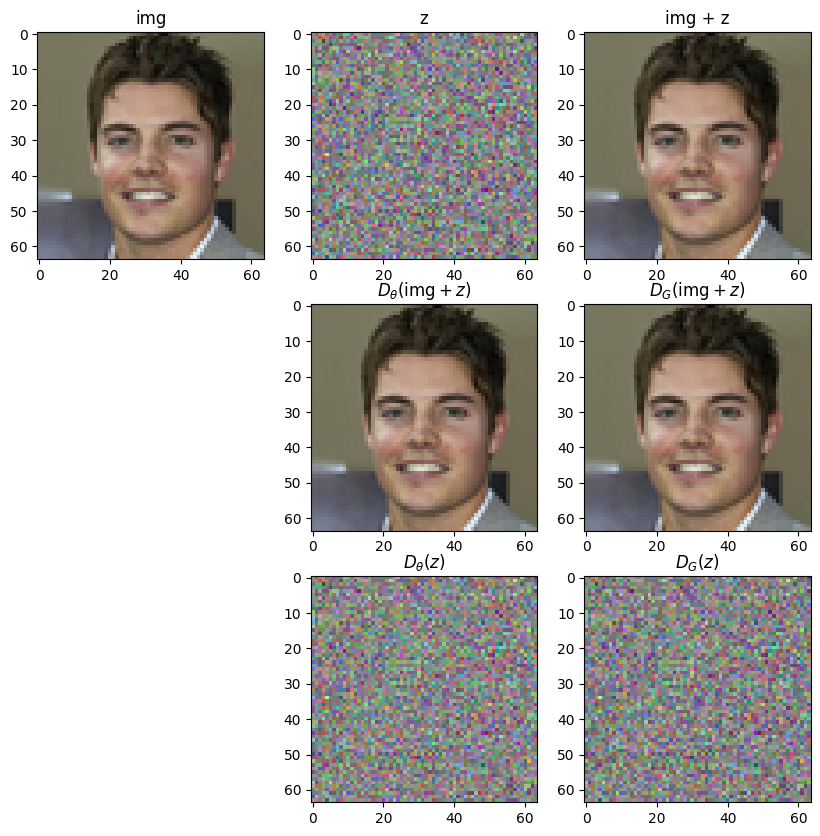

idx: 6


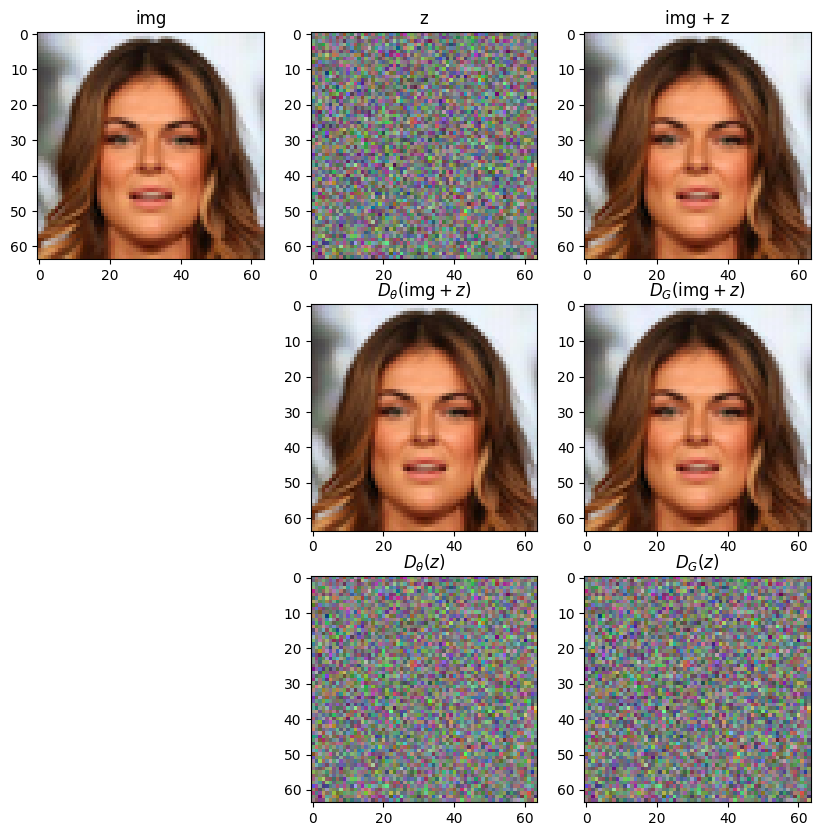

idx: 7


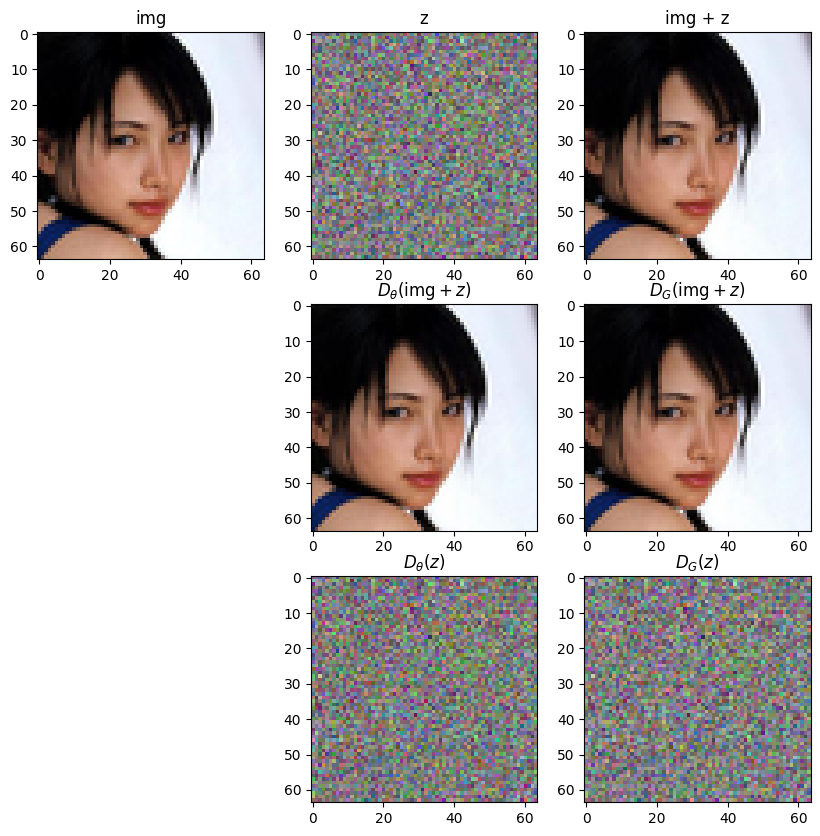

idx: 8


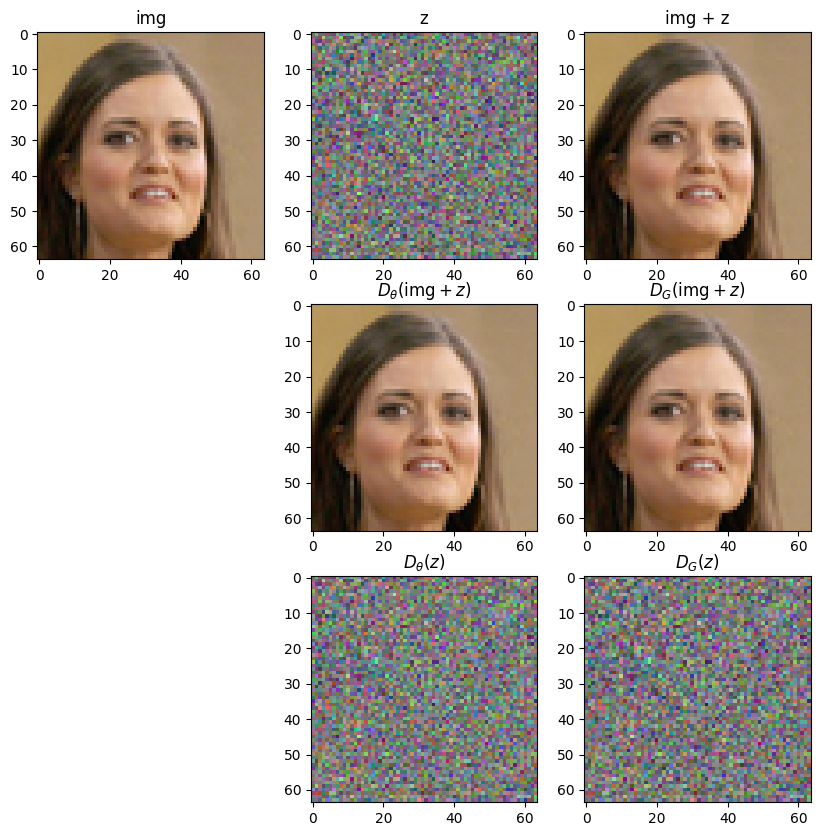

idx: 9


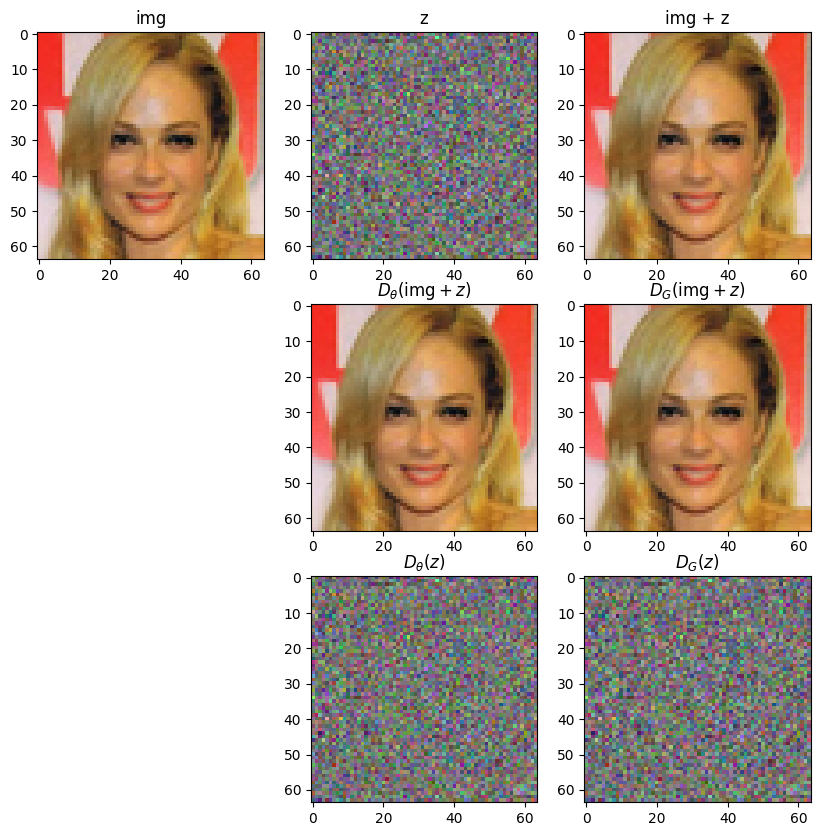

In [48]:
num_img = 10
sigma = 0.002000000000000003
torch.manual_seed(0)
rank = 1*3*64*64

for i in range(num_img):
    noise = torch.randn((1,3,64,64), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_celeb[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_ffhq, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_ffhq, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_ffhq((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,64,64)
    
    denoised_img_combine_Gaussian = Gaussian_model_ffhq((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,64,64)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,64,64).permute(1,2,0).detach().cpu()))
    
    plt.show()

### For very low noise levels [0.1, 0.002], the noise is minimal compared to the clean image. In this case diffusion models degenerate to the identity mapping, i.e., when input pure noise, the network will output noise as well. There's not much information generated from the diffusion models and the contribution of these regime to the final generation is minimal.

### 2. Below we repeat the same experiments for Cifar-10 dataset. Since the diffusion model is trained on  Cifar-10 training set, we use the Cifar-10 test set to construct our noisy images. The results again demonstrate that the Gaussian denoisers and the EDM denoisers share high similarity across a wide range of noise levels. Here we'd like to note that for very high noise levels 80 and 42, the EDM generates worse denoising outputs compared to the Gaussian model. As we demonstrated in the paper (Appendix G.5), this is because the EDM is not trained sufficiently in the high noise regime. Under sufficient training, the deep network will learn denoisers that are close to the Gaussian denoisers.

### Sigma = 80

idx: 0


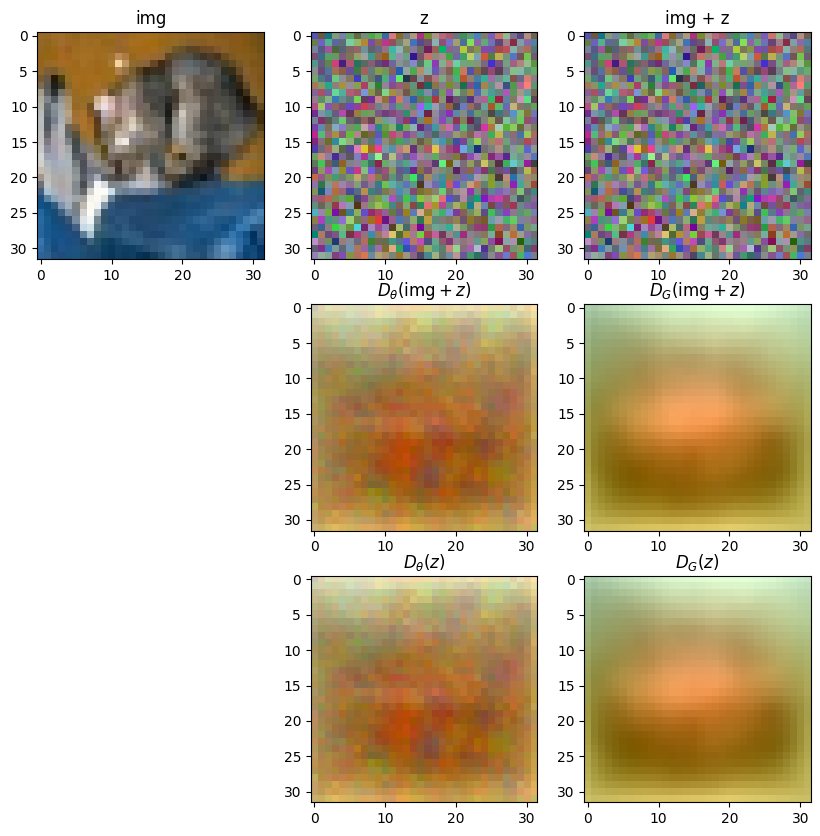

idx: 1


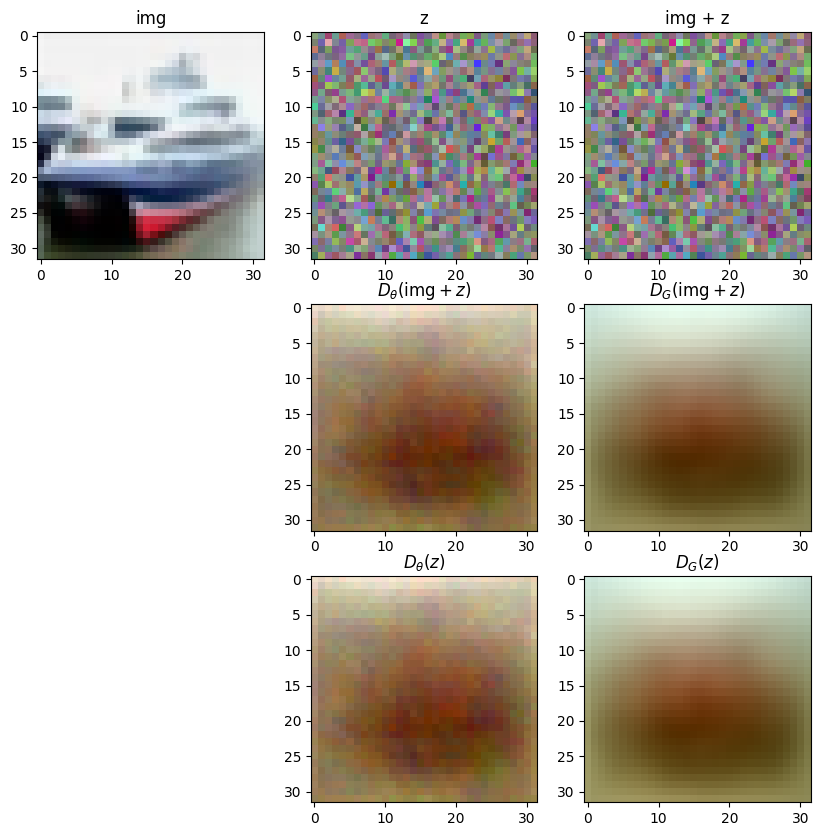

idx: 2


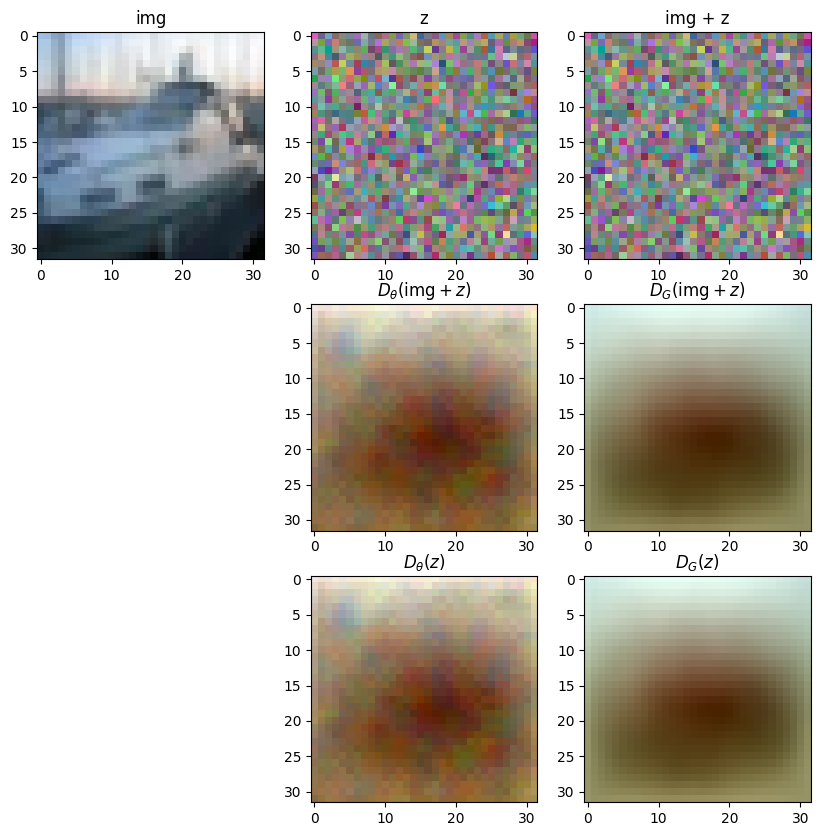

idx: 3


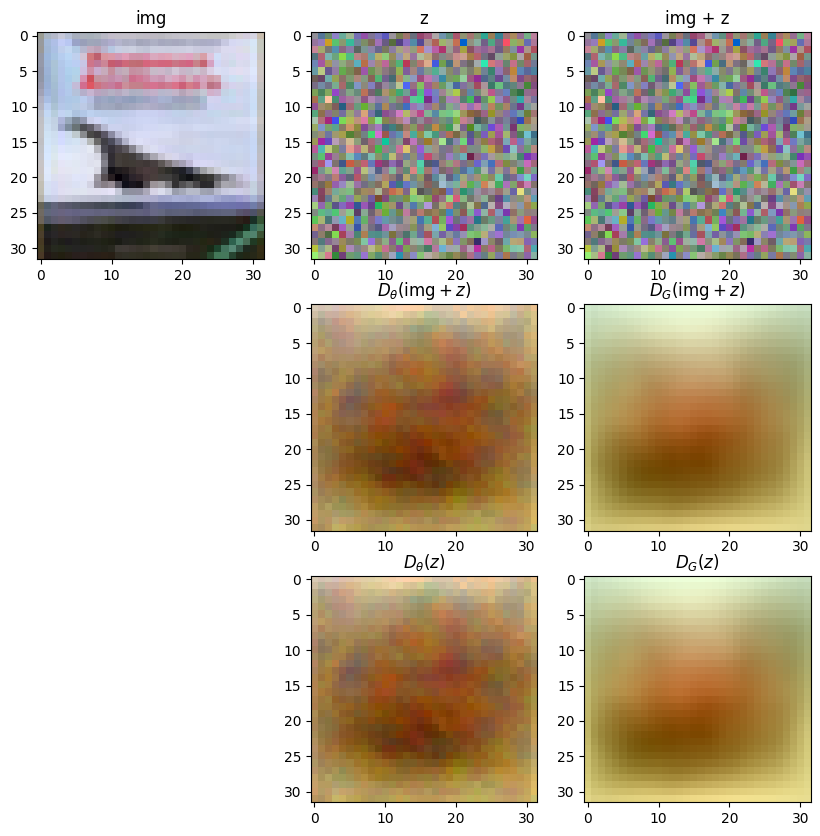

idx: 4


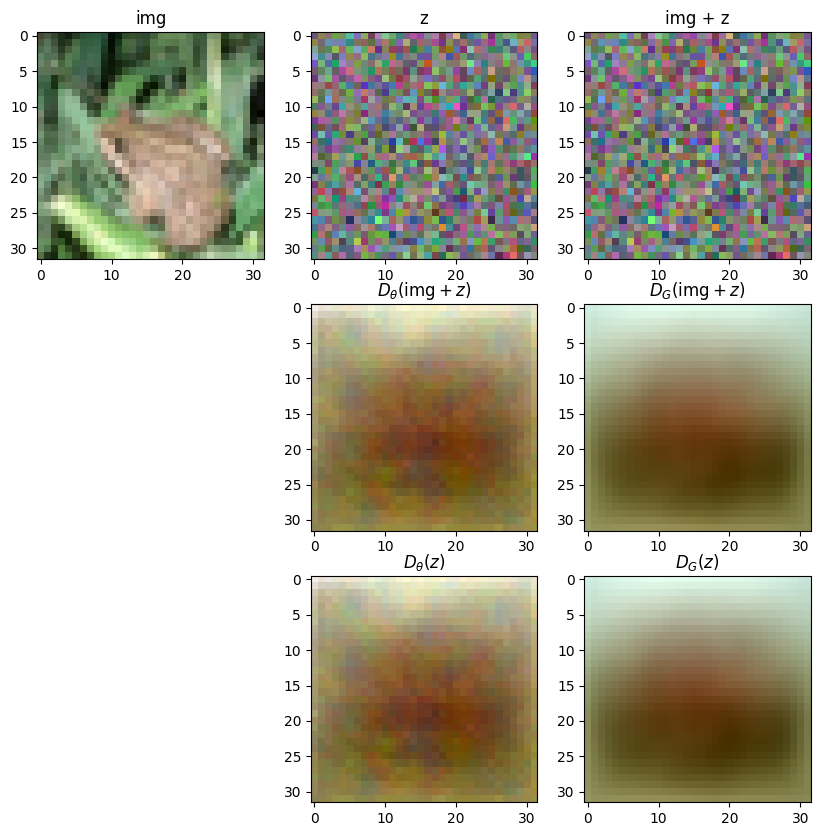

idx: 5


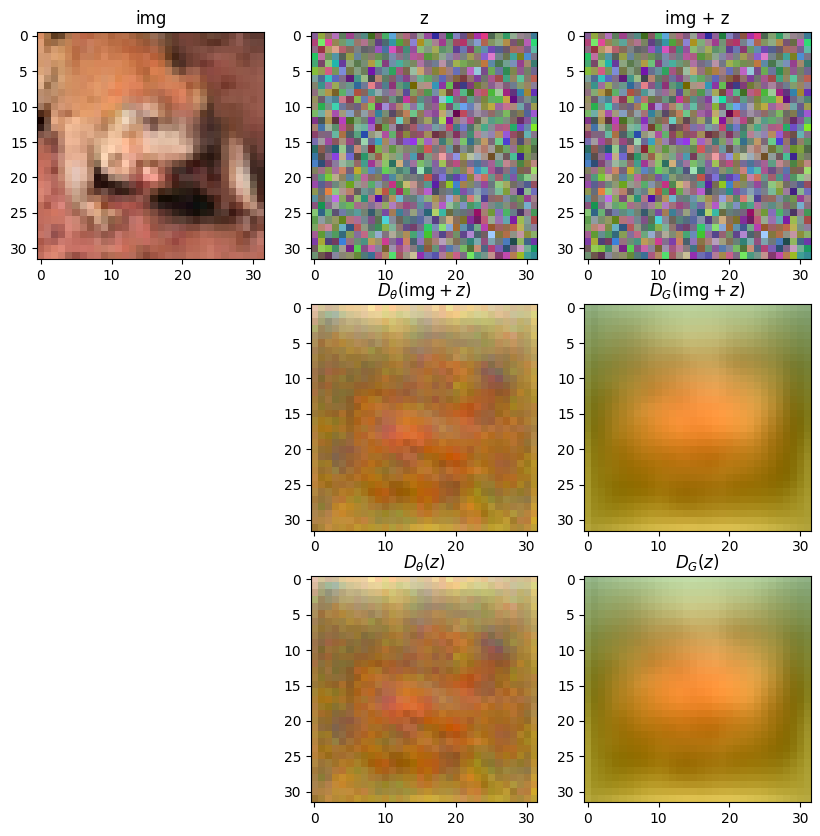

idx: 6


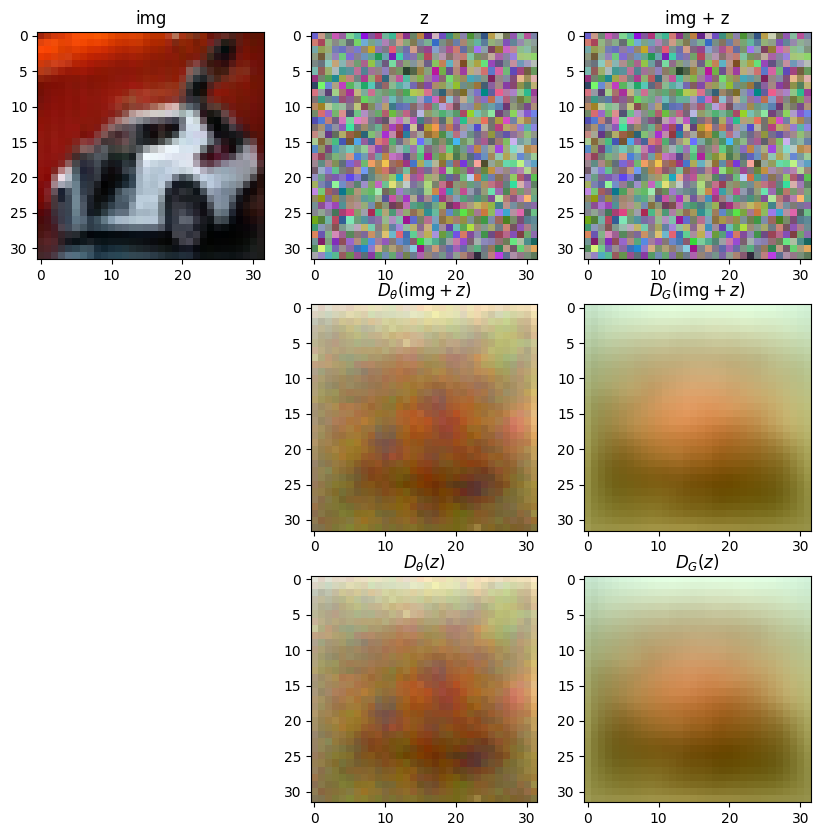

idx: 7


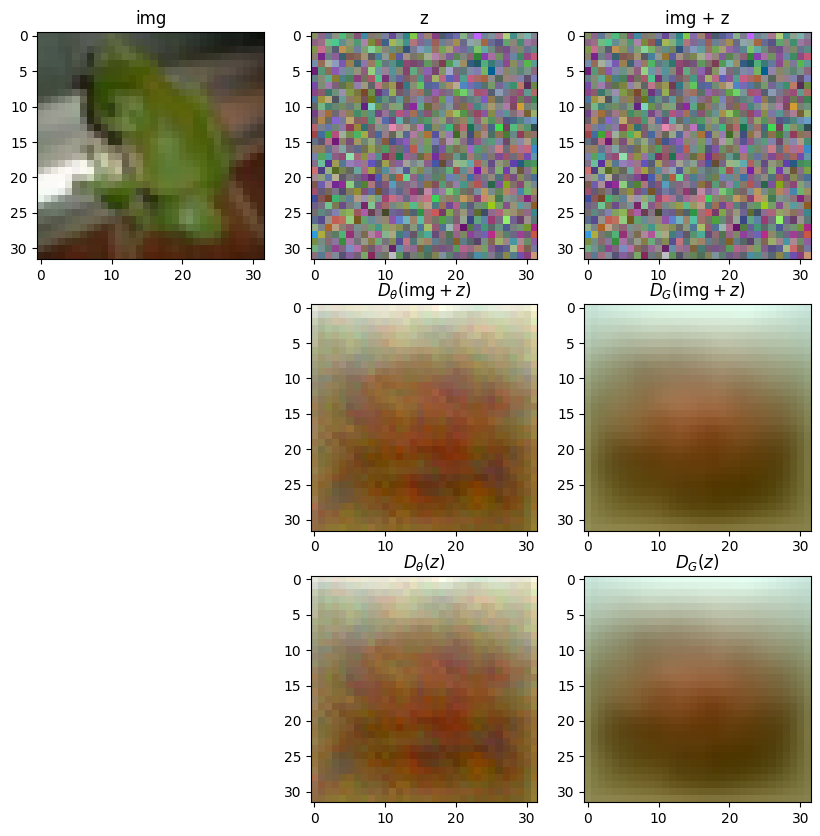

idx: 8


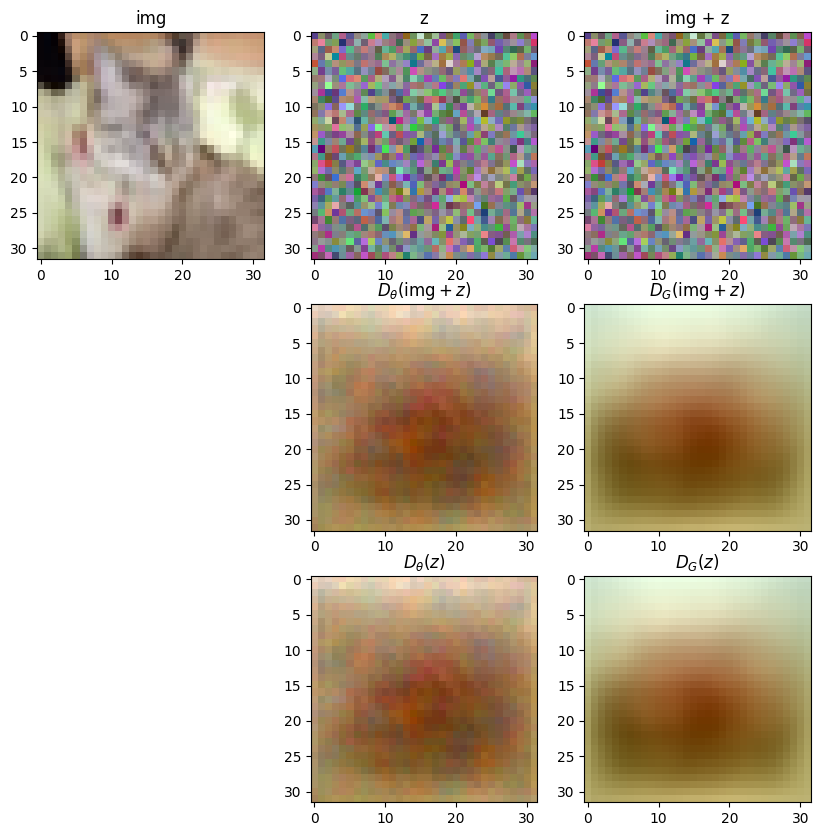

idx: 9


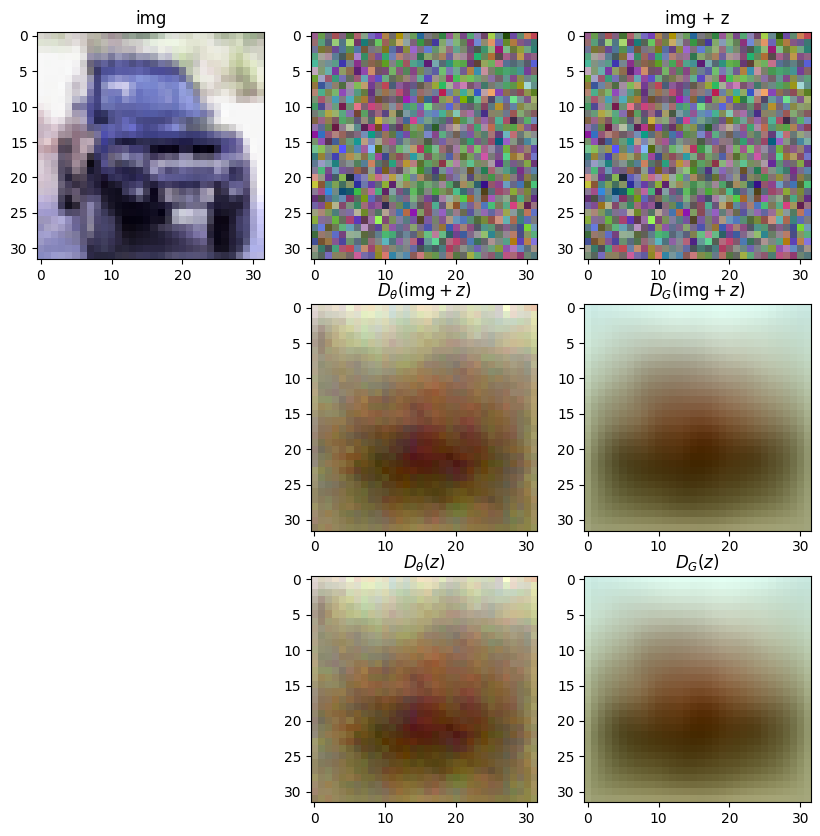

In [50]:
num_img = 10
sigma = 80.0
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 40

idx: 0


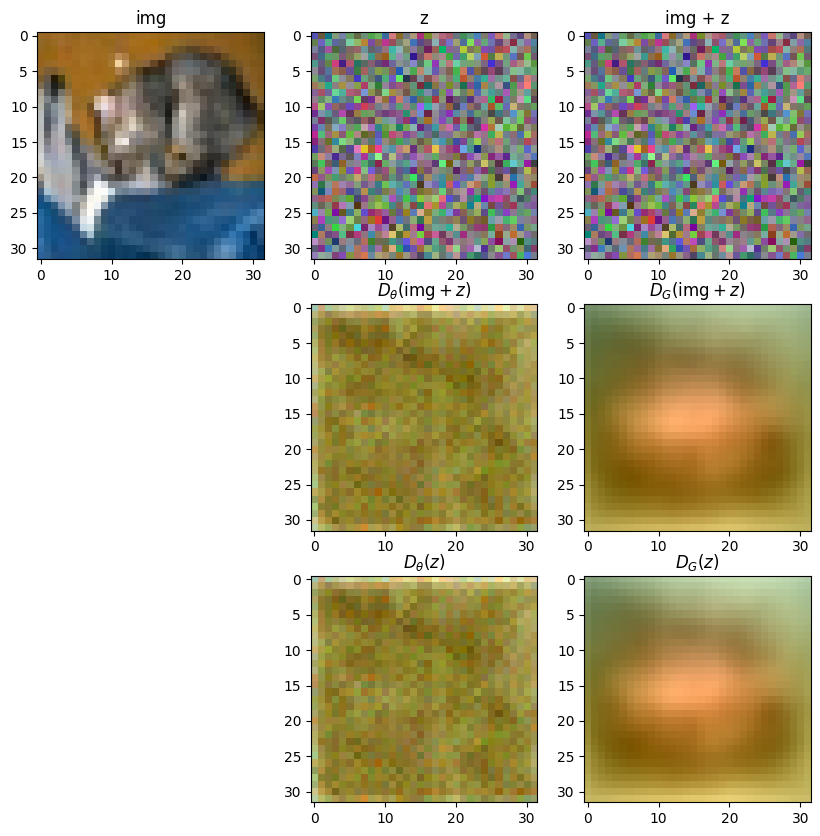

idx: 1


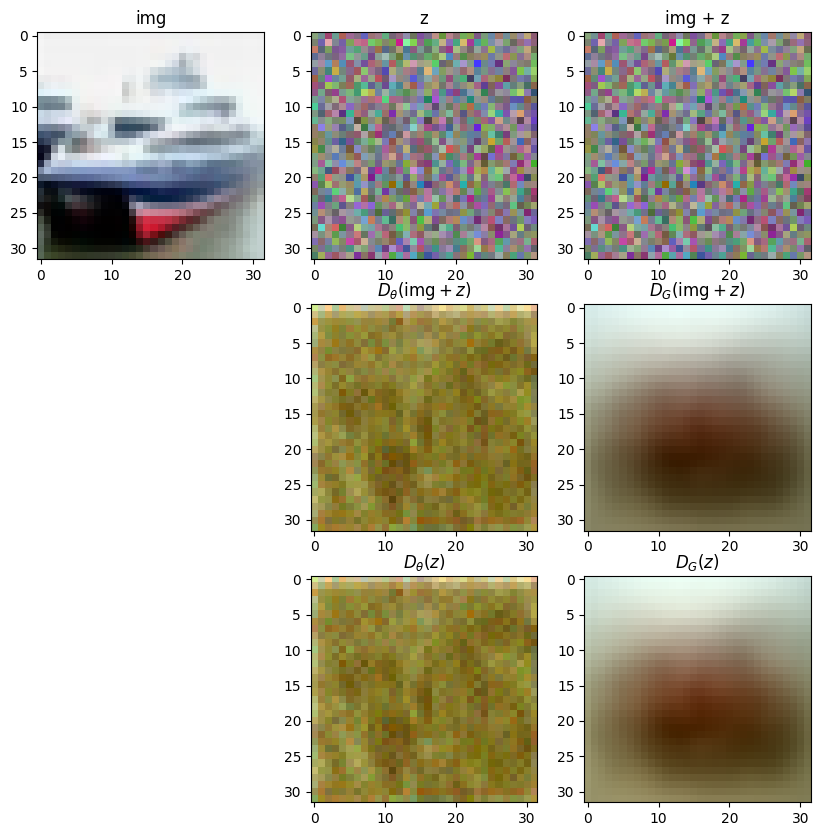

idx: 2


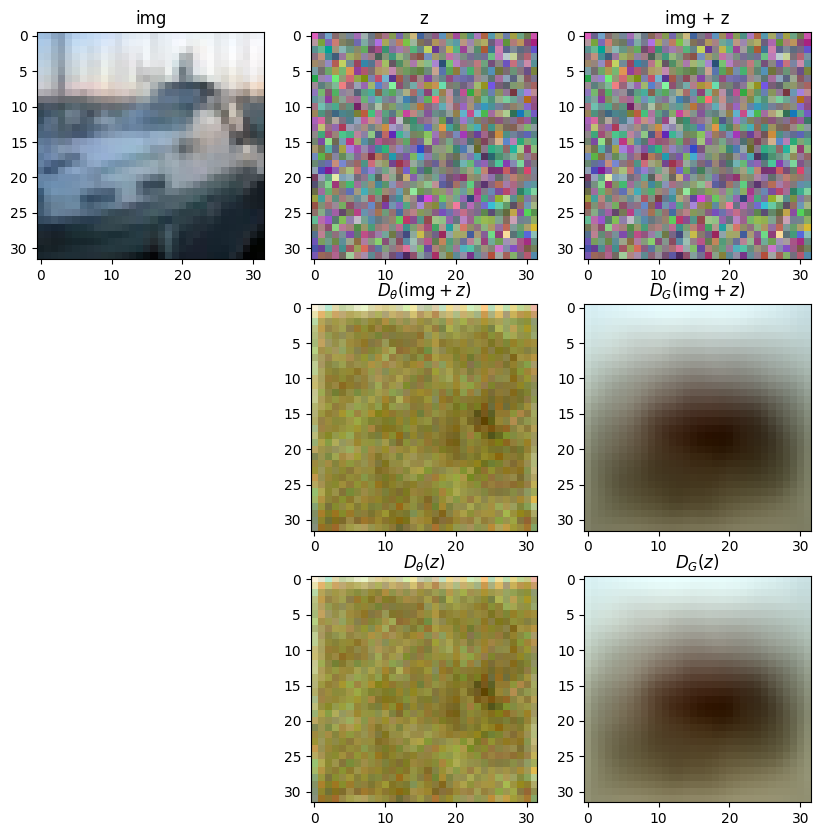

idx: 3


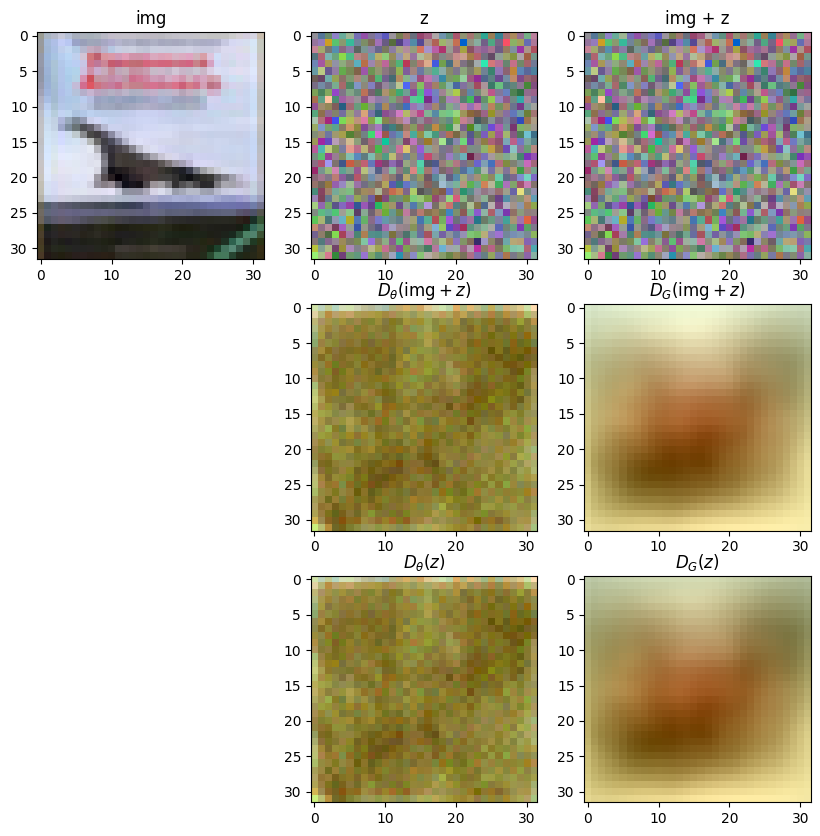

idx: 4


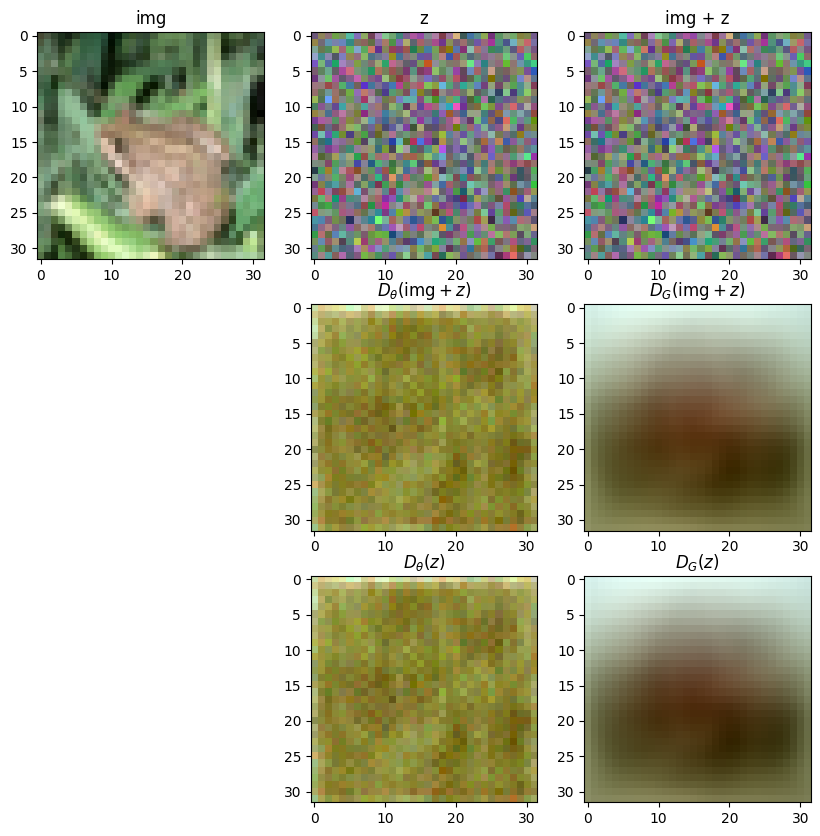

idx: 5


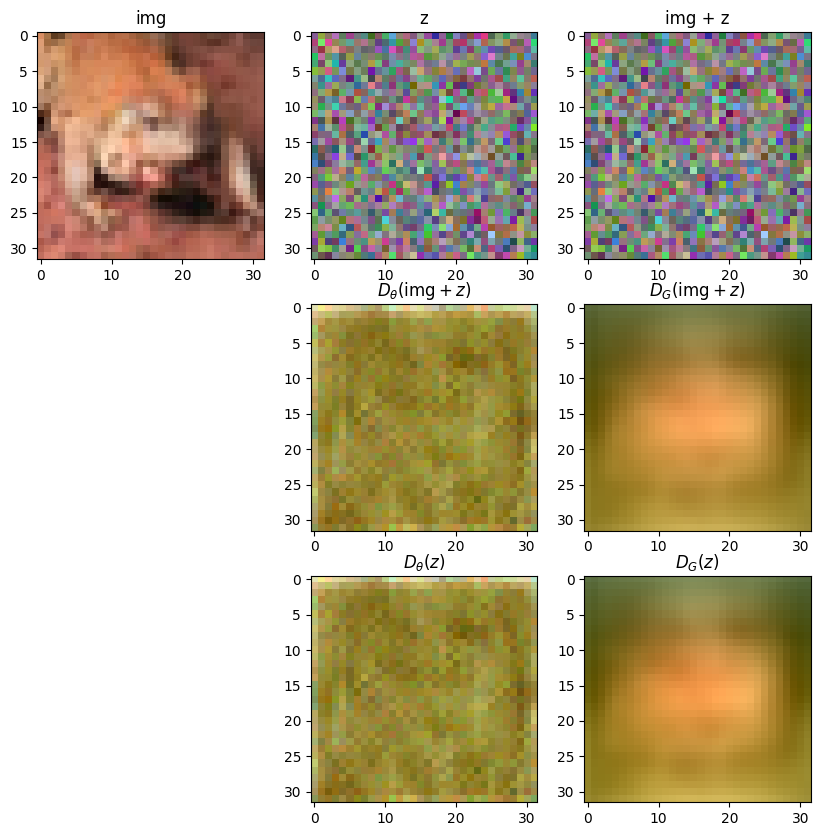

idx: 6


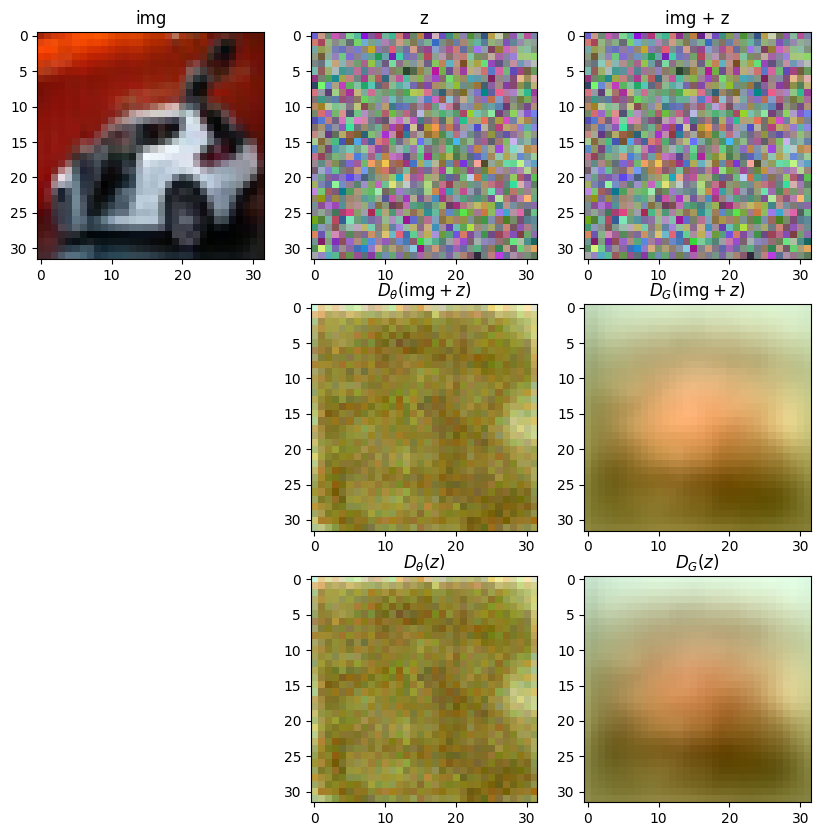

idx: 7


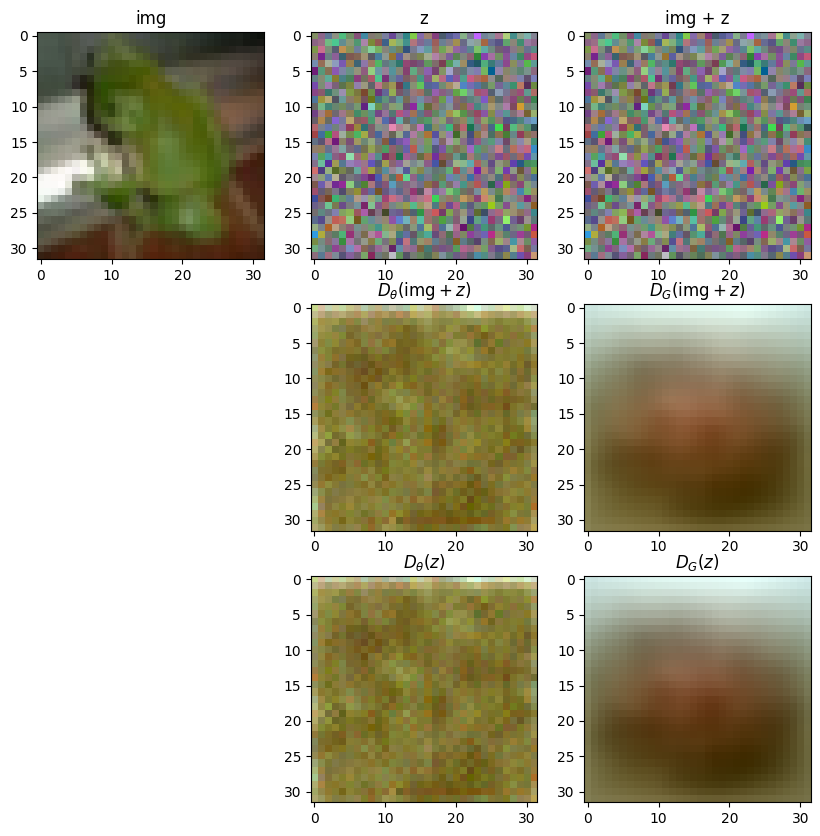

idx: 8


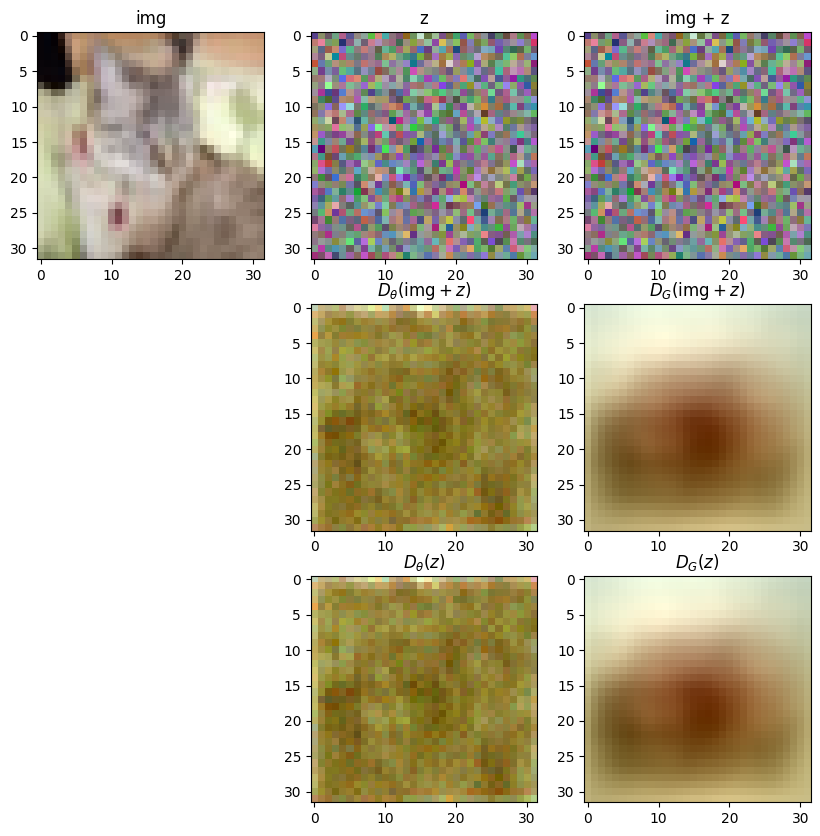

idx: 9


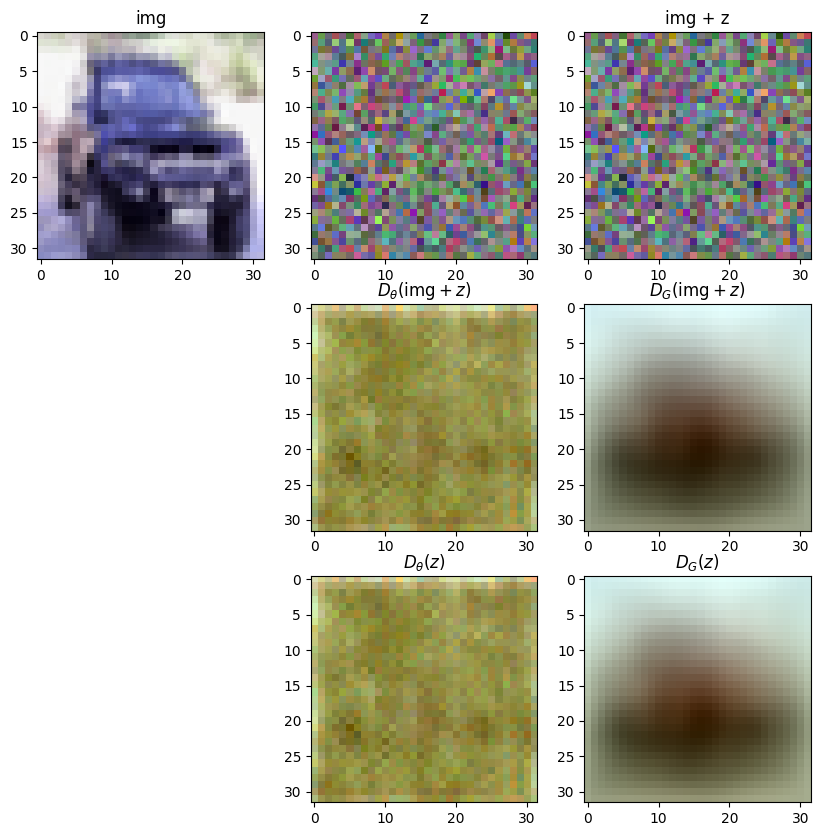

In [51]:
num_img = 10
sigma = 42.415189318512674
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 21

idx: 0


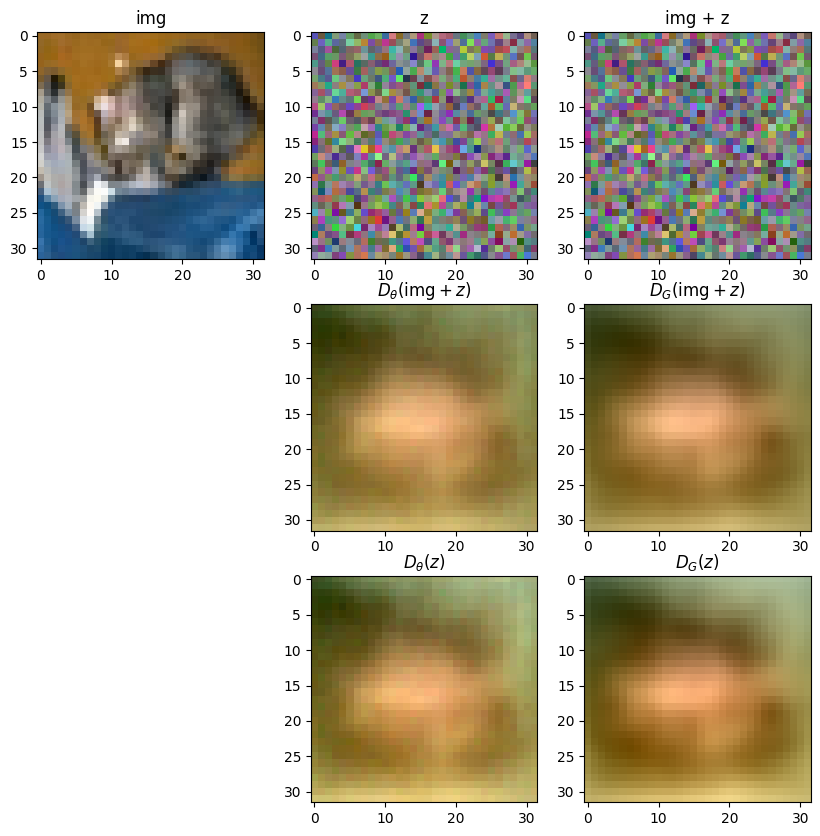

idx: 1


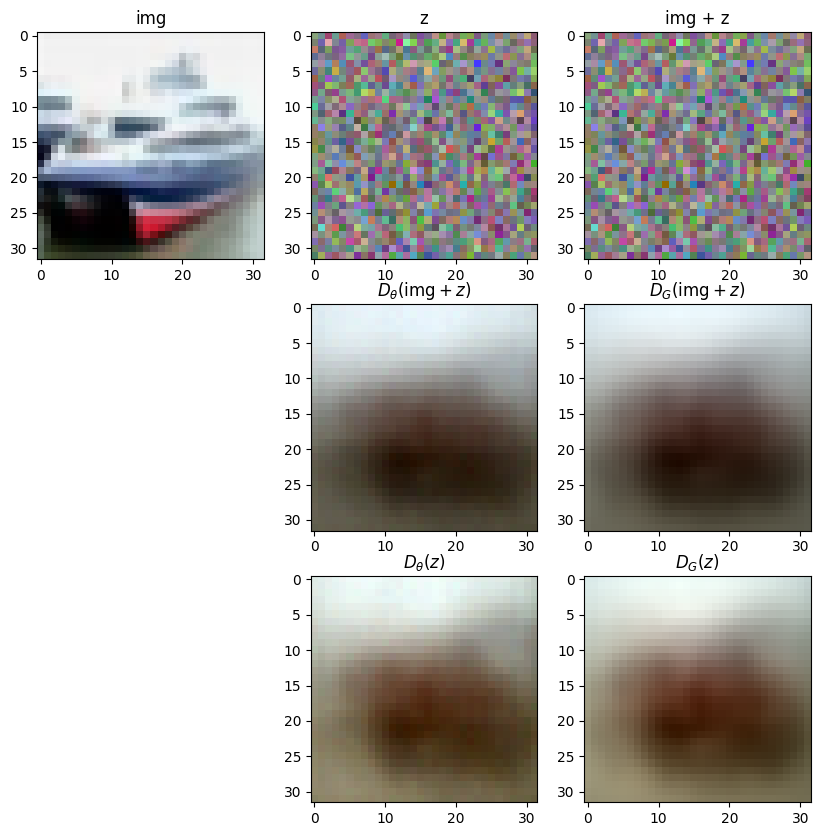

idx: 2


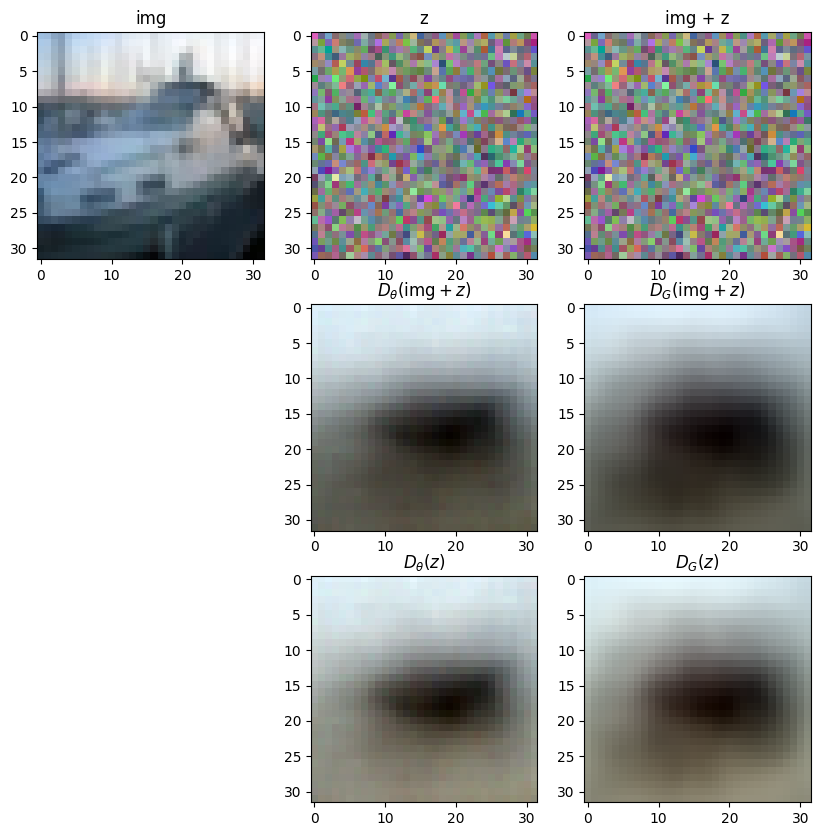

idx: 3


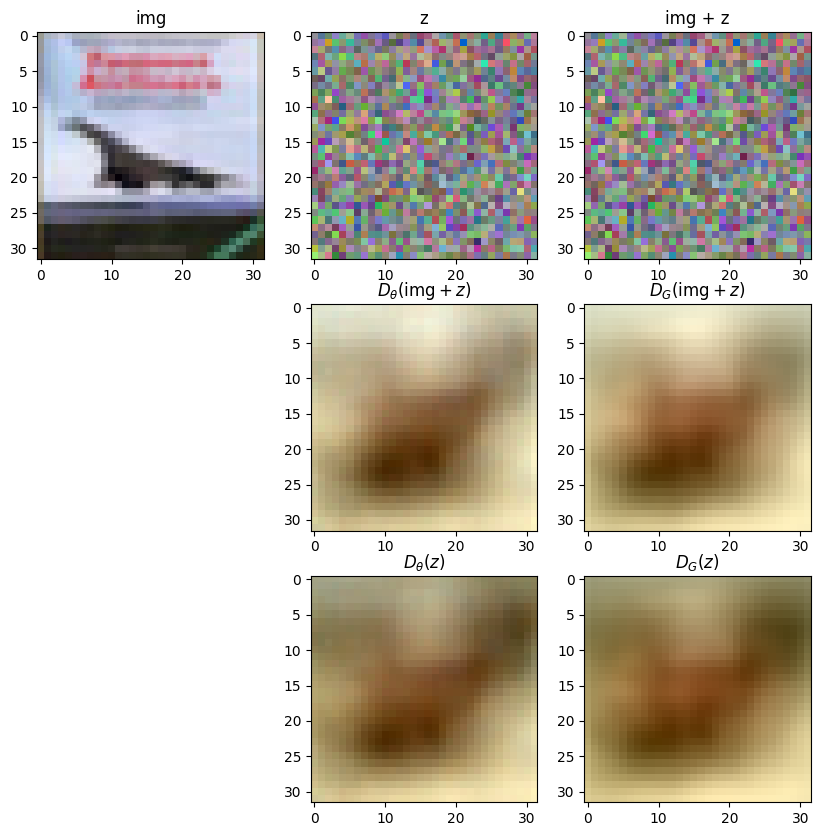

idx: 4


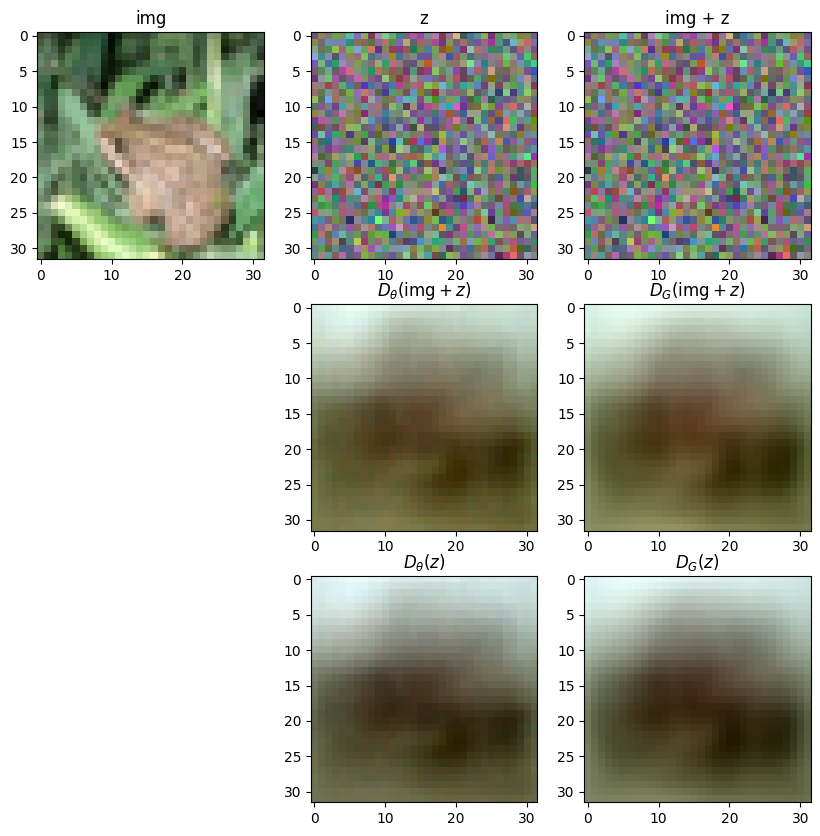

idx: 5


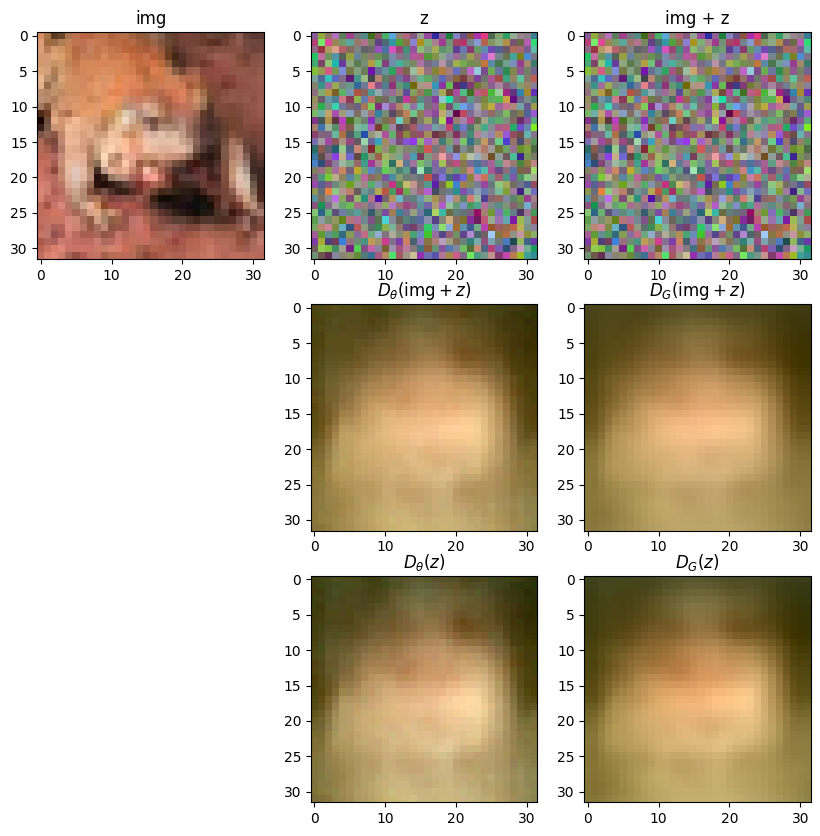

idx: 6


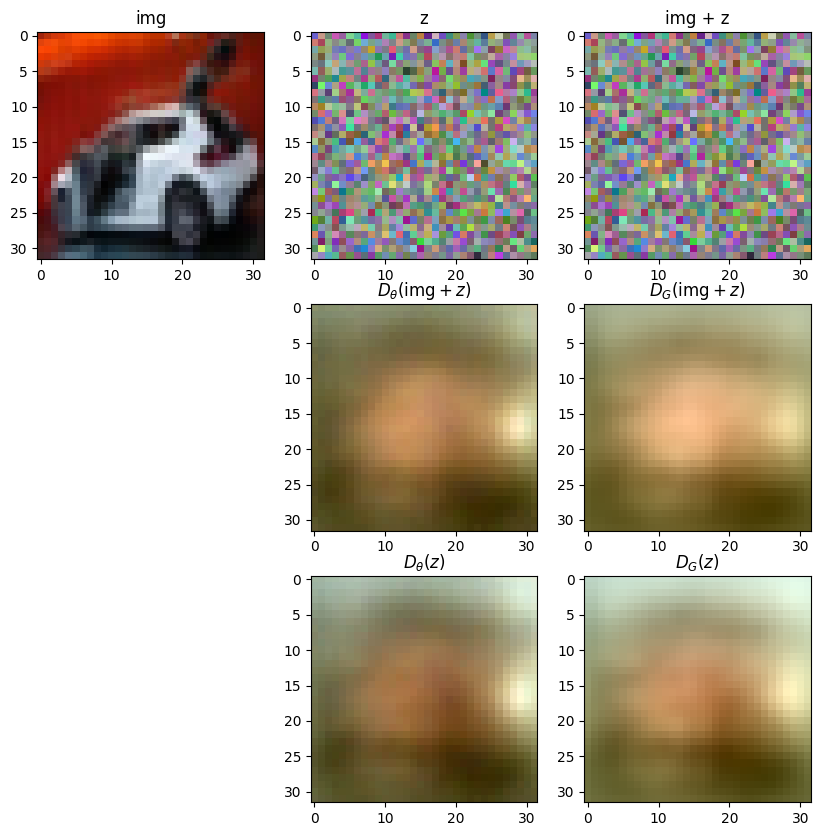

idx: 7


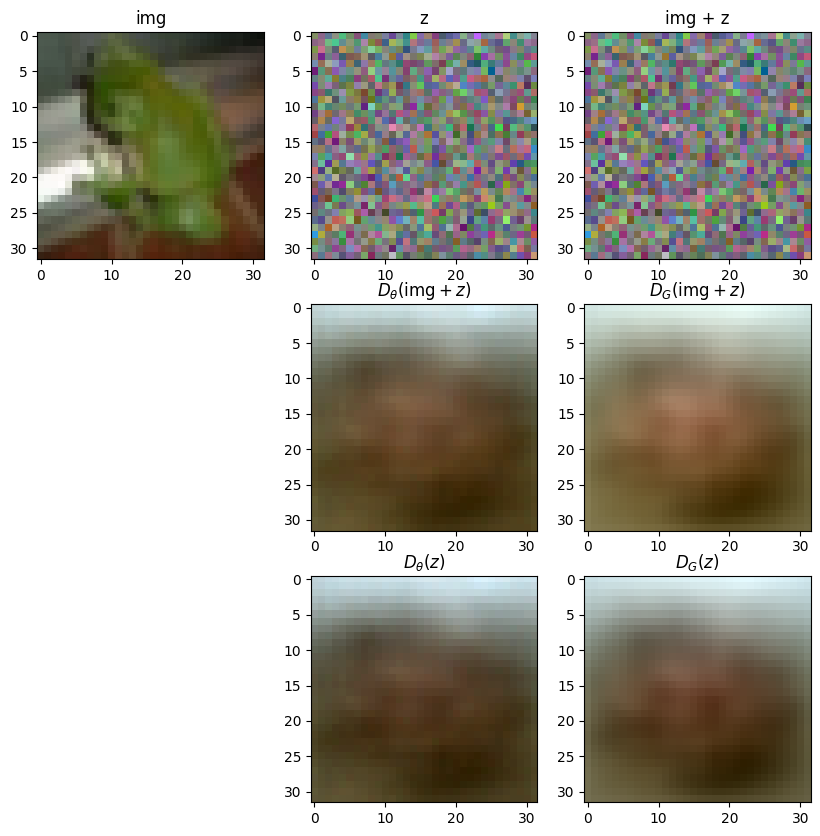

idx: 8


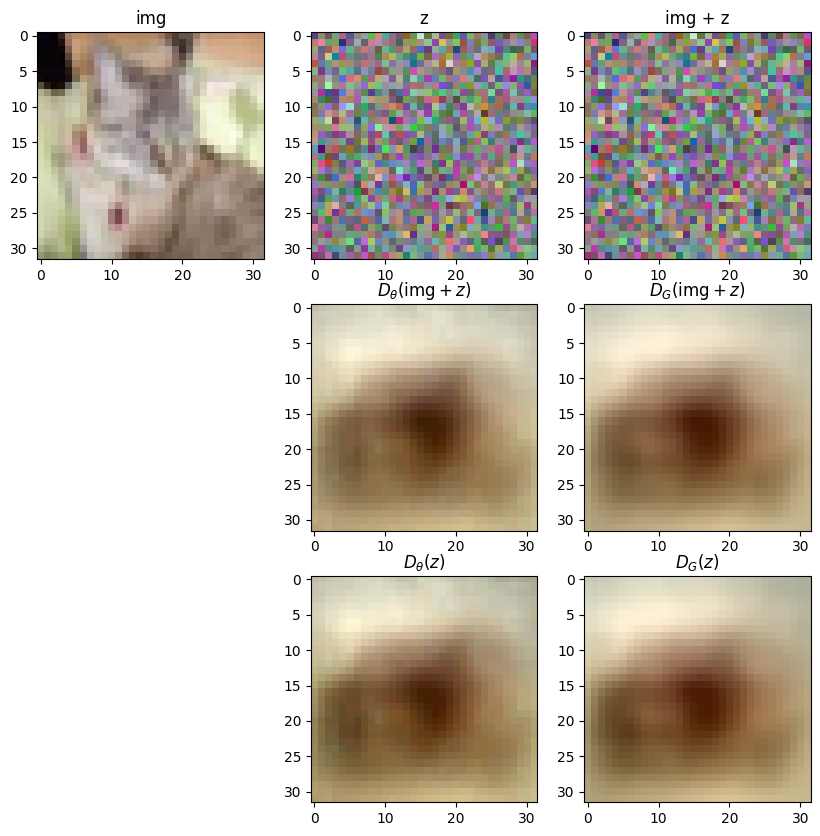

idx: 9


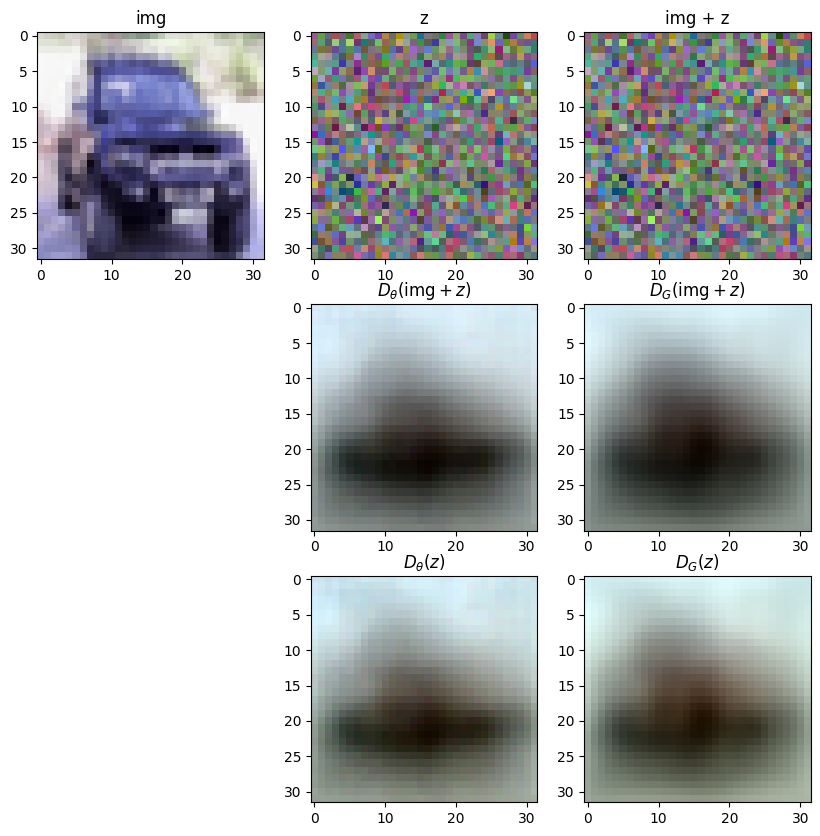

In [52]:
num_img = 10
sigma = 21.10867673619376
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 9

idx: 0


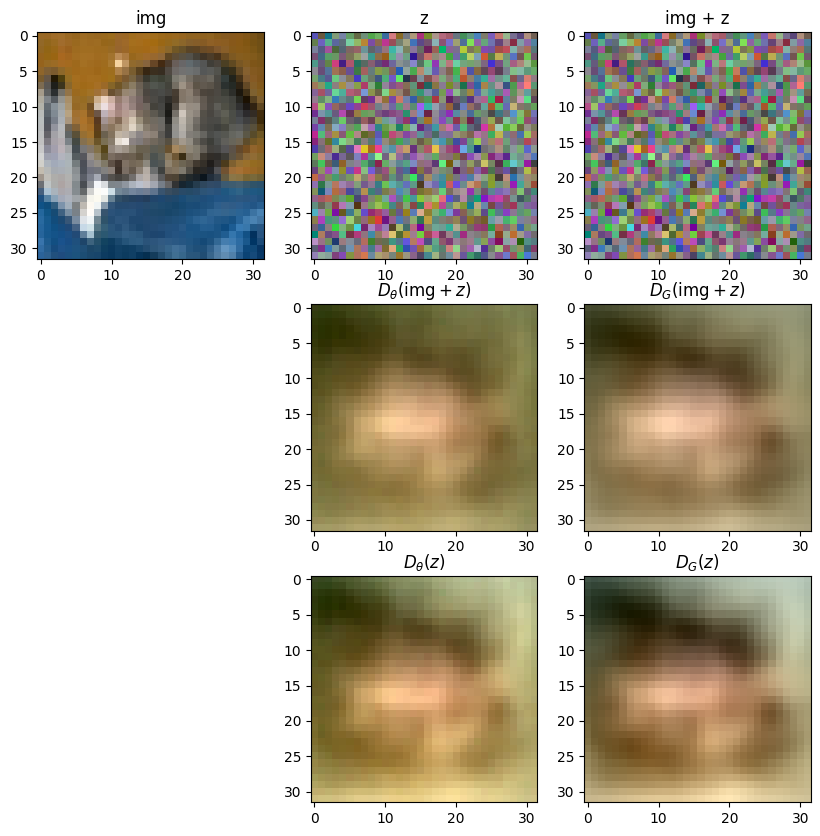

idx: 1


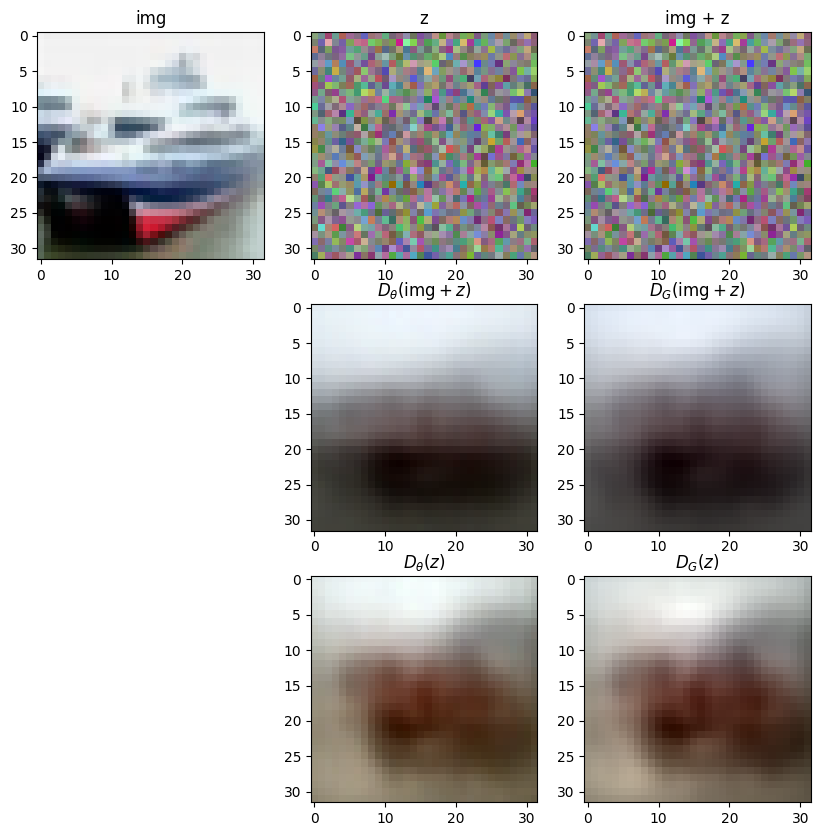

idx: 2


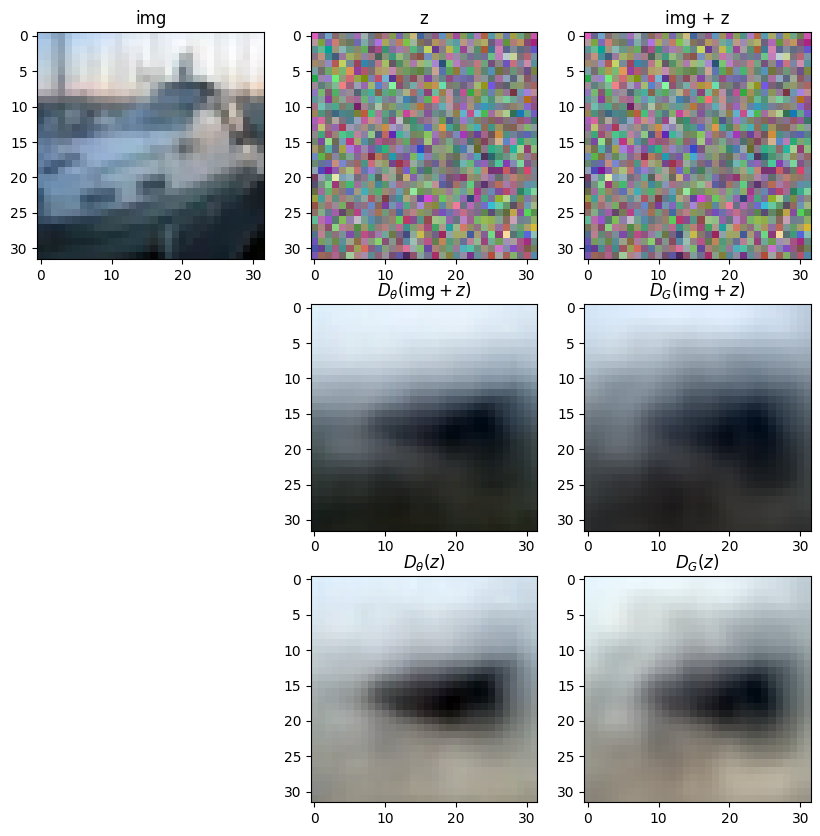

idx: 3


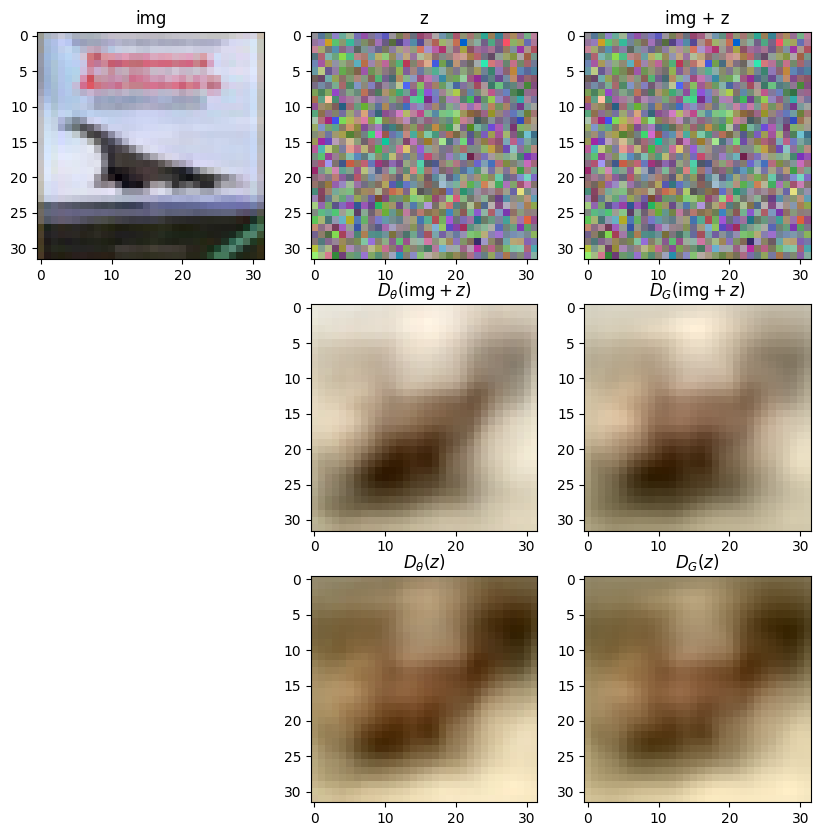

idx: 4


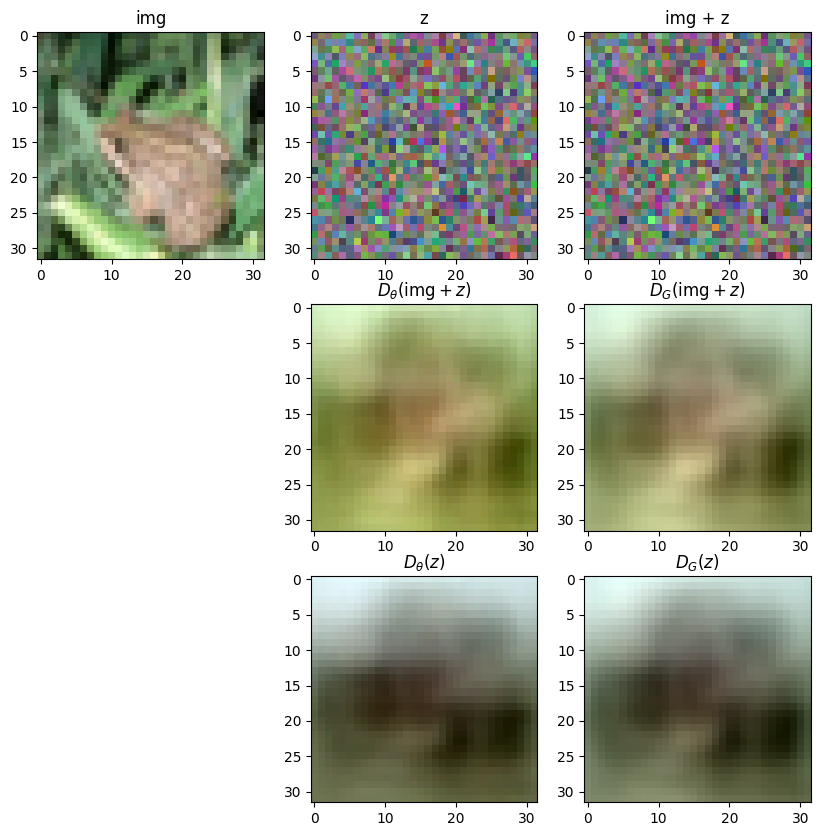

idx: 5


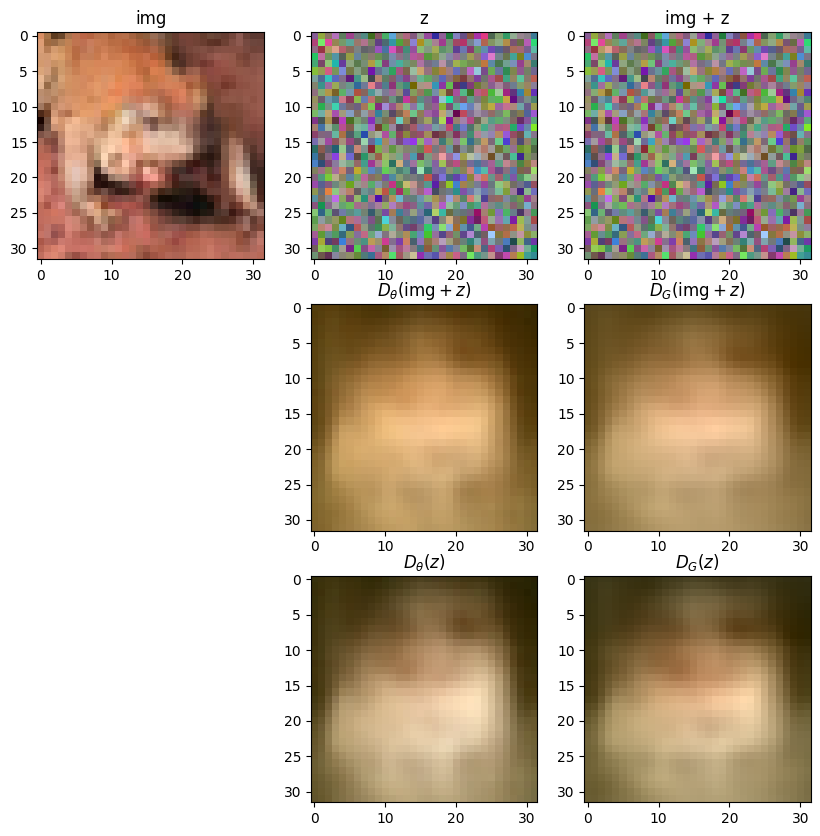

idx: 6


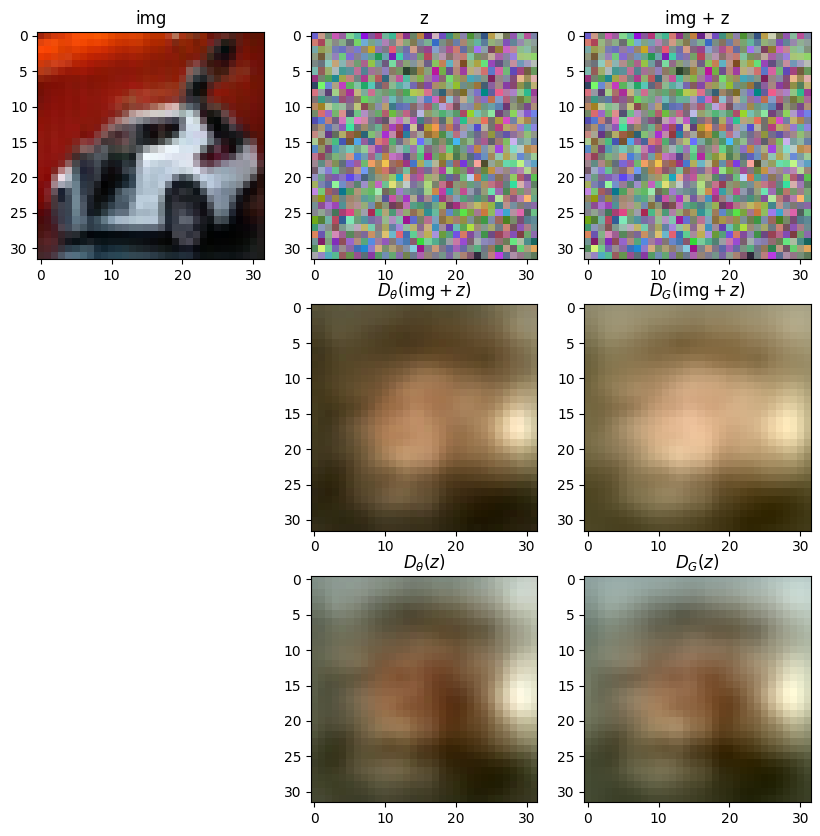

idx: 7


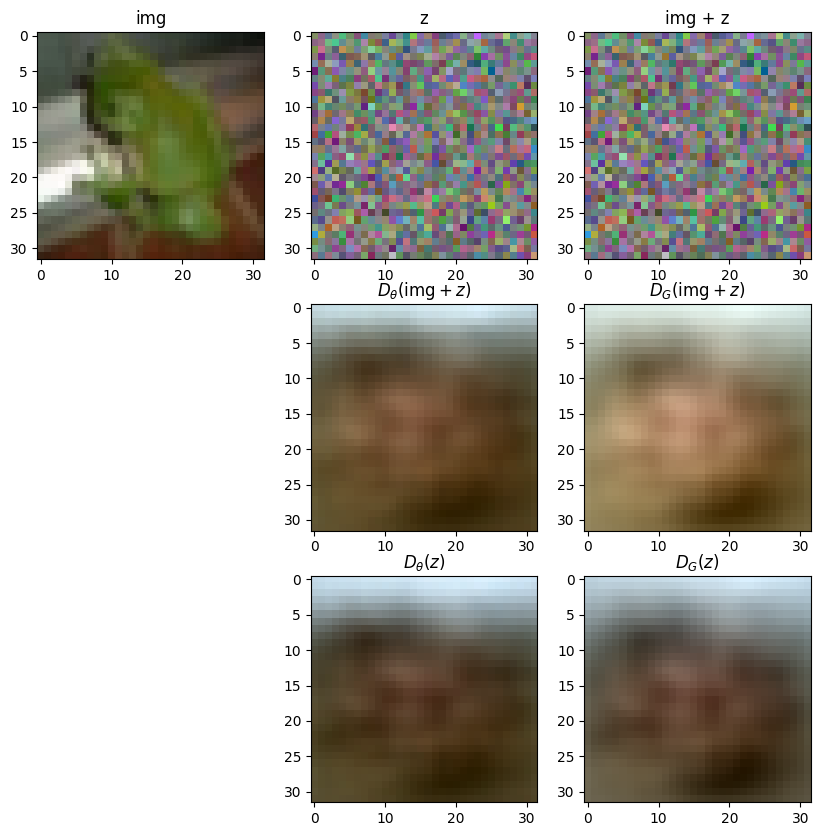

idx: 8


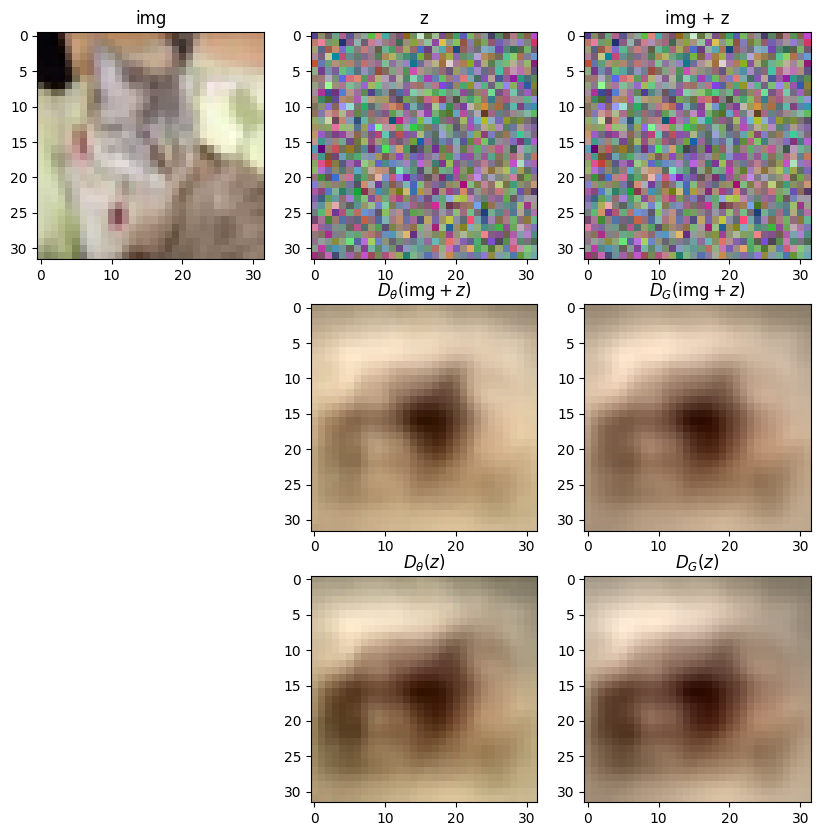

idx: 9


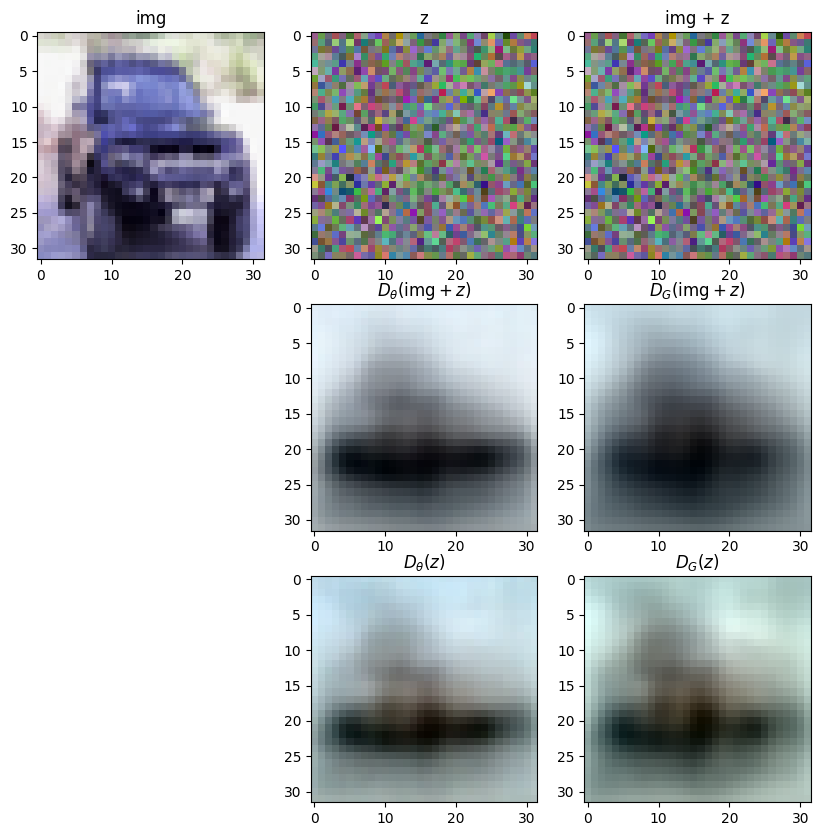

In [53]:
num_img = 10
sigma = 9.72320135526013
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 4

idx: 0


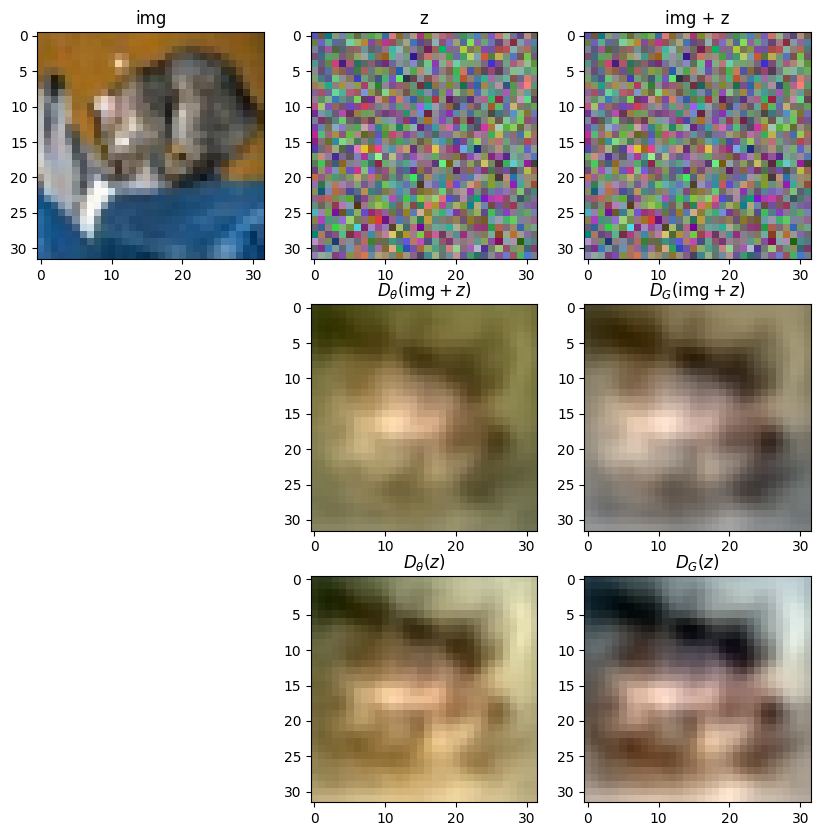

idx: 1


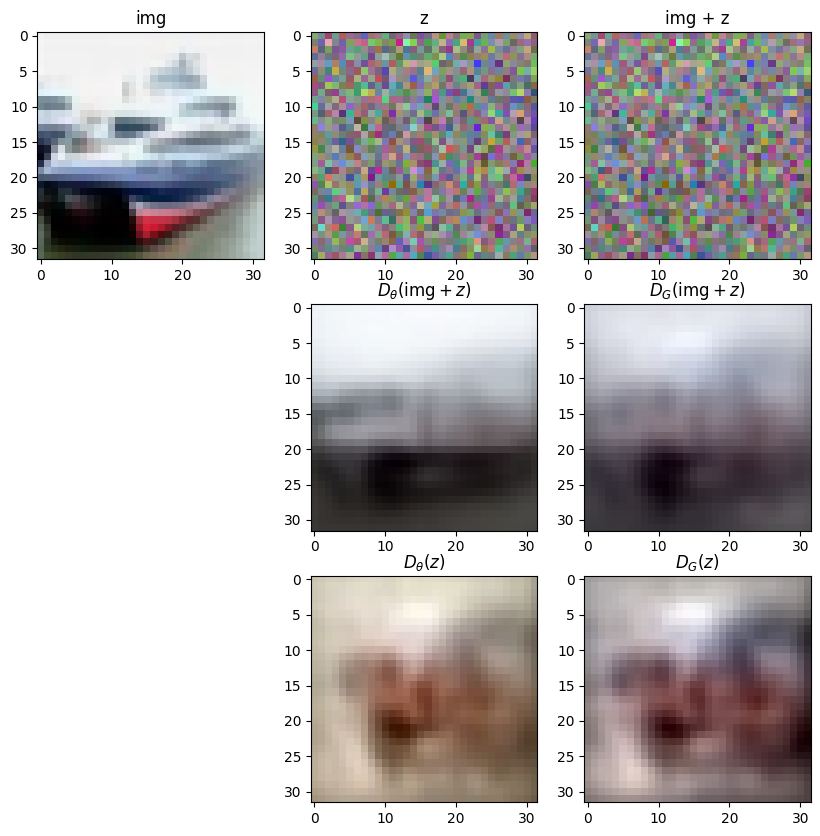

idx: 2


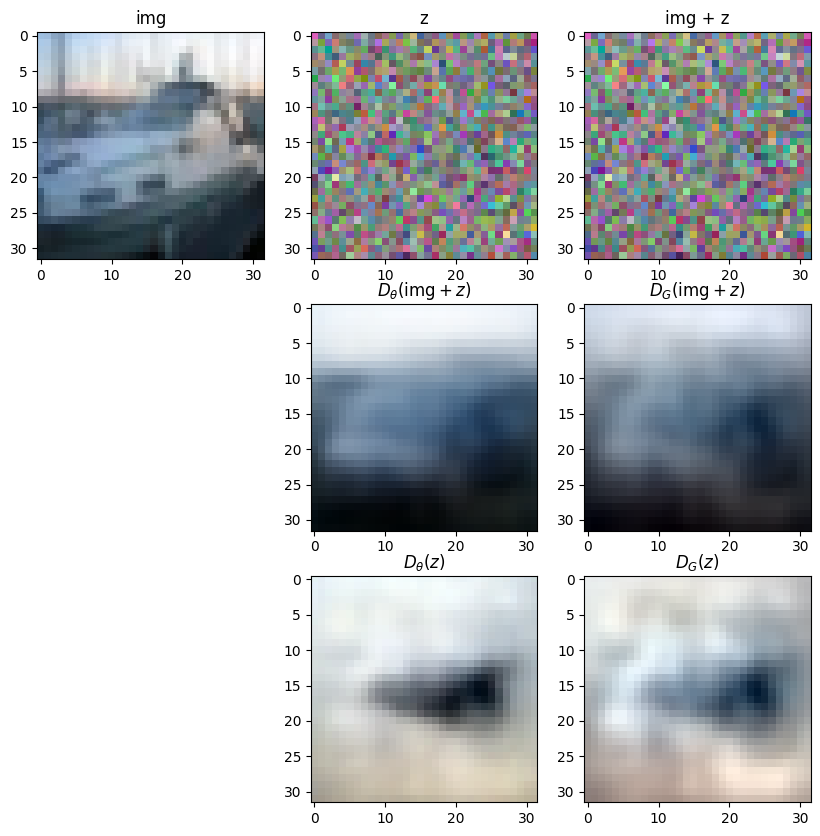

idx: 3


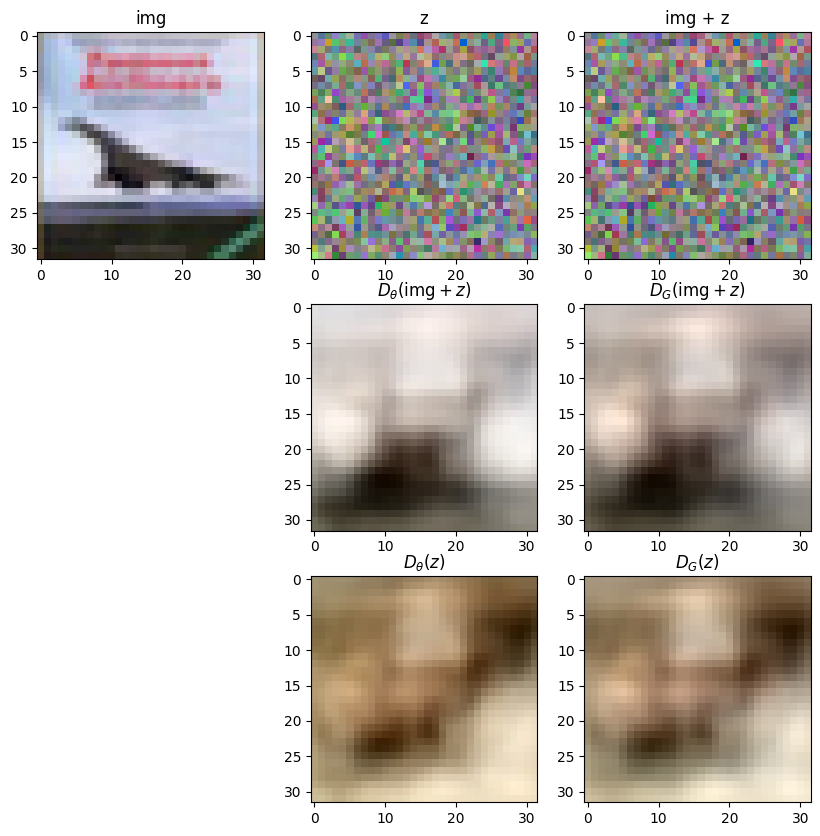

idx: 4


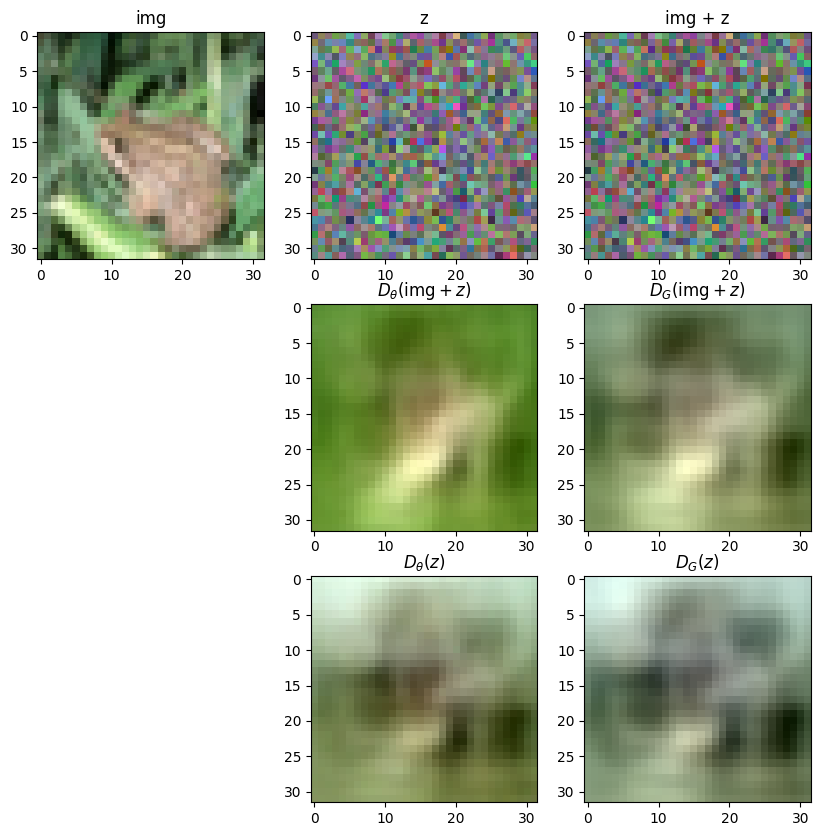

idx: 5


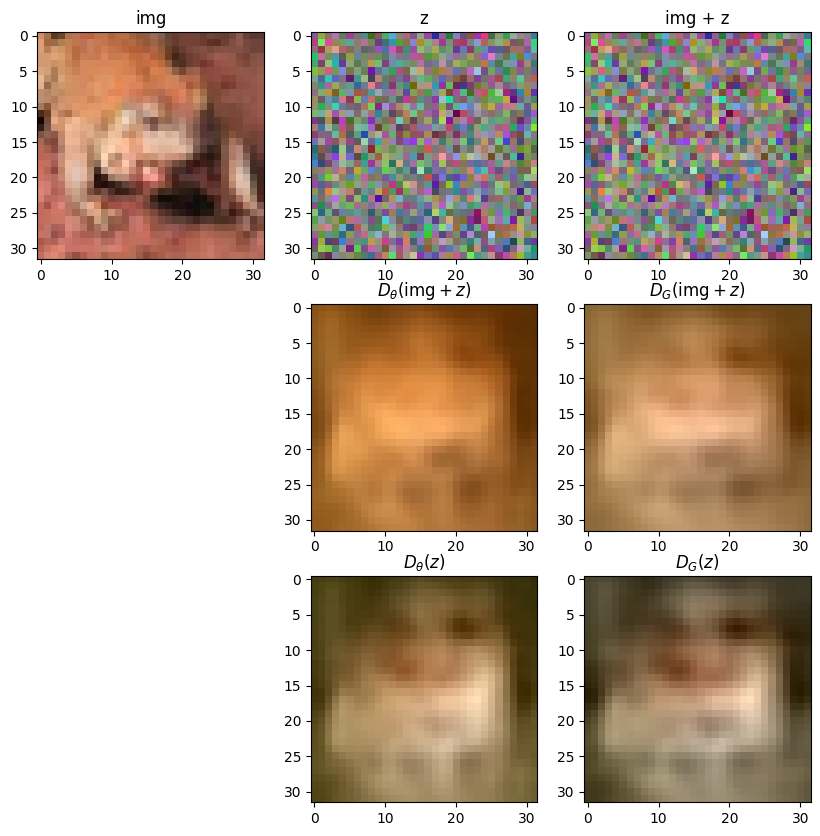

idx: 6


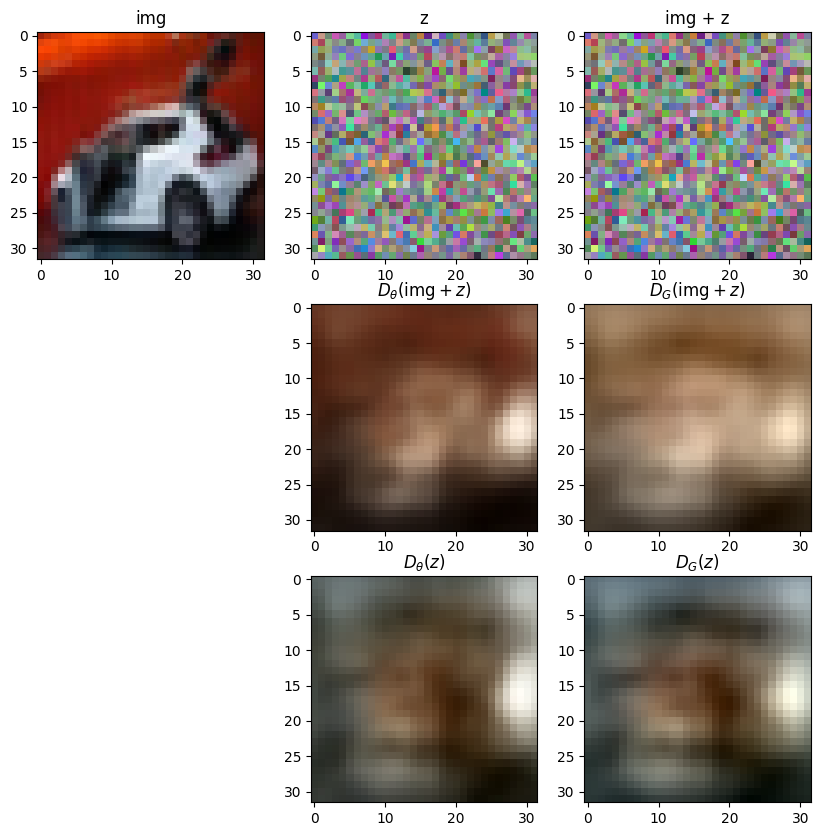

idx: 7


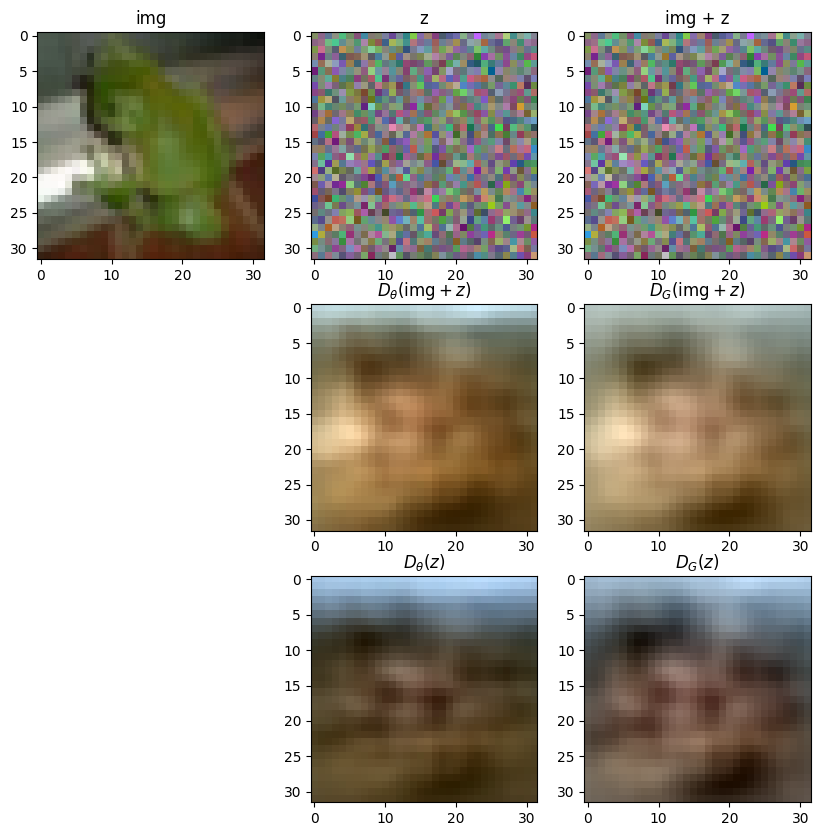

idx: 8


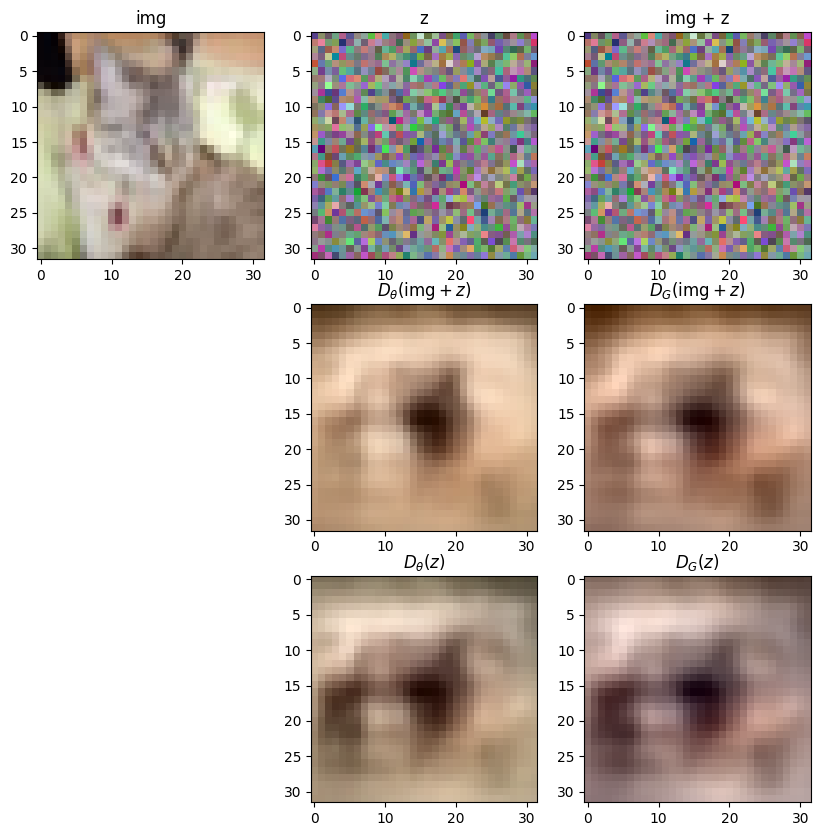

idx: 9


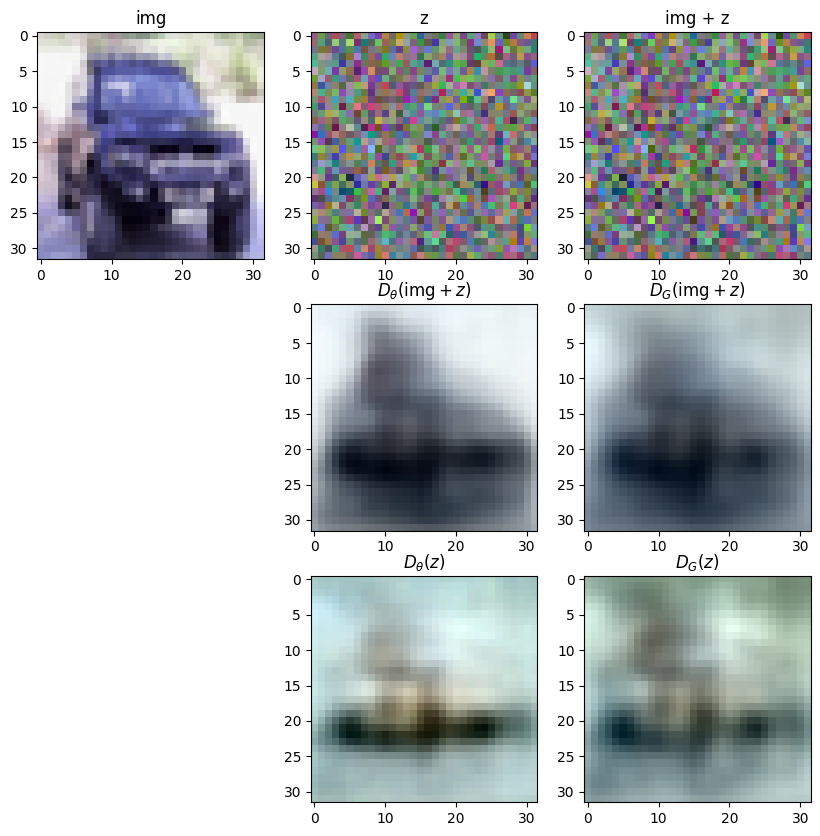

In [54]:
num_img = 10
sigma = 4.066123602953759
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 1.5

idx: 0


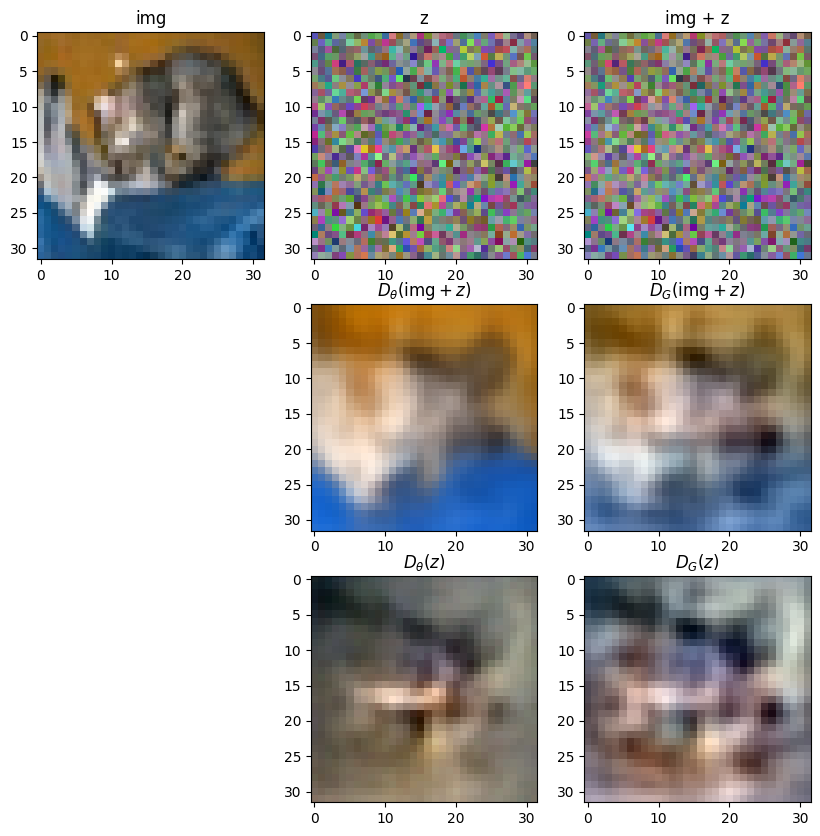

idx: 1


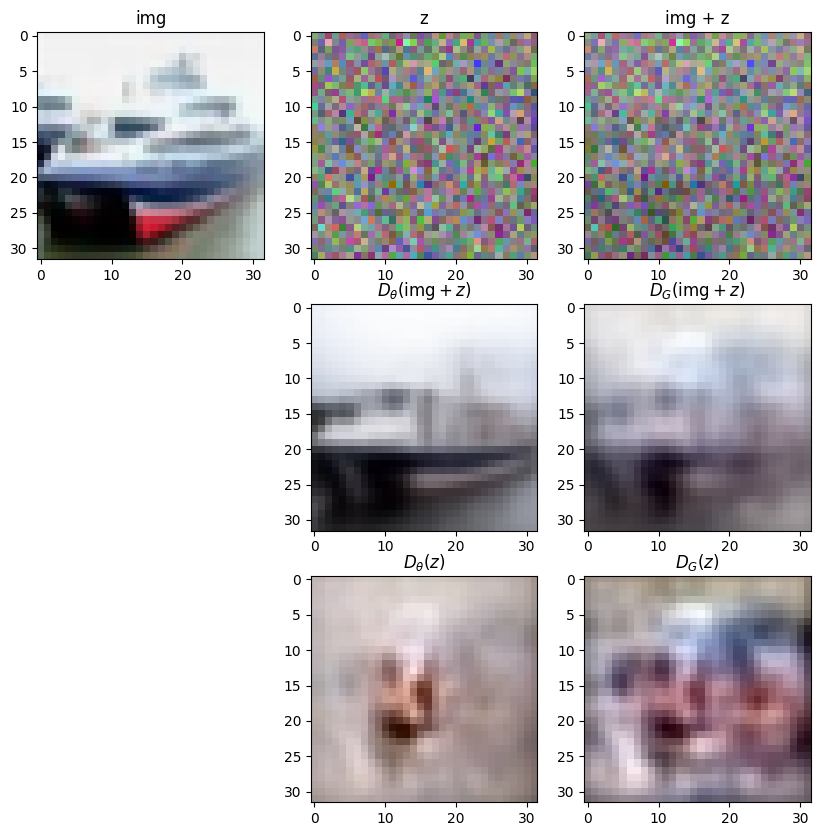

idx: 2


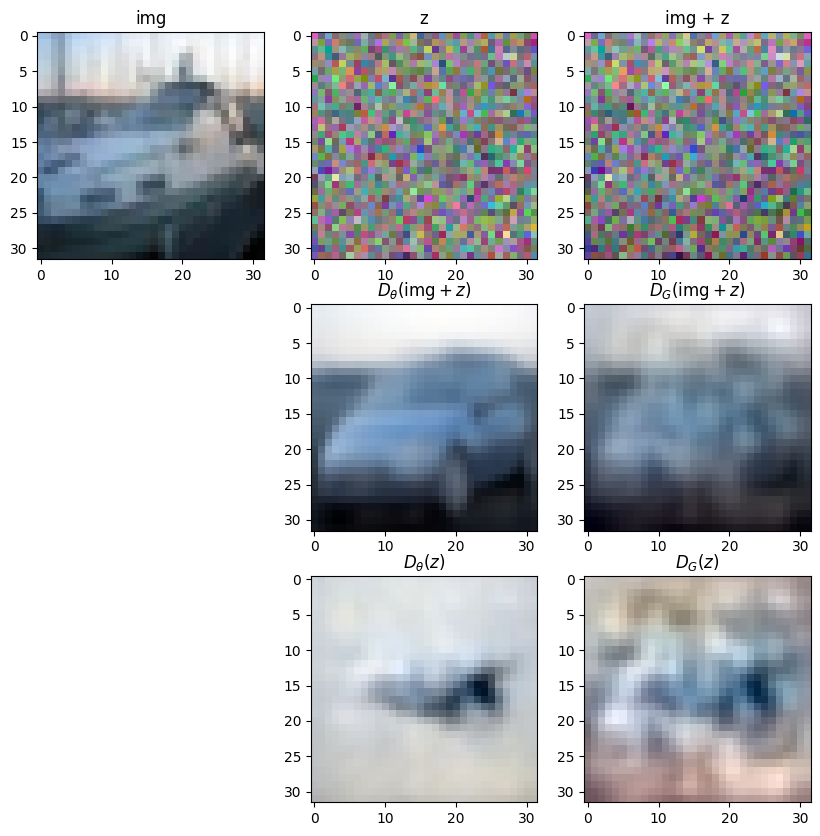

idx: 3


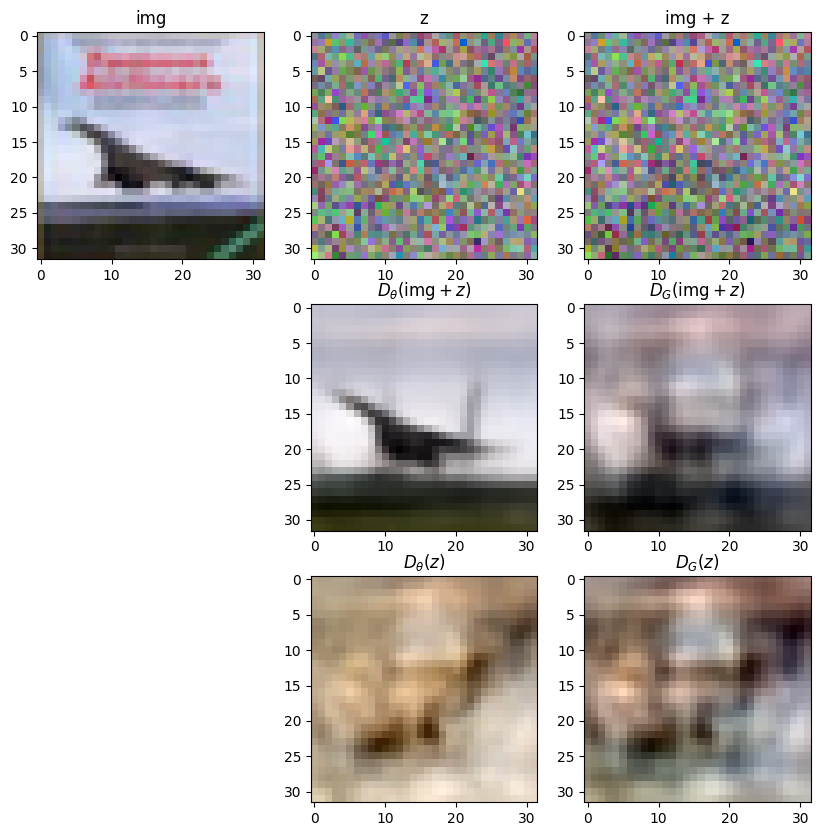

idx: 4


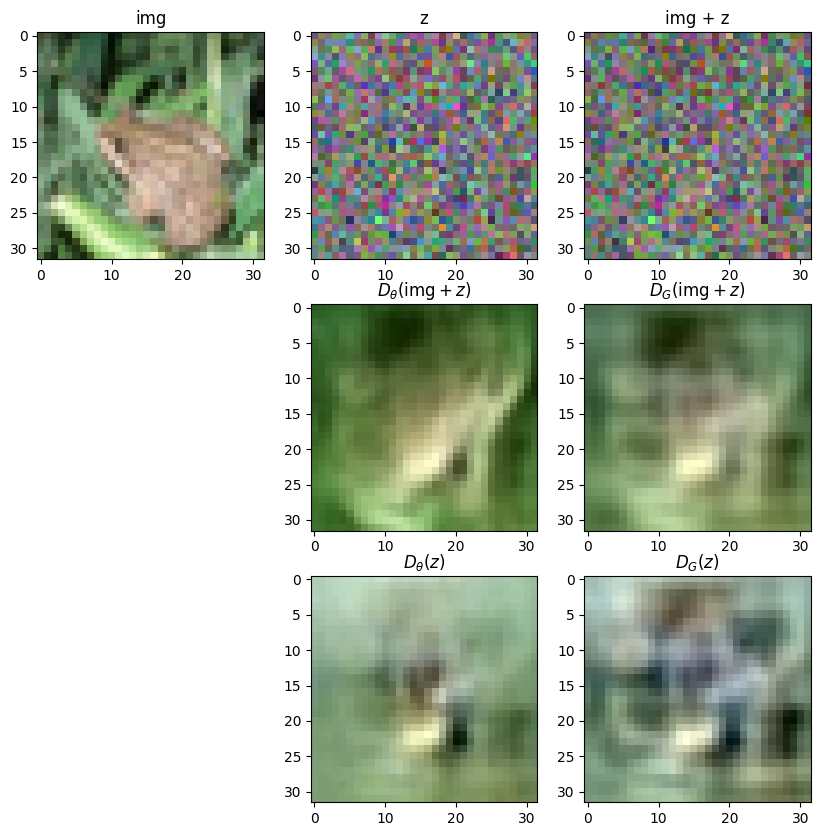

idx: 5


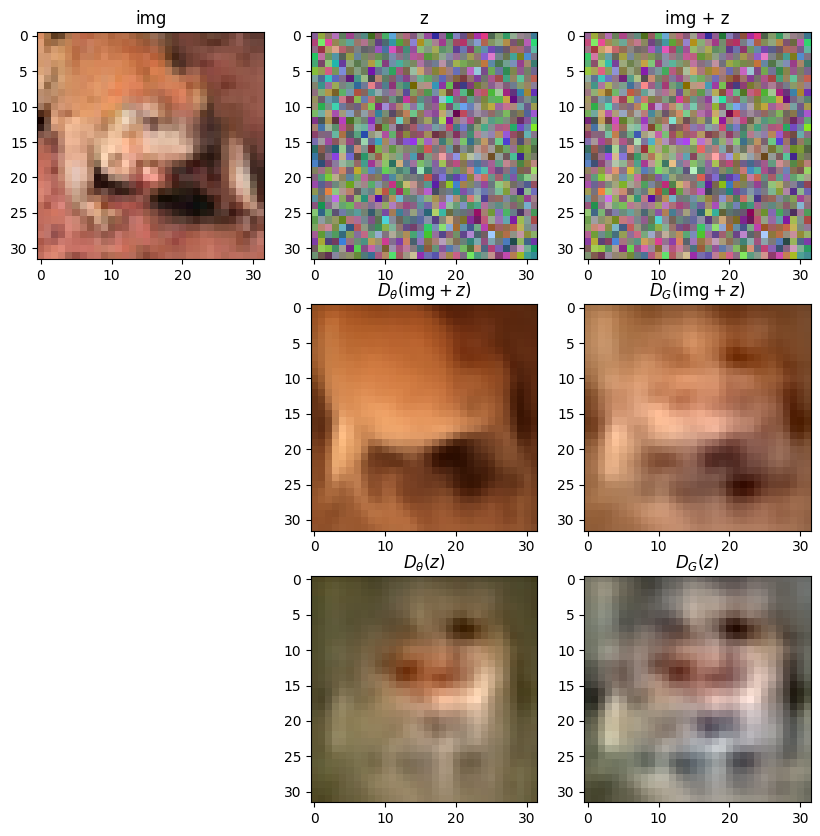

idx: 6


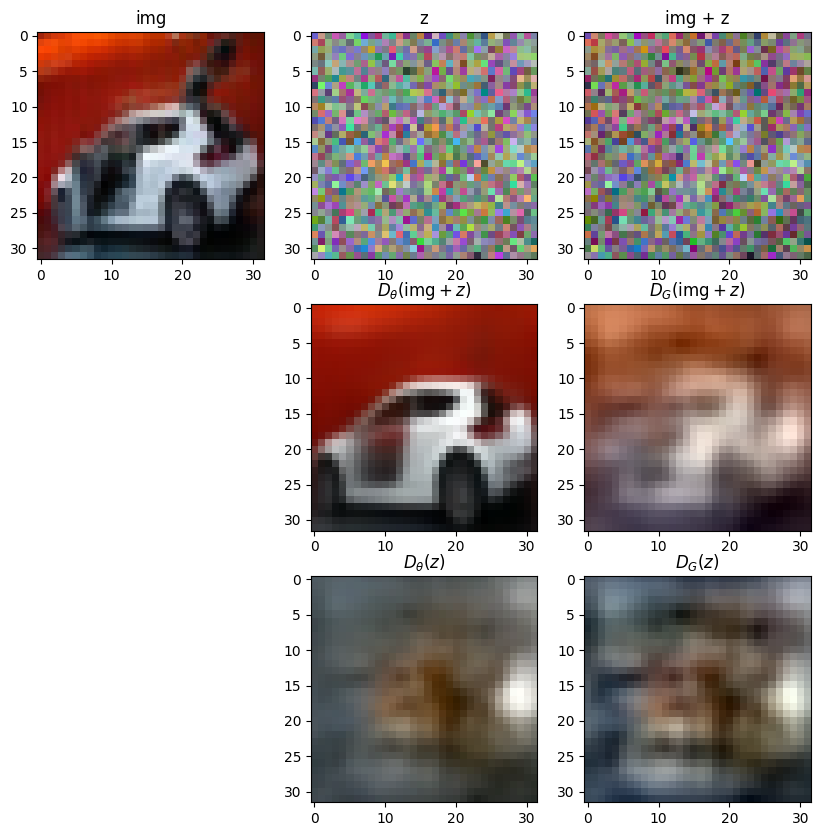

idx: 7


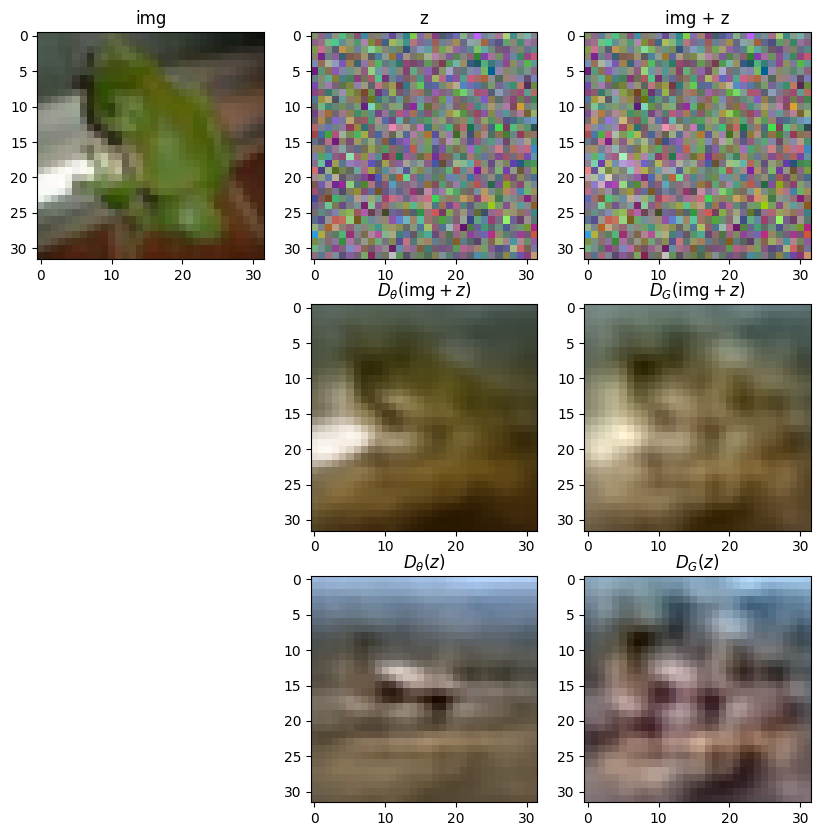

idx: 8


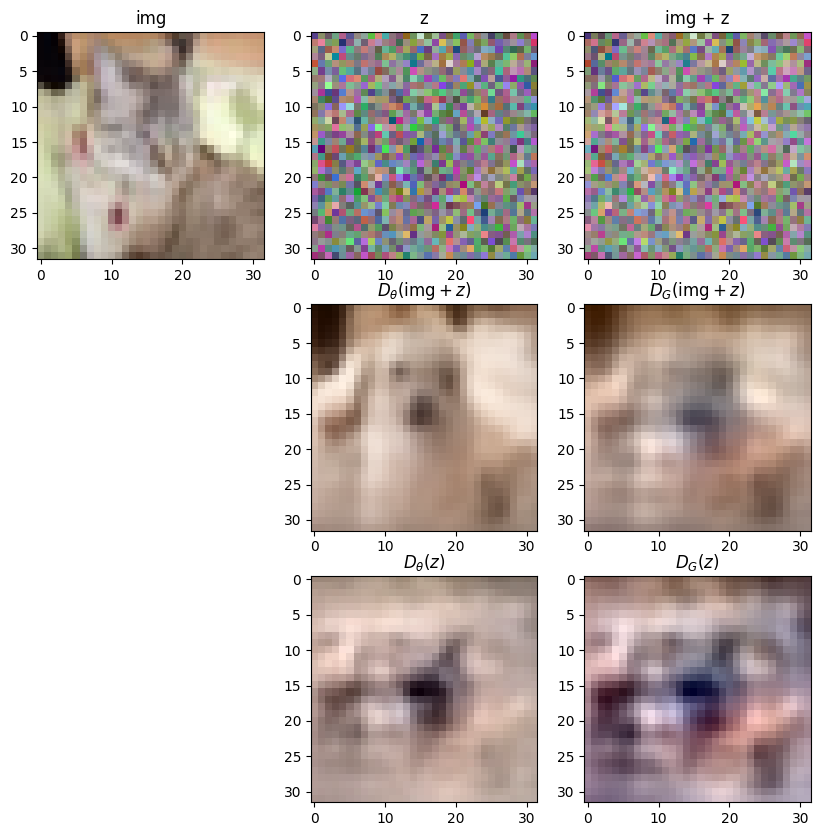

idx: 9


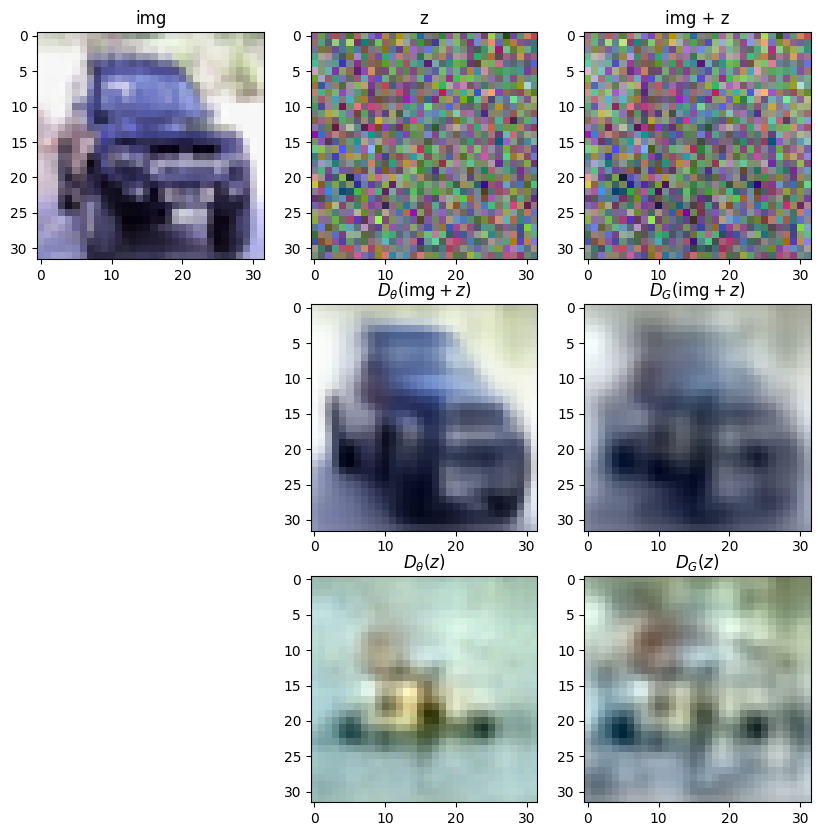

In [56]:
num_img = 10
sigma = 1.501741979068008
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 0.46

idx: 0


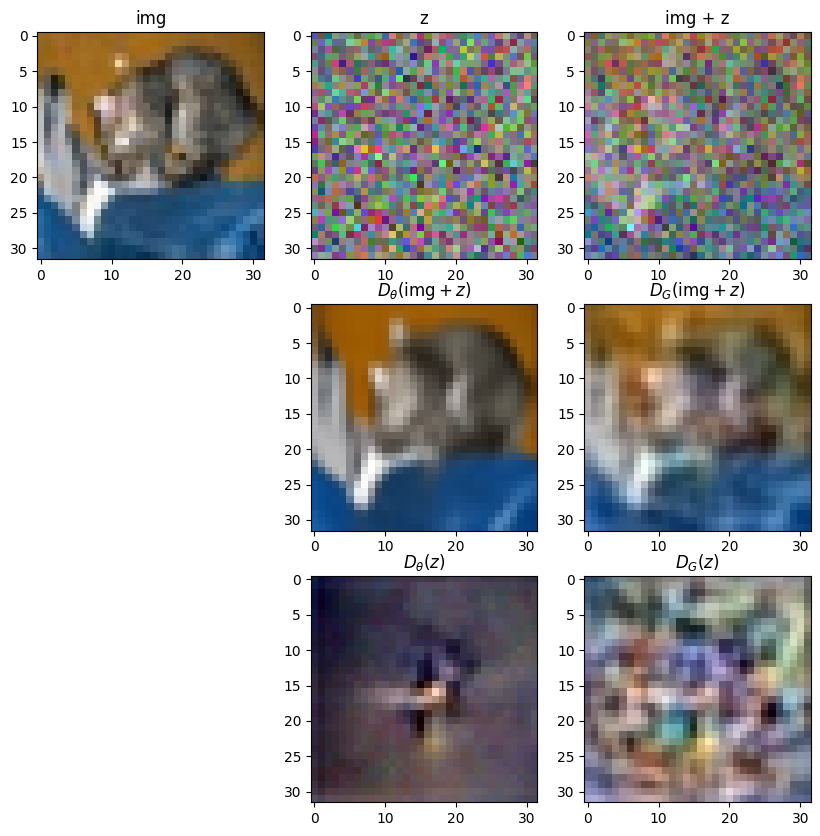

idx: 1


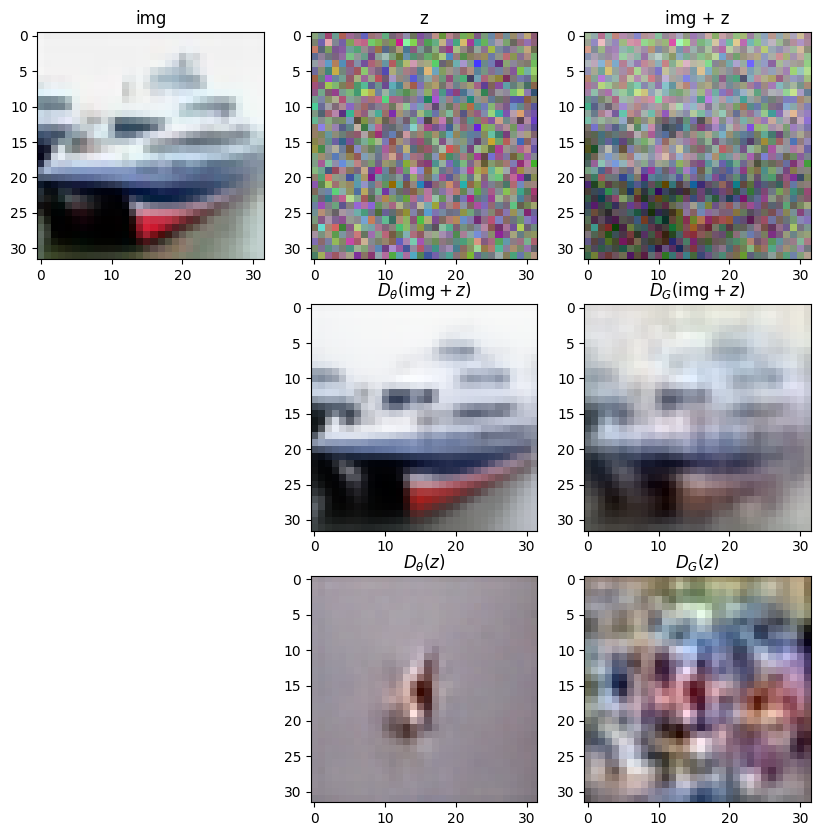

idx: 2


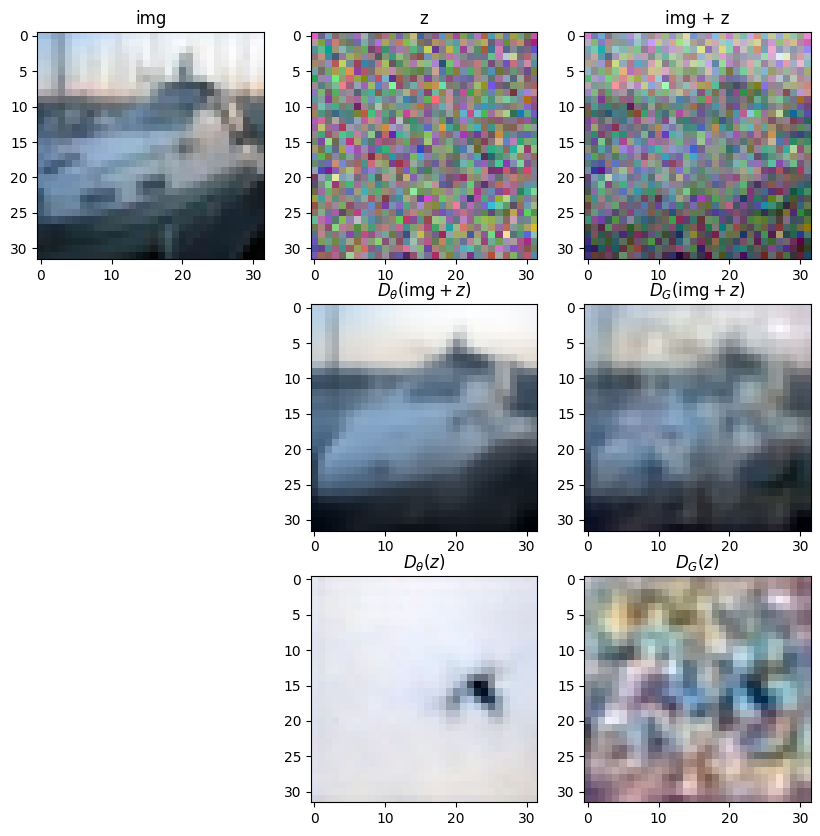

idx: 3


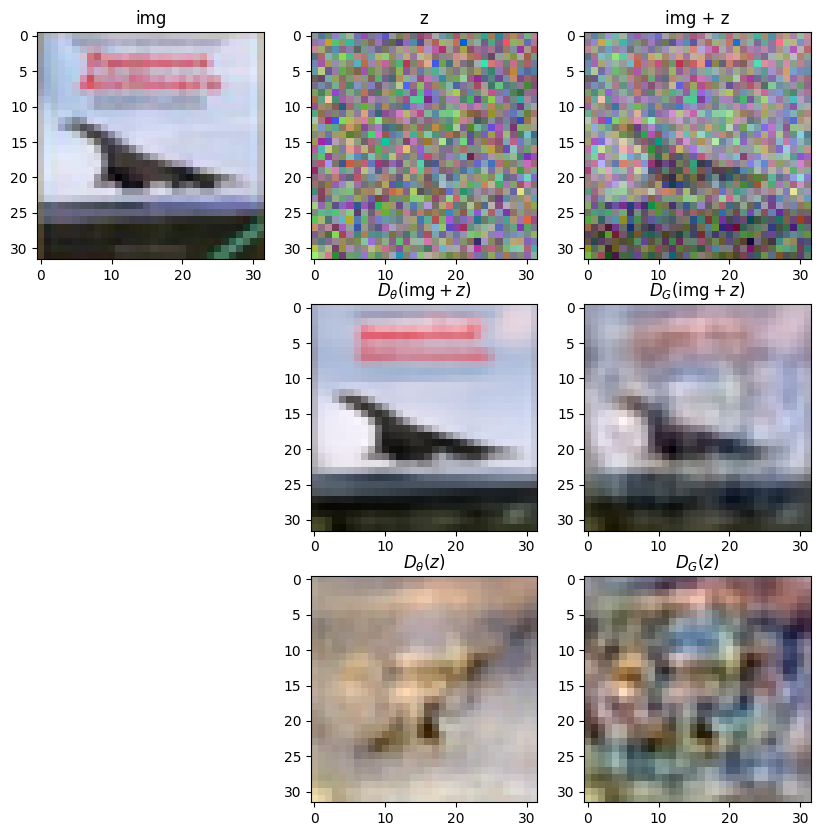

idx: 4


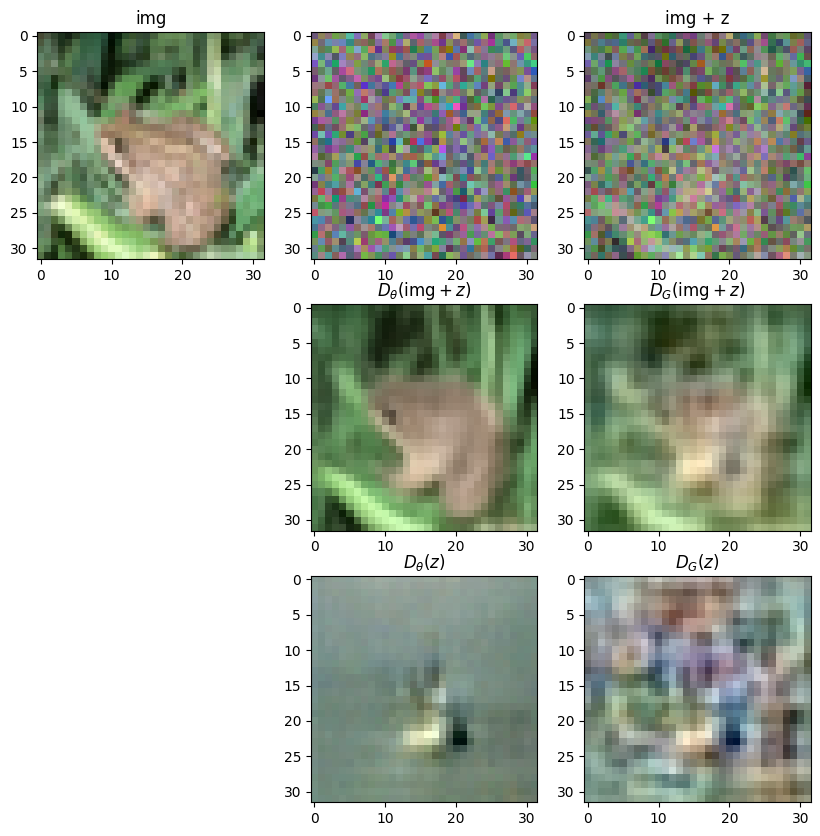

idx: 5


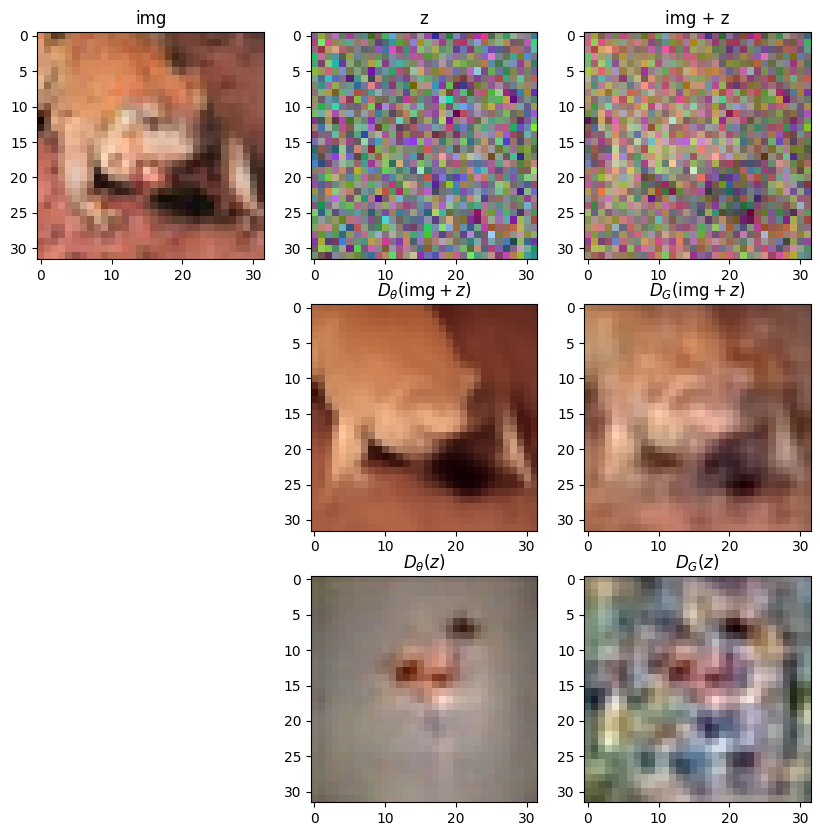

idx: 6


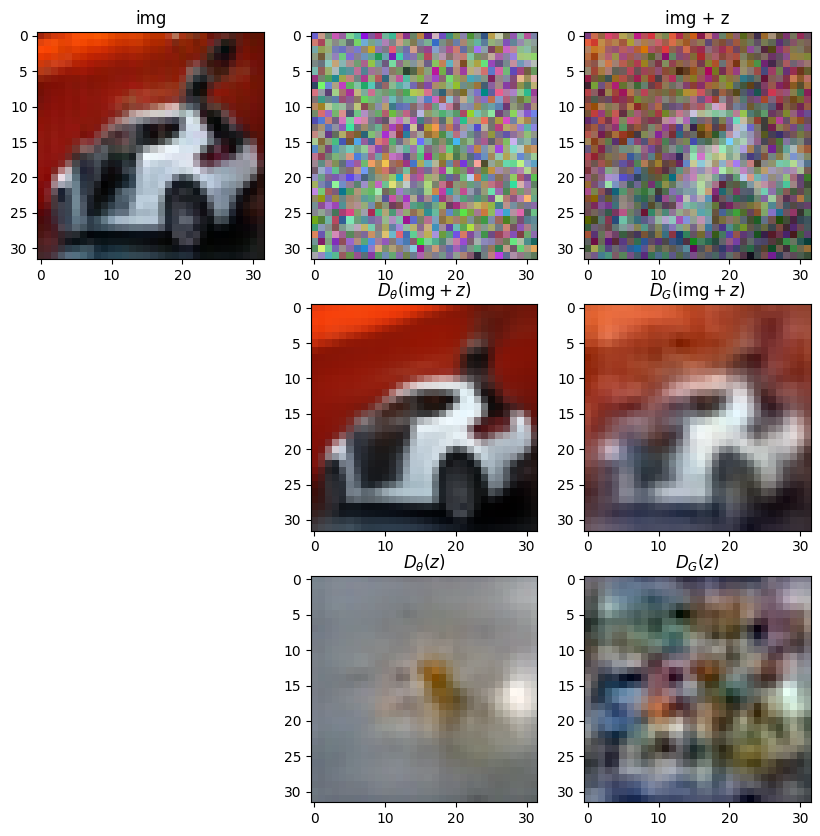

idx: 7


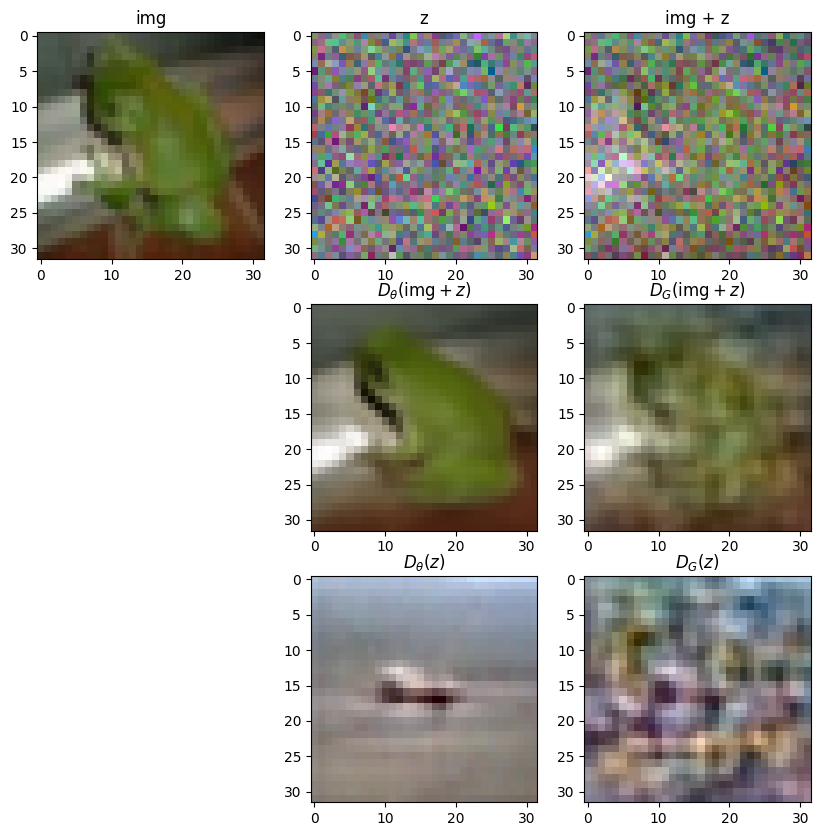

idx: 8


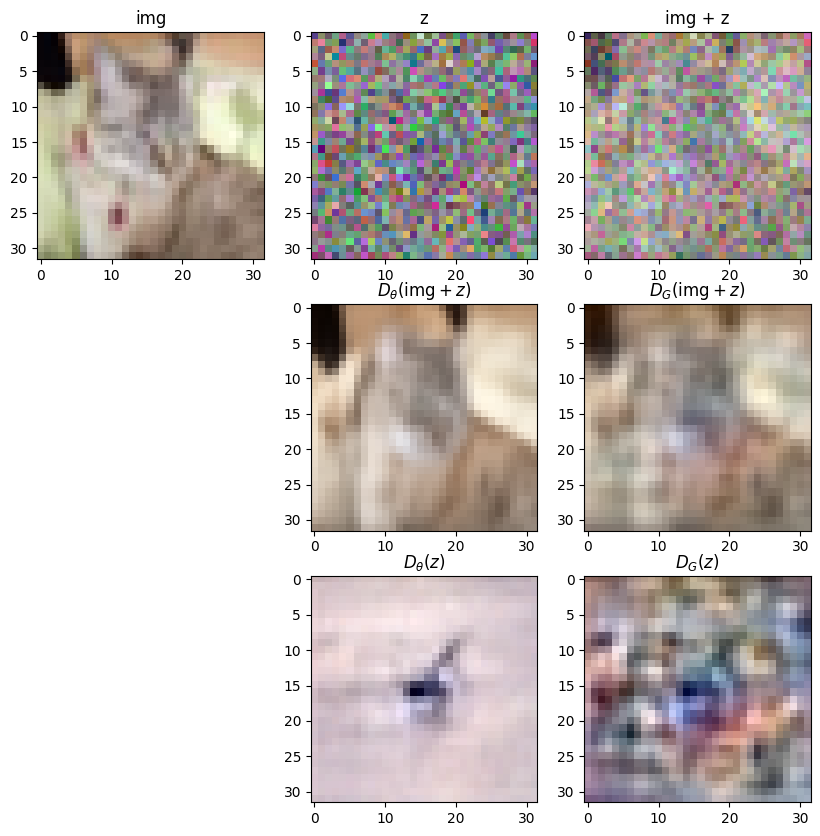

idx: 9


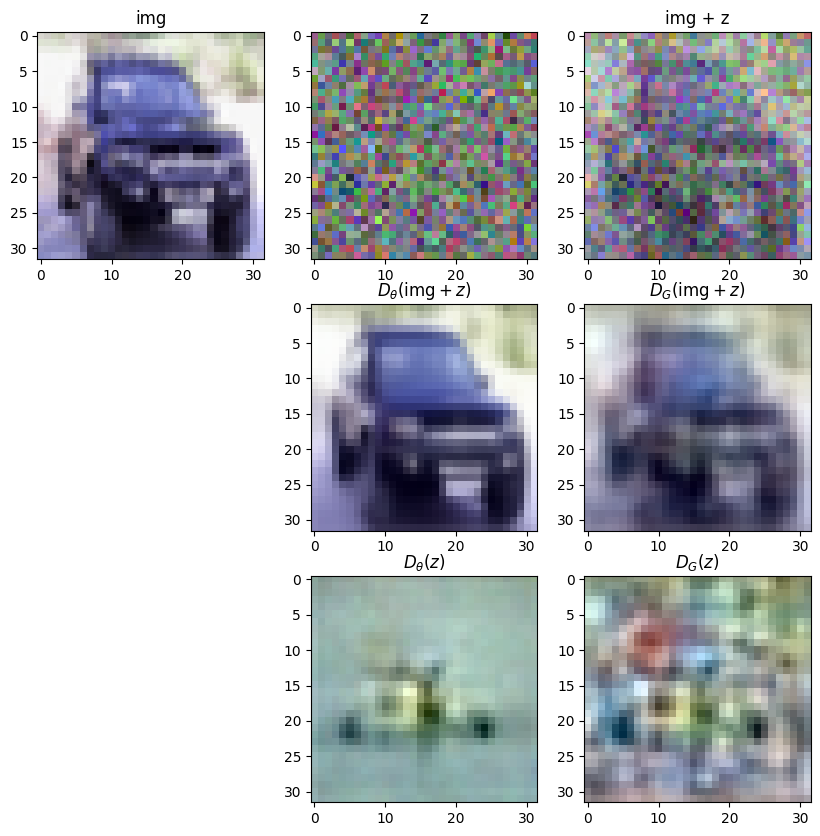

In [57]:
num_img = 10
sigma = 0.46997905799774714
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 0.02

idx: 0


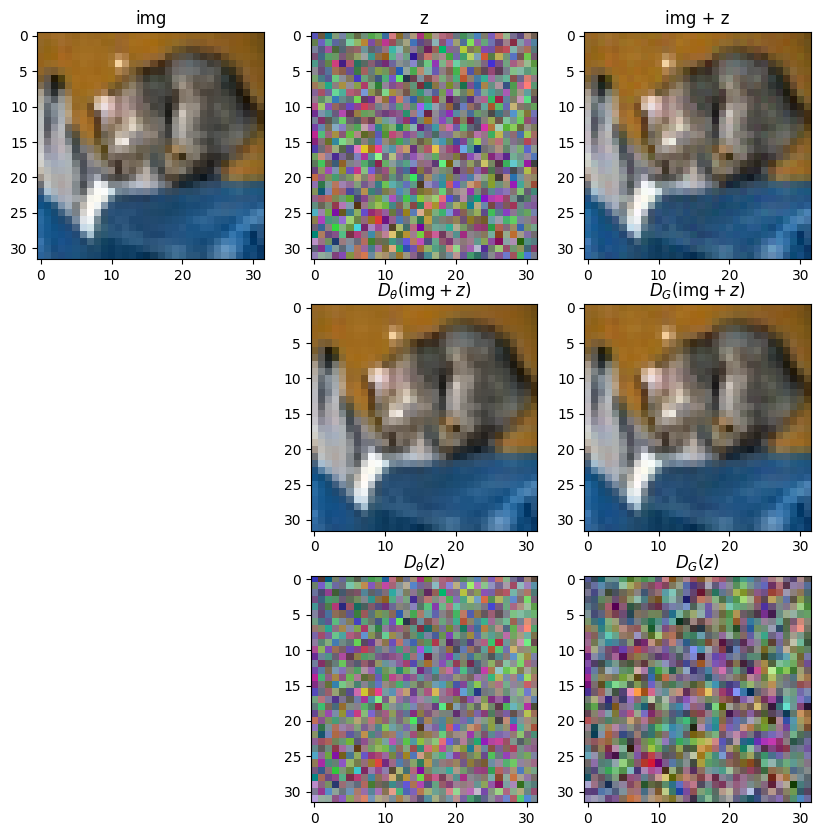

idx: 1


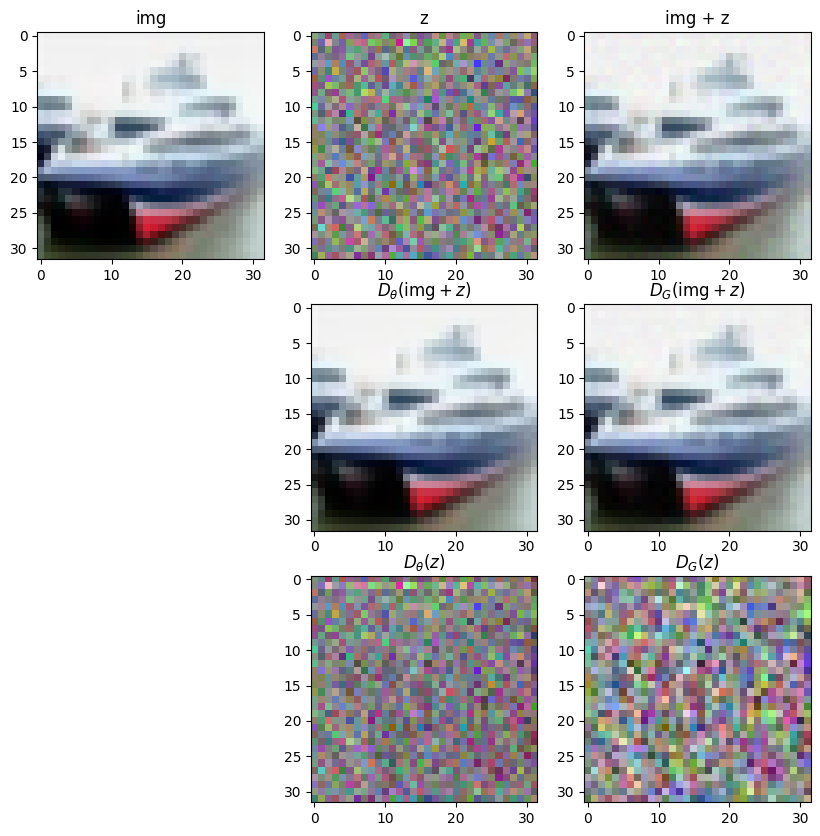

idx: 2


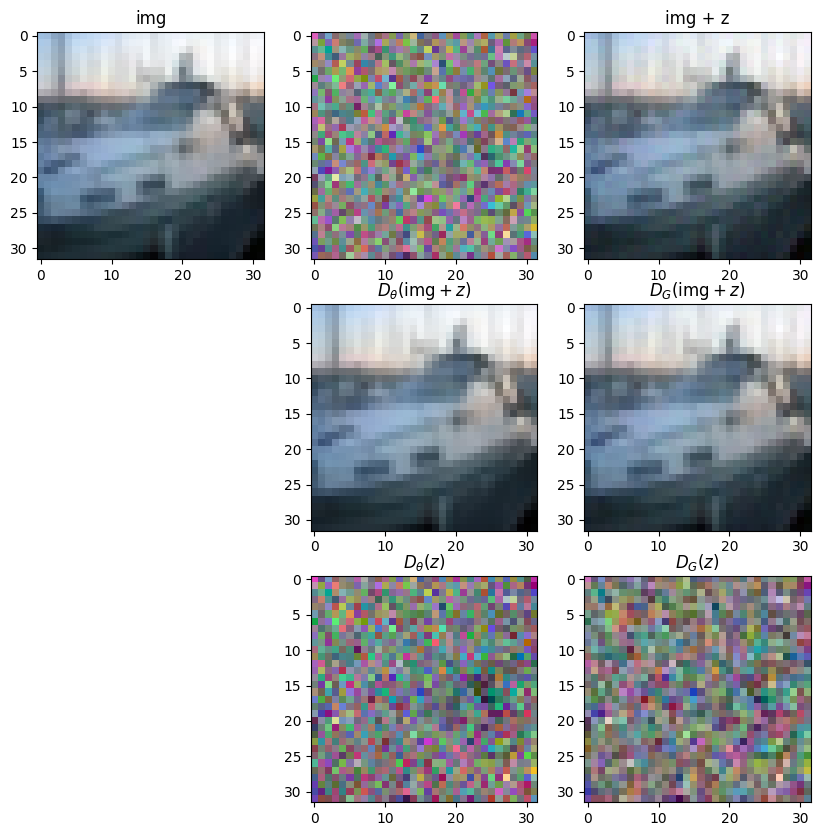

idx: 3


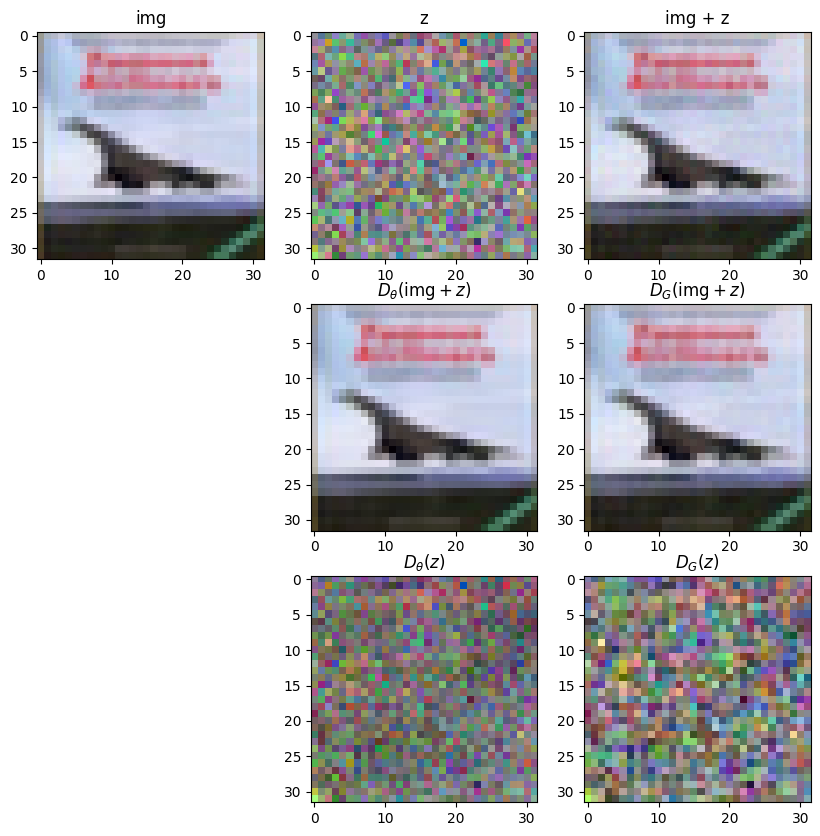

idx: 4


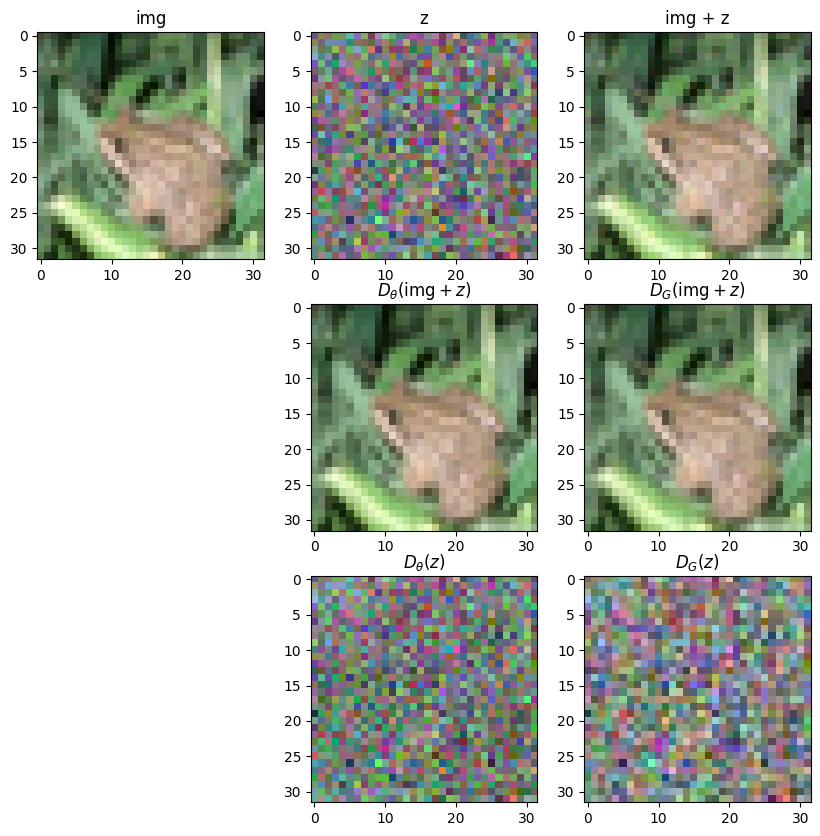

idx: 5


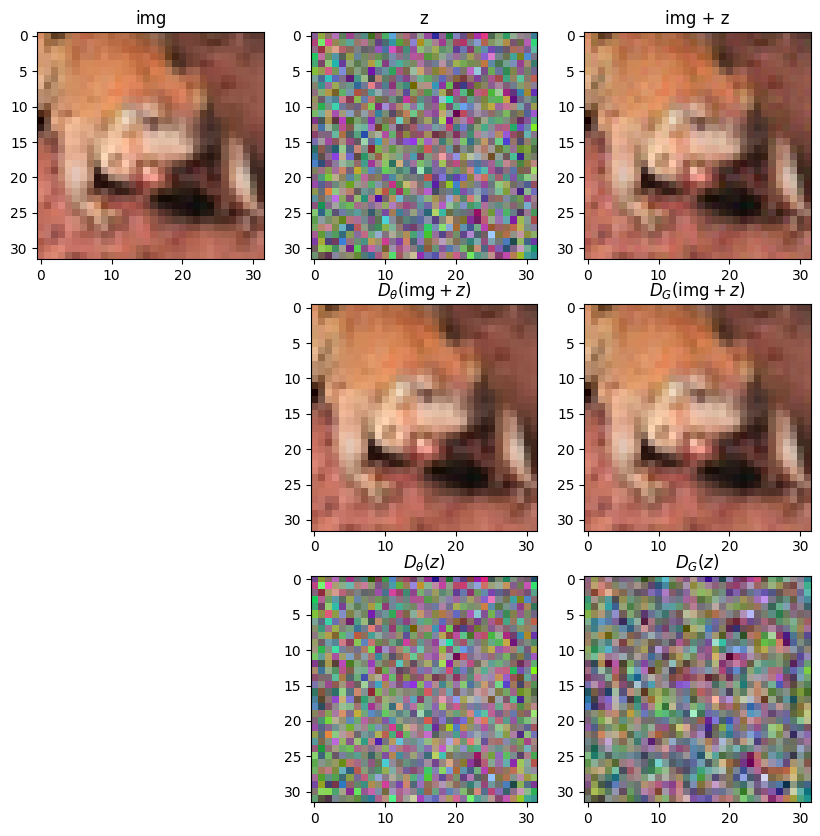

idx: 6


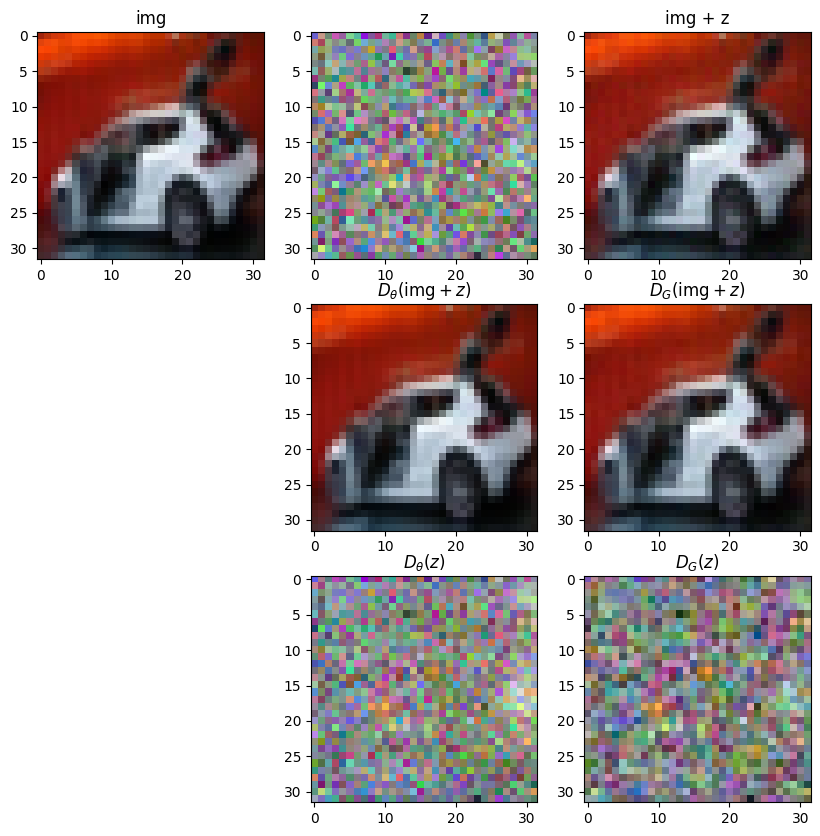

idx: 7


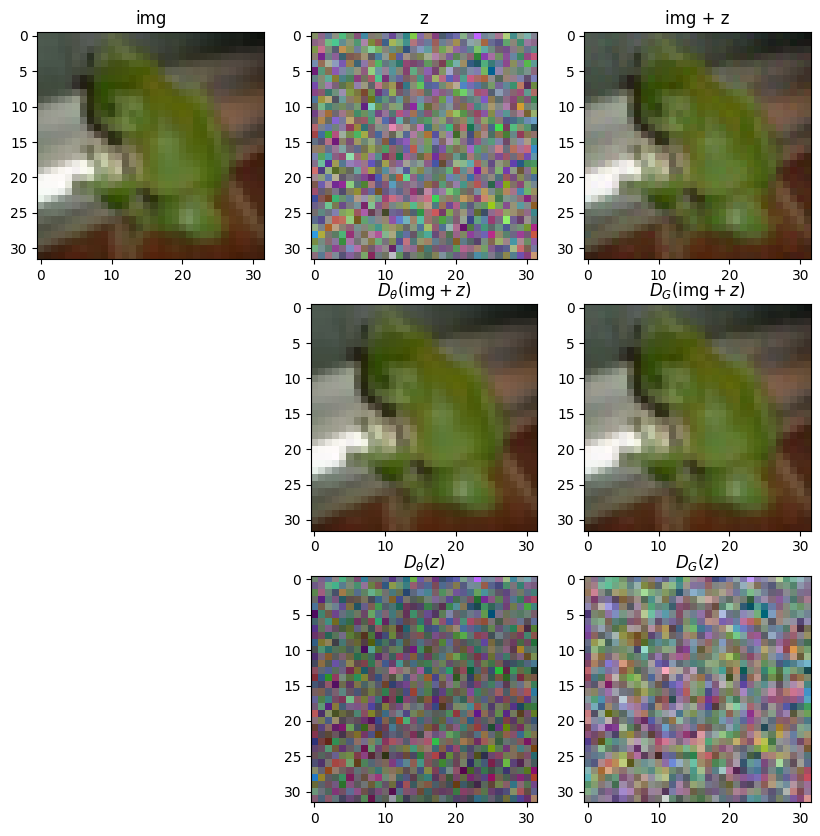

idx: 8


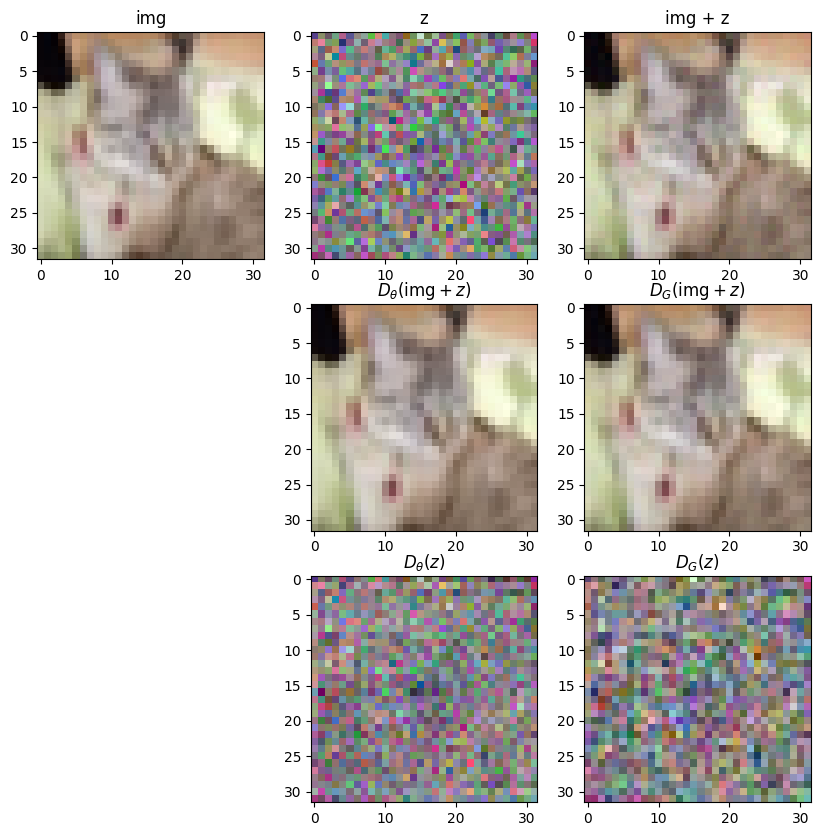

idx: 9


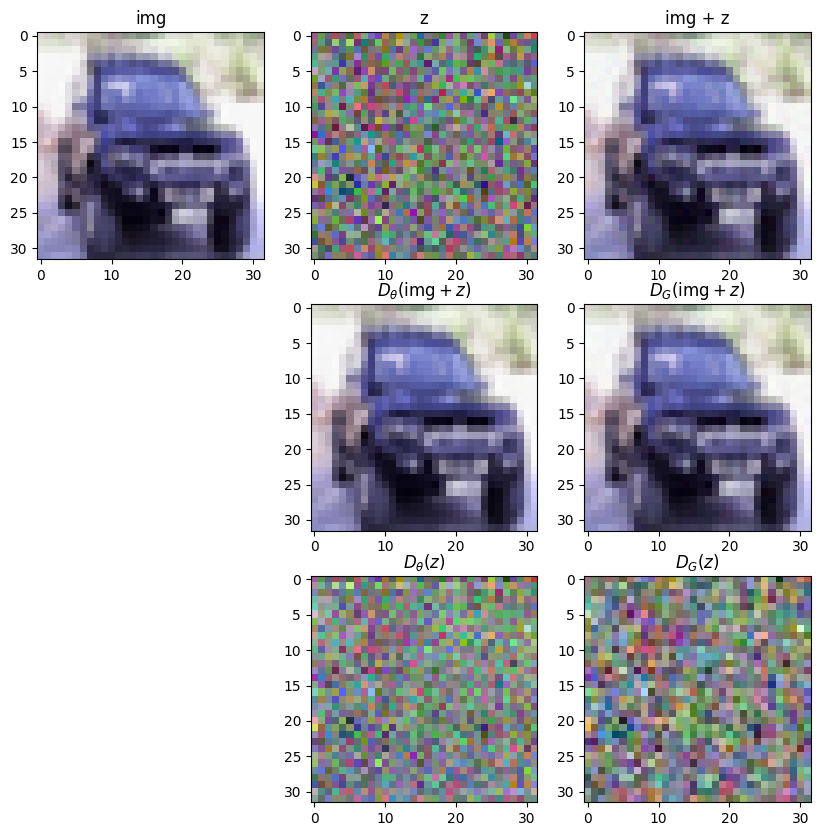

In [58]:
num_img = 10
sigma = 0.020435334553438746
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()

### Sigma = 0.002000000000000003

idx: 0


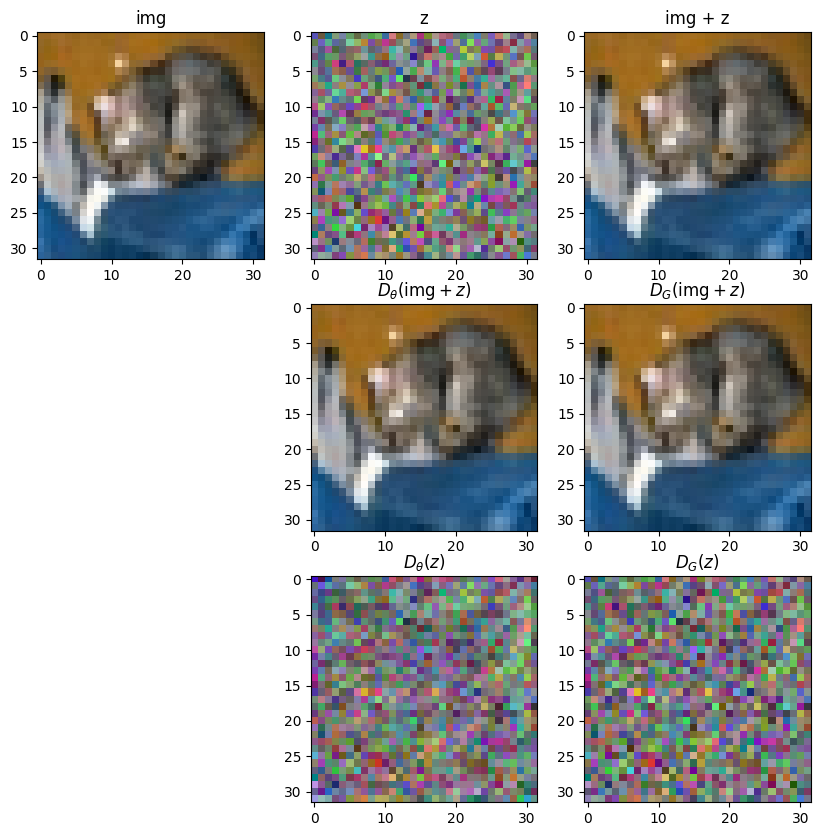

idx: 1


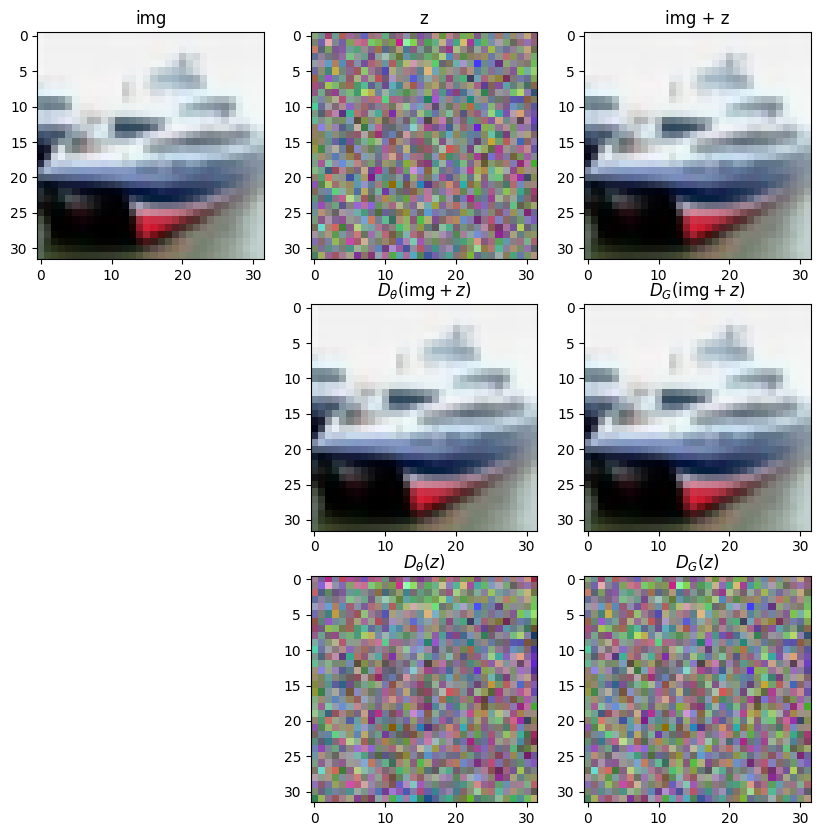

idx: 2


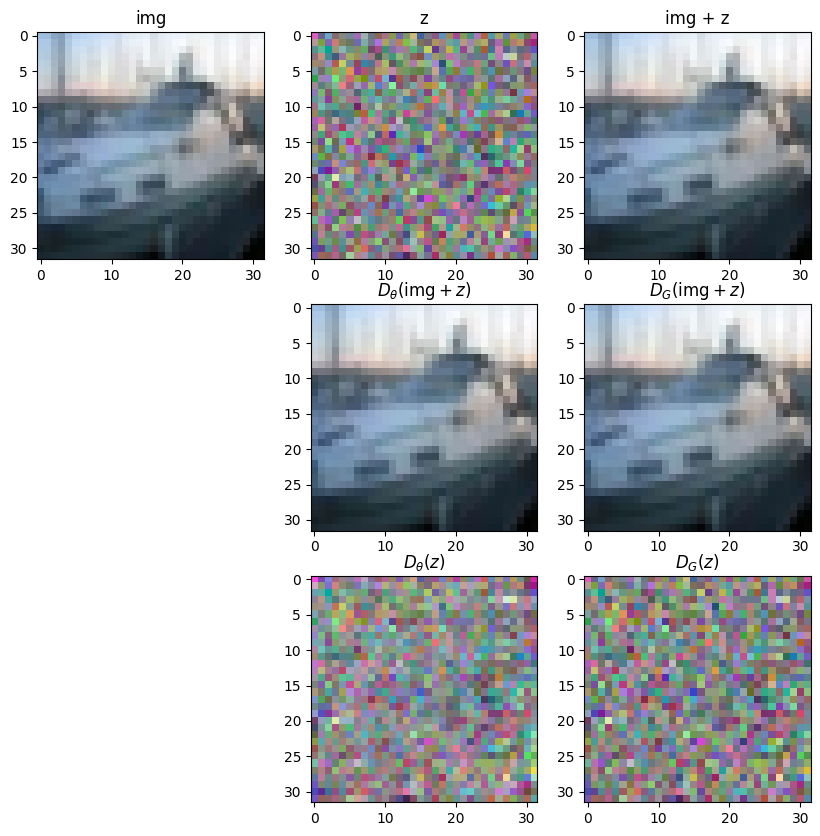

idx: 3


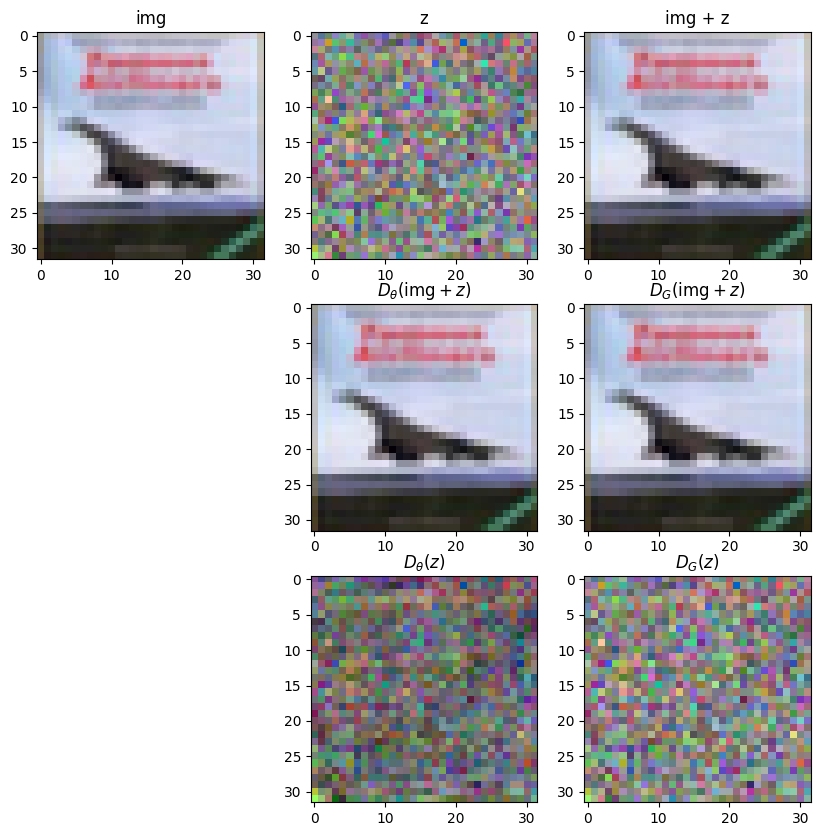

idx: 4


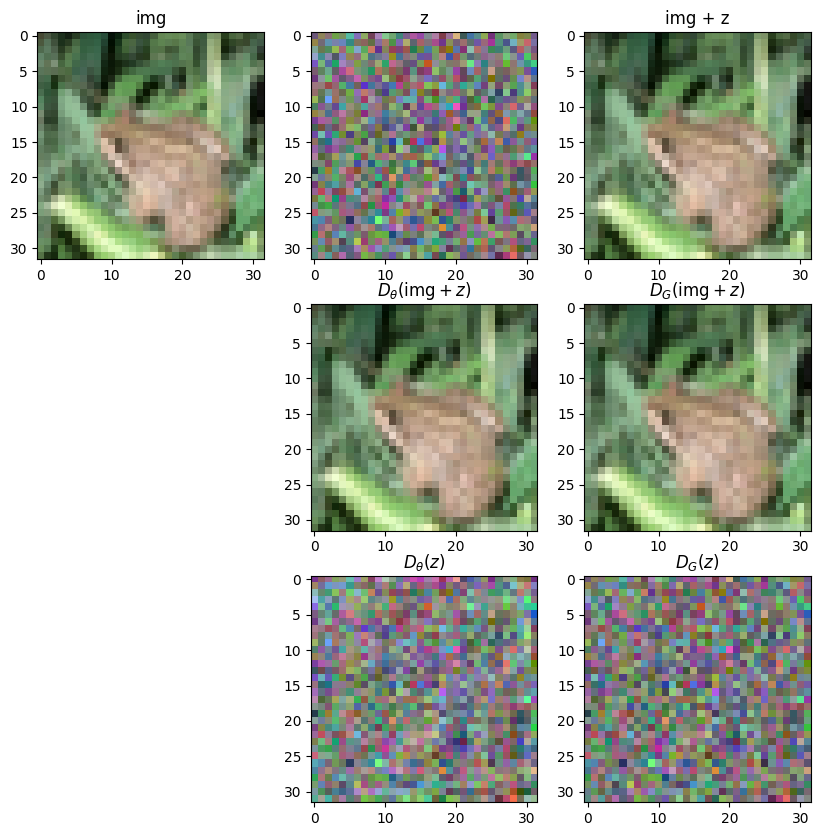

idx: 5


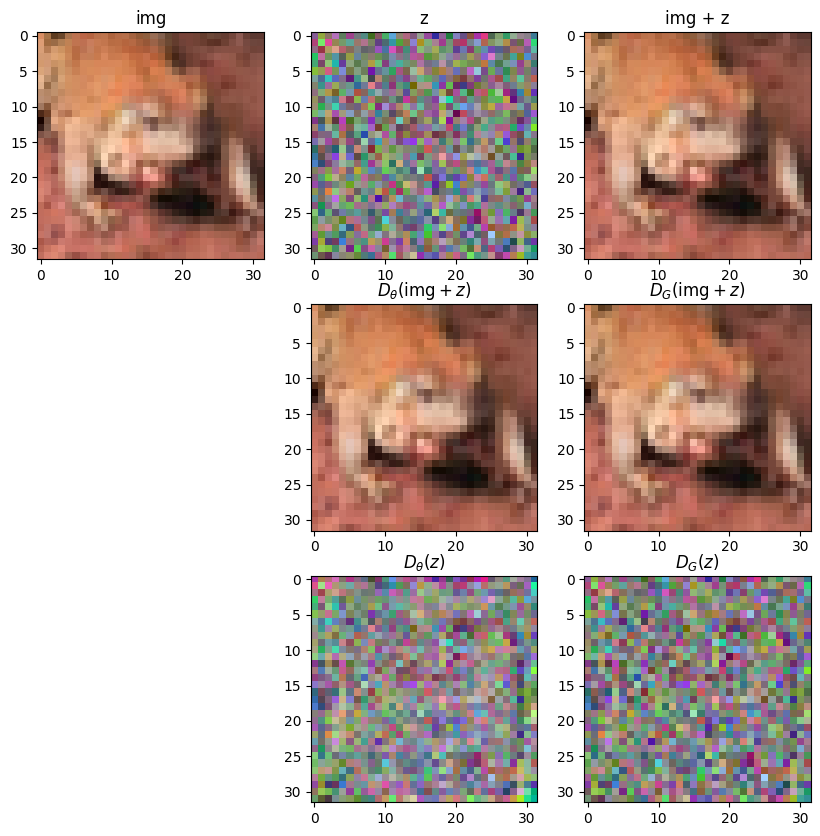

idx: 6


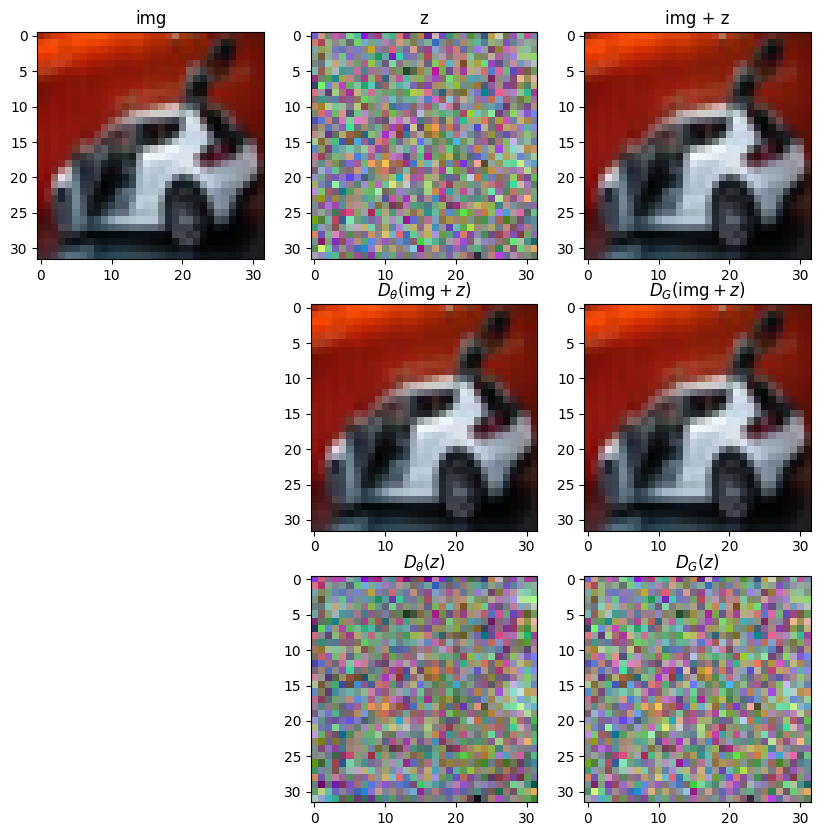

idx: 7


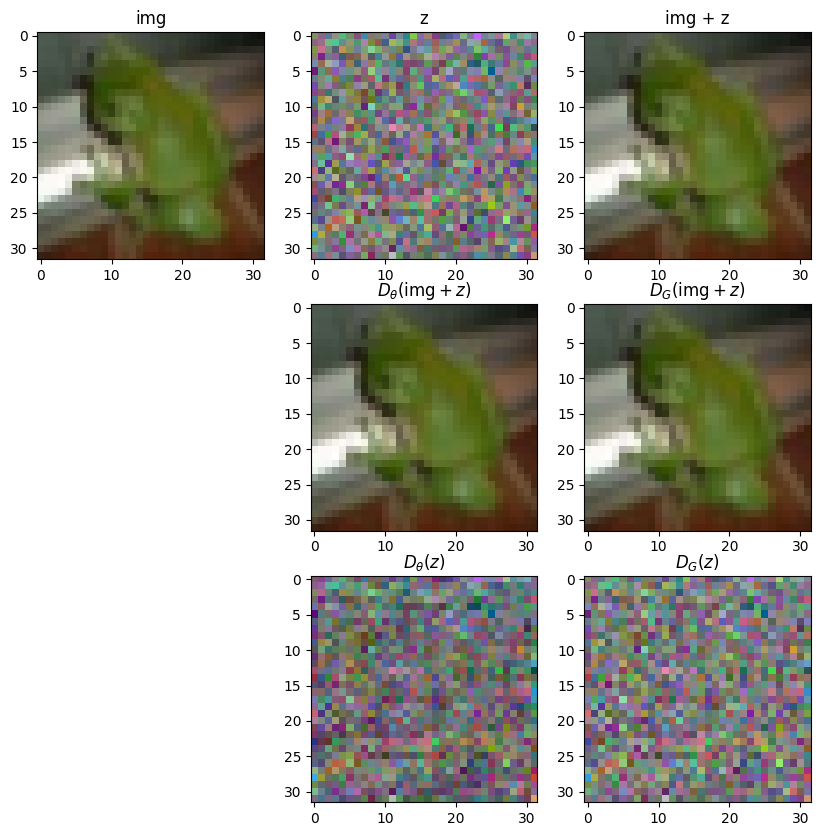

idx: 8


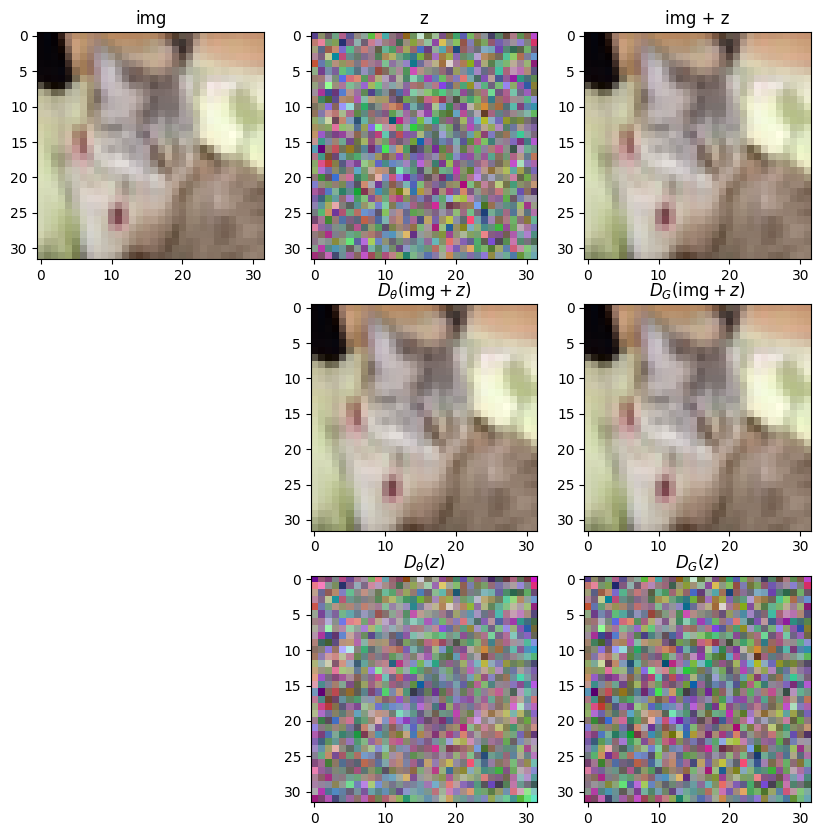

idx: 9


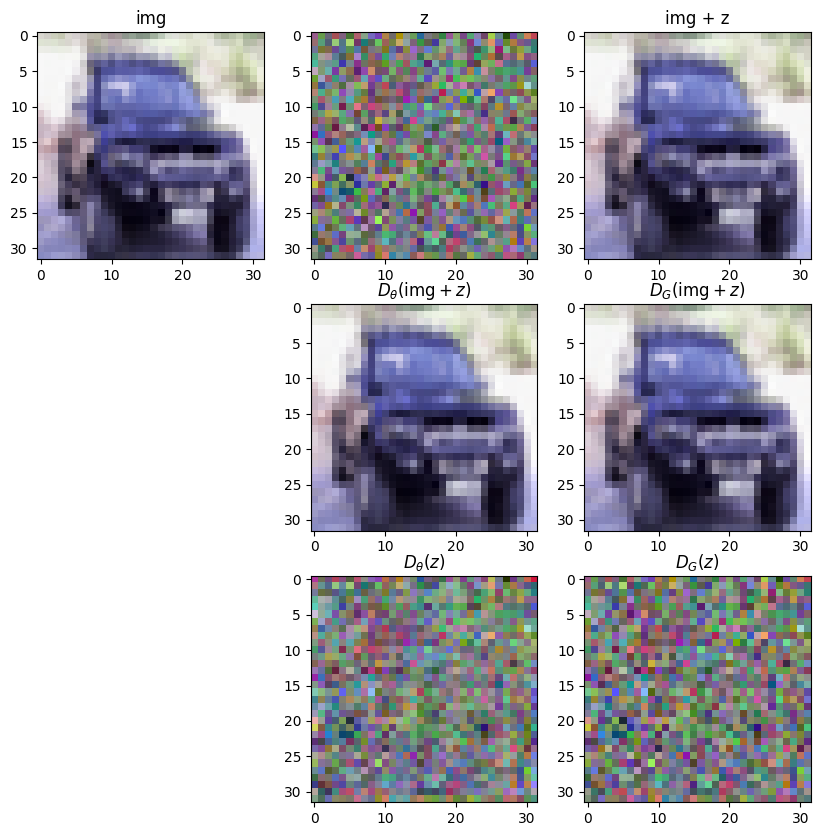

In [59]:
num_img = 10
sigma = 0.002000000000000003
torch.manual_seed(0)
rank = 1*3*32*32

for i in range(num_img):
    noise = torch.randn((1,3,32,32), device=device)
    img_index = i
    img_celeb = torch.tensor(dataset_cifar_test[img_index][0],device=device).unsqueeze(0)
    img_celeb = img_celeb/127.5 - 1
       
    # Construct noisy image    
    noisy_img = img_celeb + sigma*noise
    # D(z)
    denoised_img_noise_edm = get_denoised_img(sigma*noise, net_final_cifar, sigma, device=device)
    # D(x+z)
    denoised_img_combine_edm = get_denoised_img(noisy_img, net_final_cifar, sigma, device=device)
    
    denoised_img_noise_Gaussian = Gaussian_model_cifar((sigma*noise).reshape(1,1,-1), sigma).reshape(1,3,32,32)
    
    denoised_img_combine_Gaussian = Gaussian_model_cifar((noisy_img).reshape(1,1,-1), sigma).reshape(1,3,32,32)

    
    print('idx:', img_index)
    
    plt.figure(figsize=(10,10))
    plt.subplot(3,3,1)
    plt.title('img')
    plt.imshow(normalize_img(img_celeb[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,2)
    plt.title('z')
    plt.imshow(normalize_img(sigma*noise[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    plt.subplot(3,3,3)
    plt.title('img + z')
    plt.imshow(normalize_img(noisy_img[0].reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,5)
    plt.title(r'$D_{\theta}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,6)
    plt.title(r'$D_{G}(\text{img} + z)$')
    plt.imshow(normalize_img(denoised_img_combine_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    
    plt.subplot(3,3,8)
    plt.title(r'$D_{\theta}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_edm.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.subplot(3,3,9)
    plt.title(r'$D_{G}(z)$')
    plt.imshow(normalize_img(denoised_img_noise_Gaussian.reshape(3,32,32).permute(1,2,0).detach().cpu()))
    
    plt.show()